# Plotting strait transports and strait topography in ACCESS-OM3 and ACCESS-OM2

Based on https://github.com/COSIMA/ACCESS-OM2-1-025-010deg-report/blob/master/figures/strait_transports/strait_transports.ipynb

Related issues
- https://github.com/ACCESS-Community-Hub/access-om3-paper-1/issues/16
- https://github.com/ACCESS-Community-Hub/access-om3-paper-1/issues/41
- https://github.com/ACCESS-Community-Hub/access-om3-paper-1/issues/1

In [1]:
# Parameters – this is the ONLY place you should edit
# when switching models / experiments / obs datasets.

### USER EDIT start

# ESM datastore (model output) – change this for a different run/model
# esm_file = "/g/data/zv30/non-cmip/ACCESS-CM3/cm3-run-11-08-2025-25km-beta-om3-new-um-params/cm3-demo-datastore/cm3-demo-datastore.json" #CM3 datastore
esm_file = "/g/data/zv30/non-cmip/ACCESS-CM3/cm3-run-20-01-2026-om3-update/cm3-datastore/cm3-datastore.json"

# Frequency depends on the datastore you’re using:
data_frequency = "1mon"

# Optional special-case switches (e.g. 25 km quirks)
APPLY_OBS_25KM_Y_SLICE = False

# Plot settings
dpi = 300

### USER EDIT stop

import os
import sys
from matplotlib import rcParams

# Change working directory to the notebooks folder in the repo
project_root = f"/g/data/tm70/{os.environ['USER']}/access-om3-paper-1"
notebooks_dir = os.path.join(project_root, "notebooks")

# This makes CWD match where SST.ipynb and exptdata_access.py live
os.chdir(notebooks_dir)
print("Changed working directory to:", os.getcwd())

from exptdata_access import get_experiment_info, guess_experiment_from_esm_file
from model_agnostic import get_lon_lat_from_catalog, select_variable, ensure_2d_transport

%matplotlib inline
rcParams["figure.dpi"] = dpi

plotfolder = f"/g/data/{os.environ['PROJECT']}/{os.environ['USER']}/access-om3-paper-figs/"
os.makedirs(plotfolder, exist_ok=True)

# Infer model information from the datastore path
expt_key, info = guess_experiment_from_esm_file(esm_file)

model_name = info["model"]             # OM3 or CM3
exptname = os.path.basename(os.path.dirname(esm_file))
print(f"Running notebook for model: {model_name}")
print("ESM datastore path:", esm_file)
print("Plot folder path:", plotfolder)
print("Experiment name:", exptname)

Changed working directory to: /g/data/tm70/ek4684/access-om3-paper-1/notebooks
Running notebook for model: ACCESS-CM3
ESM datastore path: /g/data/zv30/non-cmip/ACCESS-CM3/cm3-run-20-01-2026-om3-update/cm3-datastore/cm3-datastore.json
Plot folder path: /g/data/tm70/ek4684/access-om3-paper-figs/
Experiment name: cm3-datastore


In [2]:
info

{'model': 'ACCESS-CM3',
 'desc': 'ACCESS-CM3 (unregistered experiment)',
 'esm_file': '/g/data/zv30/non-cmip/ACCESS-CM3/cm3-run-20-01-2026-om3-update/cm3-datastore/cm3-datastore.json'}

In [3]:
import intake
from dask.distributed import Client
import matplotlib.pyplot as plt
import cmocean as cm
import cftime
import numpy as np
import xarray as xr
import glob

In [4]:
client = Client(threads_per_worker=1)
print(client.dashboard_link)
client

/proxy/8787/status


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 14
Total threads: 14,Total memory: 63.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:44621,Workers: 0
Dashboard: /proxy/8787/status,Total threads: 0
Started: Just now,Total memory: 0 B
Comm: tcp://127.0.0.1:42763,Total threads: 1
Dashboard: /proxy/36331/status,Memory: 4.50 GiB
Nanny: tcp://127.0.0.1:40059,


In [5]:
IAF = esm_file.find('iaf') > 0
IAF

False

In [6]:
def load_cm3(pattern, varname, rename_dims=None, drop_vars=()):
    files = sorted(glob.glob(pattern))
    if not files:
        raise FileNotFoundError(f"No files matched: {pattern}")

    ds = xr.open_mfdataset(
        files,
        combine="by_coords",
        parallel=True,
        chunks={"time": 12},
        drop_variables=drop_vars,
        use_cftime=True,
        decode_timedelta=True,
    )

    da = ds[varname]

    if rename_dims:
        # only rename keys that are present as dims
        present = {k: v for k, v in rename_dims.items() if k in da.dims}
        da = da.rename(present)

    return da

In [7]:
def cat_var(cat, varname, frequency):
    v = cat.search(variable=varname, frequency=frequency)
    v.esmcat.aggregation_control.groupby_attrs = ["frequency"]  # avoids intake grouping surprises
    ds = v.to_dask(
        xarray_open_kwargs=dict(
            chunks={"time": -1},
            decode_timedelta=True,
            use_cftime=True,
        )
    )
    # return a DataArray if it exists, otherwise dataset (rare)
    return ds[varname] if varname in ds.data_vars else ds

## Define strait names, locations and obs

In [8]:
# Strait locations for ACCESS-OM3: [minlon, maxlon, minlat, maxlat]
# Add as many as you like, but they must be zonal or meridional
om3straits = {
    '25km': {
            'Drake Passage':       [-69.9,   -69.9,  -71.6, -51.0],
            'Makassar Strait':     [115-360, 119.5-360,  -2.87, -2.87],  # INSTANT, Gordon et al. 2008 http://dx.doi.org/10.1029/2008GL036372
            'Lifamatola Passage':  [124.5-360, 127.9-360,  -1.6, -1.6],  # NB: significantly shifted from obs to span resolved land INSTANT, van Aken et al. (2009) http://dx.doi.org/10.1016/j.dsr.2009.02.001
            'Lombok Strait':       [-244.8, -243.5,  -8.5, -8.5],
            'Ombai Strait':        [-235.0, -235.0,  -9.21, -8.3],
            'Timor Strait':        [123-360, 123-360, -11.7, -10.7],
            'Leti Strait':         [127-360, 130-360, -8.4, -8.4],
            'Karimata Strait':     [112-360, 112-360, -7.25, -3],
            'ITF South':           [114-360, 138-360, -8.2, -8.2],
            'ITF North':           [115-360, 133-360,  -2.87, -2.87],
            'Bering Strait':       [-172,     -167,   65.8,  65.8],
            'Denmark Strait':      [-42,       -22,   65.8,  65.8],
            'East Taiwan Channel': [-238.3,   -236,   24.4,  24.4],  # WOCE PCM-1 array between Taiwan and Iriomote, JohnsLeeZhangZantoppLiuYang2001a http://dx.doi.org/10.1175/1520-0485(2001)031<1031:TKEOTM>2.0.CO;2
            'Florida Current':     [-81,     -78.8,   26.7,  26.7],  # MeinenBaringerGarcia2010a http://dx.doi.org/10.1016/j.dsr.2010.04.001
            'Bosphorus':           [28.5, 29.2, 41.15, 41.15],
            'Gibraltar':           [-5.5, -5.5, 35.5, 36.5, ],
            'Labrador-Greenland, 60°N': [-64.5, -44, 60, 60],  # Sort-of OSNAP-West
            'Greenland-Norway, 60°N': [-44, 8, 60, 60],  # Sort-of OSNAP-East
            },
}
for model, straits in om3straits.items(): 
    for strait, (minlon, maxlon, minlat, maxlat) in straits.items():
        if (minlon != maxlon) and (minlat != maxlat):
            raise ValueError(f'Error in {model} {strait}: Must have either minlon == maxlon or minlat == maxlat')

In [9]:
# Strait locations for ACCESS-OM2: [minlon, maxlon, minlat, maxlat]
# Add as many as you like, but they must be zonal or meridional
om2straits = {
    '1deg': {
            'Drake Passage': [-69.9, -69.9, -71.6, -51.0],
            'Lombok Strait': [-245, -242, -8.33, -8.33],
            'Ombai Strait':  [-237, -237, -10.33, -8.33],
            'Timor Strait':  [-233, -233, -13.9, -9],
            'North Atlantic, 60°N': [-64, 8, 60, 60],  # Sort-of OSNAP
            'Labrador-Greenland, 60°N': [-64, -44, 60, 60],  # Sort-of OSNAP-West
            'Greenland-Norway, 60°N': [-44, 8, 60, 60],  # Sort-of OSNAP-East
            'East Taiwan Channel':[121.7-360, 125-360, 24.4, 24.4],  # xmax extended by 1deg as in TsengLinChenThompsonBentsenBoningBozecCassouChassignet2016a
            'Florida Current':[-81, -77.8, 26.7, 26.7], # xmax extended  # MeinenBaringerGarcia2010a
            },
    '025deg': {
            'Drake Passage': [-69.9, -69.9, -71.6, -51.0],
            'Makassar Strait':    [115-360, 119.5-360,  -2.87, -2.87],  # INSTANT, Gordon et al 2008 http://dx.doi.org/10.1029/2008GL036372
            'Lifamatola Passage': [125-360, 127.7-360,  -1.7,  -1.7],  # NB: significantly shifted from obs to span resolved land INSTANT, van Aken et al. (2009) http://dx.doi.org/10.1016/j.dsr.2009.02.001
            'Lombok Strait': [-244.7, -243.6, -8.22, -8.22],
            'Ombai Strait':  [-235.5, -235.5, -9.21, -8.47],
            'Timor Strait':        [123-360, 123-360, -11.7, -10.8],  # to match OSNAP; was previously [-233, -233, -13.86, -8.71]
            'Leti Strait':         [127-360, 130-360, -8.4, -8.4],
            'Karimata Strait':     [112-360, 112-360, -7.25, -3],
            'ITF South':           [114-360, 138-360, -8.2, -8.2],
            'ITF North':           [115-360, 133-360,  -2.87, -2.87],
            'Bering Strait':       [-172,     -167,   65.8,  65.8],
            'Denmark Strait':      [-42,       -22,   65.8,  65.8],
            'North Atlantic, 60°N': [-64.5, 8, 60, 60],  # Sort-of OSNAP
            'Labrador-Greenland, 60°N': [-64.5, -44, 60, 60],  # Sort-of OSNAP-West
            'Greenland-Norway, 60°N': [-44, 8, 60, 60],  # Sort-of OSNAP-East
            'East Taiwan Channel':[121.7-360, 124-360, 24.4, 24.4],  # WOCE PCM-1 array between Taiwan and Iriomote (JohnsLeeZhangZantoppLiuYang2001a)
            'Florida Current':[-81, -78.8, 26.7, 26.7],  # MeinenBaringerGarcia2010a
            'Bosphorus':           [28.5, 29.5, 41.15, 41.15],
            'Gibraltar':           [-5.5, -5.5, 35.5, 36.5, ],
            },
    '01deg': {
            'Drake Passage': [-69.9, -69.9, -71.6, -51.0],
            'Lombok Strait': [-244.3, -243.8, -8.37, -8.37],
            'Ombai Strait':  [-234.9, -234.9, -8.86, -8.27],
            'Timor Strait':  [-232.6, -232.6, -13.96, -8.37],
            'Bering Strait': [-172, -167, 65.8, 65.8],
            'Denmark Strait':[-42, -22, 65.8, 65.8],
            'North Atlantic, 60°N': [-64.5, 8, 60, 60],  # Sort-of OSNAP
            'Labrador-Greenland, 60°N': [-64.5, -44, 60, 60],  # Sort-of OSNAP-West
            'Greenland-Norway, 60°N': [-44, 8, 60, 60],  # Sort-of OSNAP-East
            'East Taiwan Channel':[121.7-360, 124-360, 24.4, 24.4],  # WOCE PCM-1 array between Taiwan and Iriomote (JohnsLeeZhangZantoppLiuYang2001a)
            'Florida Current':[-81, -78.8, 26.7, 26.7],  # MeinenBaringerGarcia2010a
            },
}
for model, straits in om2straits.items(): 
    for strait, (minlon, maxlon, minlat, maxlat) in straits.items():
        if (minlon != maxlon) and (minlat != maxlat):
            raise ValueError(f'Error in {model} {strait}: Must have either minlon == maxlon or minlat == maxlat')

In [10]:
def date(y, m, d):
    return cftime.DatetimeProlepticGregorian(y, m, d)

In [11]:
obs = {  # observed transport (Sv)
# Also see table 3 in GutjahrETAL2019a http://dx.doi.org/10.5194/gmd-12-3241-2019
# table 1 in YangCessi2024a http://dx.doi.org/10.1029/2024JC021463
            'Drake Passage': { 'Donohue et al. (2016)': {'value': 173.3, 'lo': 173.3-10.7, 'hi': 173.3+10.7, 'time': [date(2007, 11, 10), date(2011, 11, 10)]}},  # day of month is a guess! DonohueTraceyWattsChidichimoChereskin2016a http://dx.doi.org/10.1002/2016GL070319
            'Makassar Strait': {'Gordon et al. (2008)': {'value': -11.6, 'lo': -11.6-3.3, 'hi':  -11.6+3.3, 'time': [date(2004, 1, 18), date(2006,  11, 27)]}},  # INSTANT, GordonSusantoFfieldHuberPranowoWirasantosa2008a http://dx.doi.org/10.1029/2008GL036372
            'Lifamatola Passage': {'van Aken et al. (2009)': {'value': 1.3-2.7, 'lo': (1.3-2.7)-(1.1+1.3), 'hi': (1.3-2.7)+(1.1+1.3), 'time': [date(2004, 1, 26), date(2006,  12, 4)]}},  # combining below and above 1250m; range is 1std assuming 100% correlation; INSTANT, VanAkenBrodjonegoroJaya2009a http://dx.doi.org/10.1016/j.dsr.2009.02.001
            'Lombok Strait': {'Sprintall et al. (2009)': {'value': -2.6, 'lo': -1.8, 'hi':  -3.2, 'time': [date(2004, 1, 10), date(2005,  6, 15)], 'depth': [0,  300]}},  # time=dates with both moorings; INSTANT, SprintallWijffelsMolcardJaya2009a http://dx.doi.org/10.1029/2008JC005257
            'Ombai Strait':  {'Sprintall et al. (2009)': {'value': -4.9, 'lo': -2.7, 'hi':  -5.0, 'time': [date(2004, 1,  4), date(2006, 12,  6)], 'depth': [0, 1200]}},  # time=dates with both moorings; INSTANT, SprintallWijffelsMolcardJaya2009a http://dx.doi.org/10.1029/2008JC005257
            'Timor Strait':  {'Sprintall et al. (2009)': {'value': -7.5, 'lo': -6.2, 'hi': -10.5, 'time': [date(2004, 1,  1), date(2006, 12, 12)], 'depth': [0, 1890]}},  # time=dates with  all moorings; INSTANT, SprintallWijffelsMolcardJaya2009a http://dx.doi.org/10.1029/2008JC005257
            'Bering Strait': {'Woodgate (2018)': {'value': 1, 'lo': 0.7, 'hi': 1.2, 'time': [date(2000, 1,  1), date(2015, 1, 1)]}},  # rough climatology for 2000s; was ~0.8Sv prior to that - Woodgate2018a http://dx.doi.org/10.1016/j.pocean.2017.12.007
            # 'Denmark Strait':  {},
            'East Taiwan Channel': {'Johns et al. (2001)': {'value': 21.5, 'lo': 21.5-2.5, 'hi': 21.5+2.5, 'time': [date(1994, 9,  1), date(1996, 5, 1)]}},  # WOCE PCM-1 array between Taiwan and Iriomote, JohnsLeeZhangZantoppLiuYang2001a http://dx.doi.org/10.1175/1520-0485(2001)031<1031:TKEOTM>2.0.CO;2
            'Florida Current': {'Meinen et al. (2010)': {'value': 32.1, 'lo': 32.1-3.3, 'hi': 32.1+3.3, 'time': [date(1982, 1,  1), date(2008, 1, 1)]}},  # range is ±1SD; rough dates from fig2 MeinenBaringerGarcia2010a http://dx.doi.org/10.1016/j.dsr.2010.04.001
            # 'Bosphorus':  {},
            # 'Gibraltar': {},
}


## Load GEBCO

In [12]:
gebco = xr.open_dataset('/g/data/ik11/inputs/GEBCO_2024/GEBCO_2024.nc', chunks='auto')['elevation']

In [13]:
def glon(lon):
    """
    Convert MOM longitude (-270 - 90) to GEBCO longitude (-180 - 180)
    """
    if lon < -180:
        return lon+360
    else:
        return lon

In [14]:
def mlon(lon):
    """
    Convert GEBCO longitude (-180 - 180) to MOM longitude (-270 - 90) 
    """
    if lon > 90:
        return lon-360
    else:
        return lon

## Load ACCESS-OM3 data from ESM datastore

In [15]:
exptname = os.path.basename(os.path.dirname(esm_file)) or os.path.basename(esm_file)

datastore = intake.open_esm_datastore(
    esm_file,
    columns_with_iterables=[
        "variable",
        "variable_long_name",
        "variable_standard_name",
        "variable_cell_methods",
        "variable_units",
    ],
)

print("ESM datastore:", esm_file)
print("Experiment label:", exptname)
print("Requested frequency:", data_frequency)

ESM datastore: /g/data/zv30/non-cmip/ACCESS-CM3/cm3-run-20-01-2026-om3-update/cm3-datastore/cm3-datastore.json
Experiment label: cm3-datastore
Requested frequency: 1mon


In [16]:
lon, lat = get_lon_lat_from_catalog(datastore)
print("Using lon var:", getattr(lon, "name", "unknown"), "shape:", lon.shape)
print("Using lat var:", getattr(lat, "name", "unknown"), "shape:", lat.shape)

/g/data/xp65/public/apps/med_conda/envs/analysis3-25.11/lib/python3.11/site-packages/intake_esm/source.py:308: ConcatenationWarning: Attempting to concatenate datasets without valid dimension coordinates: retaining only first dataset. Request valid dimension coordinate to silence this warning.
  warnings.warn(


Using lon var: geolon shape: (1152, 1440)
Using lat var: geolat shape: (1152, 1440)


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.11/lib/python3.11/site-packages/intake_esm/source.py:308: ConcatenationWarning: Attempting to concatenate datasets without valid dimension coordinates: retaining only first dataset. Request valid dimension coordinate to silence this warning.
  warnings.warn(


## Load data

In [17]:
# 2D mass transports (if available)
umo_2d = select_variable(
    datastore,
    variable_standard_name="umo_2d",
    fallback_variable_names=["umo_2d", "umo"],
    data_frequency="1mon",
)
umo_2d = ensure_2d_transport(umo_2d, name="umo_2d")

vmo_2d = select_variable(
    datastore,
    variable_standard_name="umo_2d",
    fallback_variable_names=["vmo_2d", "vmo"],
    data_frequency="1mon",
)
vmo_2d = ensure_2d_transport(vmo_2d, name="vmo_2d")

CF-based lookup failed: ValueError('No entries found for this CF standard_name.')
Selected variable via fallback name: umo_2d
CF-based lookup failed: ValueError('No entries found for this CF standard_name.')
Selected variable via fallback name: vmo_2d


In [18]:
# 3D velocities
uo = select_variable(
    datastore,
    variable_standard_name="uo",
    fallback_variable_names=["uo", "u", "uvel", "u_ocean"],
    data_frequency=data_frequency,
    chunks={"time": 1}
)

vo = select_variable(
    datastore,
    variable_standard_name="vo",
    fallback_variable_names=["vo", "v", "vvel", "v_ocean"],
    data_frequency=data_frequency,
    chunks={"time": 1}
)

CF-based lookup failed: ValueError('No entries found for this CF standard_name.')
Selected variable via fallback name: uo
CF-based lookup failed: ValueError('No entries found for this CF standard_name.')
Selected variable via fallback name: vo


In [19]:
# Ocean depth / bathymetry (2D)
deptho = select_variable(
    datastore,
    variable_standard_name="deptho",
    fallback_variable_names=["deptho", "depth"],
    data_frequency=data_frequency,   # will ignore if not present / not needed
)

CF-based lookup failed: ValueError('No entries found for this CF standard_name.')
No files matched frequency='1mon'; using any available frequency.
Selected variable via fallback name: deptho


/g/data/xp65/public/apps/med_conda/envs/analysis3-25.11/lib/python3.11/site-packages/intake_esm/source.py:308: ConcatenationWarning: Attempting to concatenate datasets without valid dimension coordinates: retaining only first dataset. Request valid dimension coordinate to silence this warning.
  warnings.warn(


In [20]:
if esm_file.find('25km-iaf-test-for-AK-expt-7df5ef4c') > 0:
    # omit latitudes with grid bug in this run https://github.com/ACCESS-NRI/ocean_model_grid_generator/issues/7
    umo_2d = umo_2d.isel(yh=slice(10, None))
    vmo_2d = vmo_2d.isel(yq=slice(10, None))
    uo = uo.isel(yh=slice(10, None))
    vo = vo.isel(yq=slice(10, None))
    deptho = deptho.isel(yh=slice(10, None))

In [21]:
if IAF:
    umo_2d = umo_2d.convert_calendar("proleptic_gregorian", use_cftime=True)
    vmo_2d = vmo_2d.convert_calendar("proleptic_gregorian", use_cftime=True)
    uo = uo.convert_calendar("proleptic_gregorian", use_cftime=True)
    vo = vo.convert_calendar("proleptic_gregorian", use_cftime=True)

In [22]:
# OM3 time range, used to restrict time range of OM2 data - BUG: not compatible with cfdatetime in IAF OM2 data
timeslice = slice(umo_2d.time.values[0], umo_2d.time.values[-1])
timeslice

slice(cftime.DatetimeProlepticGregorian(1981, 1, 16, 12, 0, 0, 0, has_year_zero=True), cftime.DatetimeProlepticGregorian(2030, 12, 16, 12, 0, 0, 0, has_year_zero=True), None)

In [23]:
vmo_2d

<xarray.DataArray 'vmo_2d' (time: 600, yq: 1153, xh: 1440)> Size: 4GB
dask.array<concatenate, shape=(600, 1153, 1440), dtype=float32, chunksize=(12, 1153, 1440), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) object 5kB 1981-01-16 12:00:00 ... 2030-12-16 12:00:00
  * yq       (yq) float64 9kB -81.62 -81.55 -81.49 -81.42 ... 89.79 89.9 90.0
  * xh       (xh) float64 12kB -279.9 -279.6 -279.4 -279.1 ... 79.38 79.62 79.88
Attributes:
    units:          kg s-1
    long_name:      Ocean Mass Y Transport Vertical Sum
    cell_methods:   yq:point xh:sum time: mean
    time_avg_info:  average_T1,average_T2,average_DT
    standard_name:  ocean_mass_y_transport_vertical_sum
    interp_method:  none

## Quantise OM3 transect locations to relevant grid

In [24]:
straits = om3straits['25km']
for strait, (xmin, xmax, ymin, ymax) in straits.items():
    if xmin == xmax:
        xmin = xmax = umo_2d.sel(xq=xmin, method='nearest').xq.values
    elif ymin == ymax:
        ymin = ymax = vmo_2d.sel(yq=ymin, method='nearest').yq.values
    straits[strait] = [xmin, xmax, ymin, ymax]

## Plot OM3 maps

Drake Passage
Makassar Strait
Lifamatola Passage
Lombok Strait
Ombai Strait
Timor Strait
Leti Strait
Karimata Strait
ITF South
ITF North
Bering Strait
Denmark Strait
East Taiwan Channel
Florida Current
Bosphorus
Gibraltar
Labrador-Greenland, 60°N
Greenland-Norway, 60°N


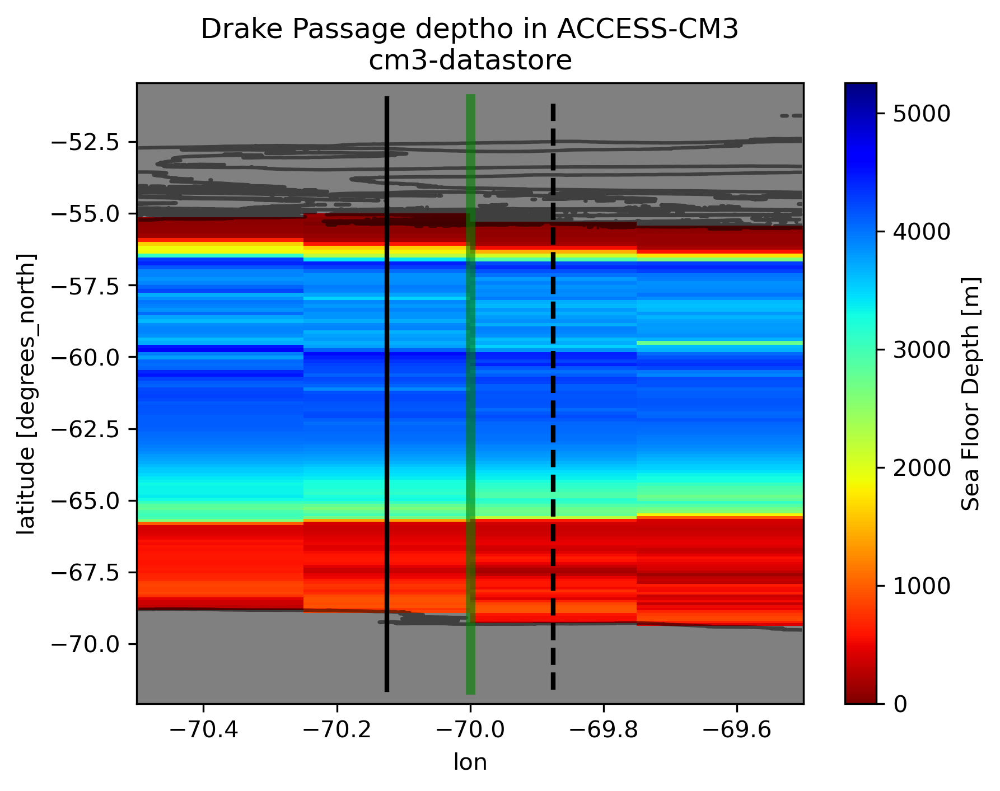

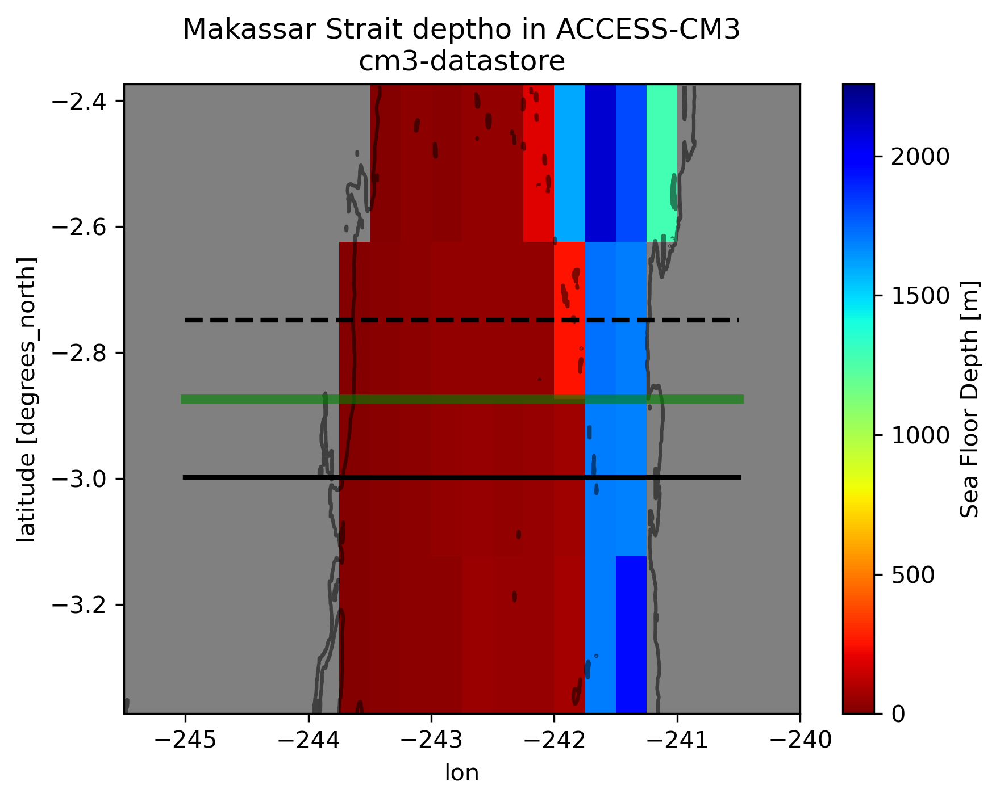

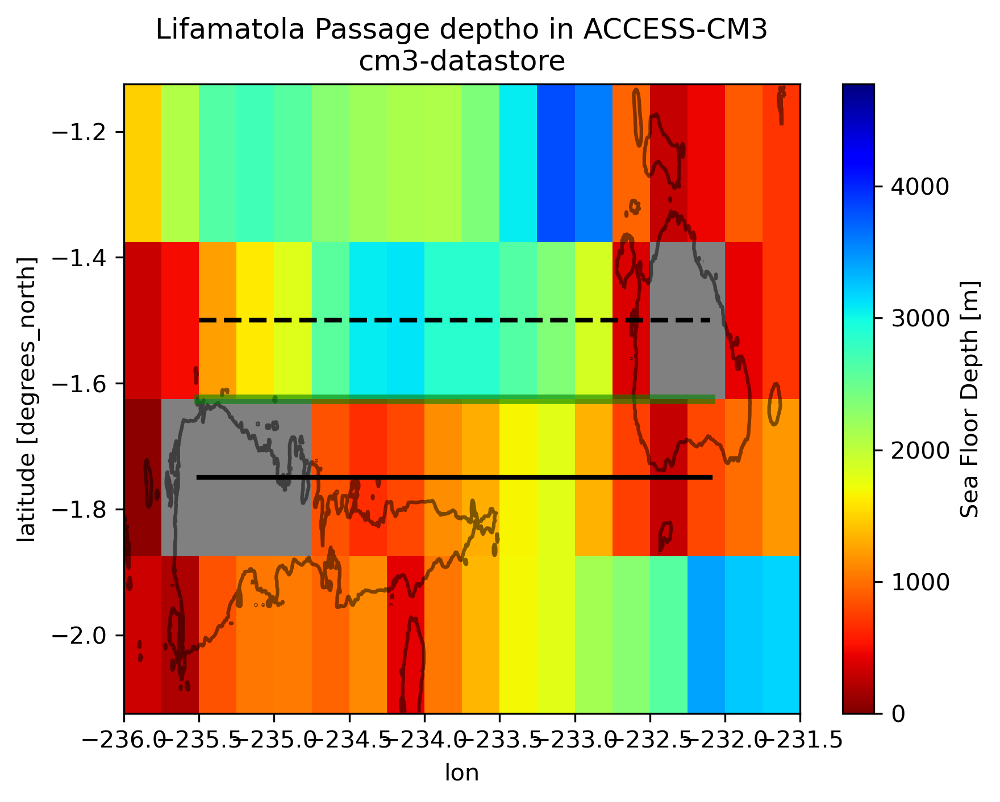

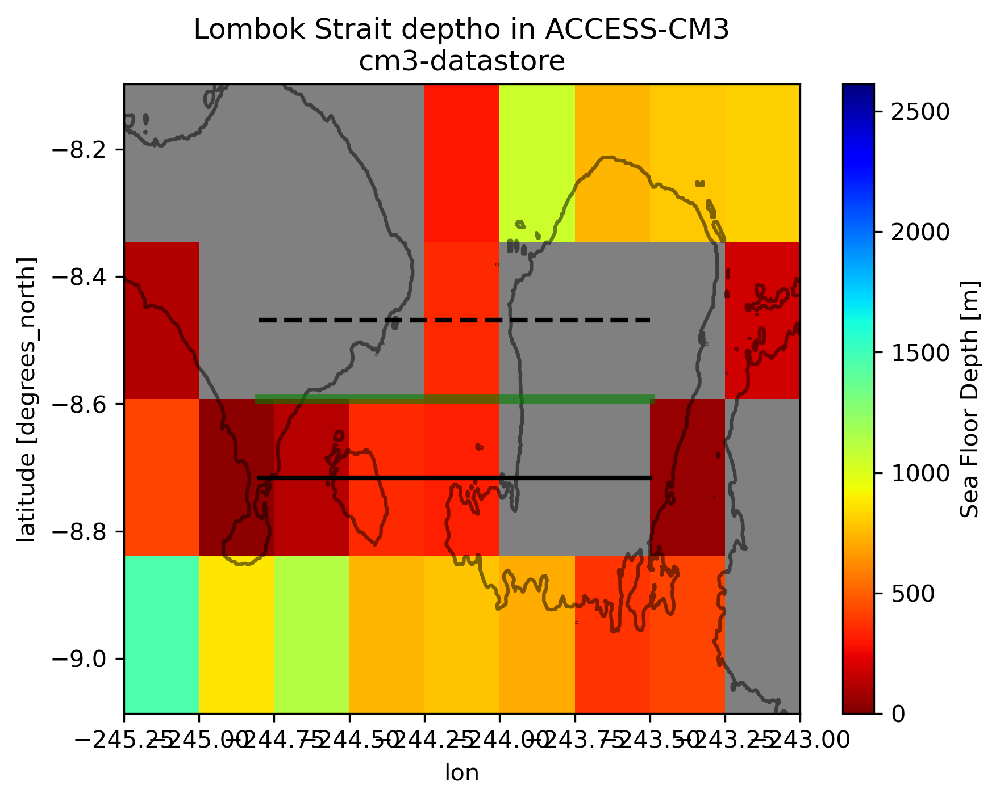

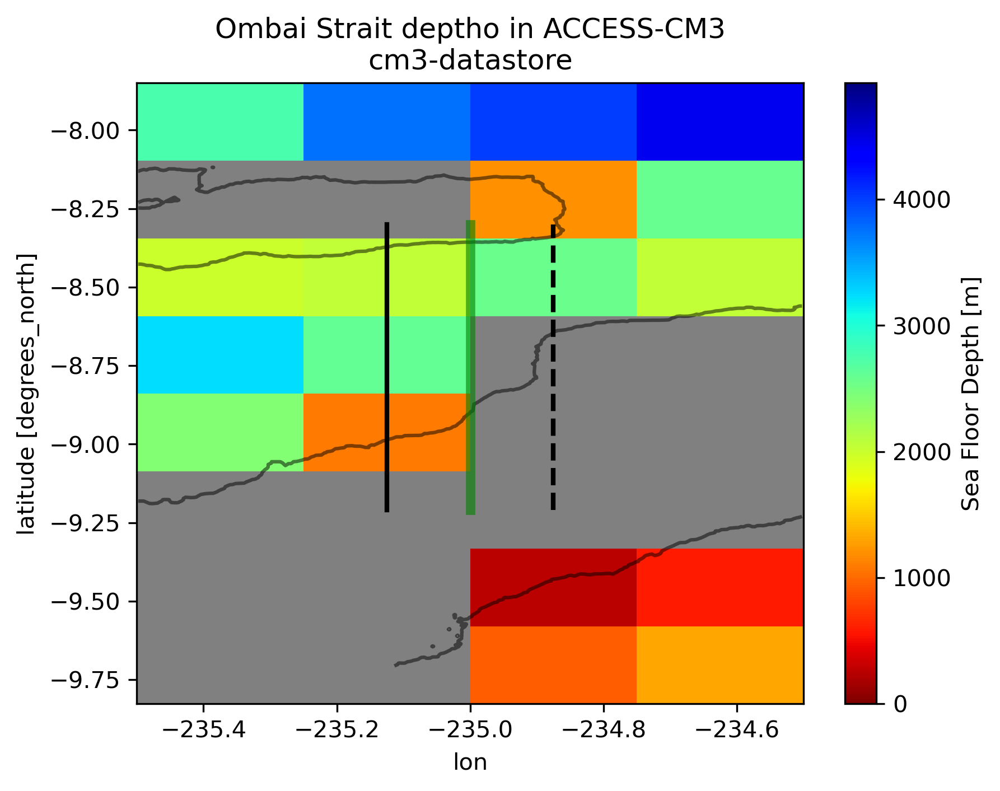

...

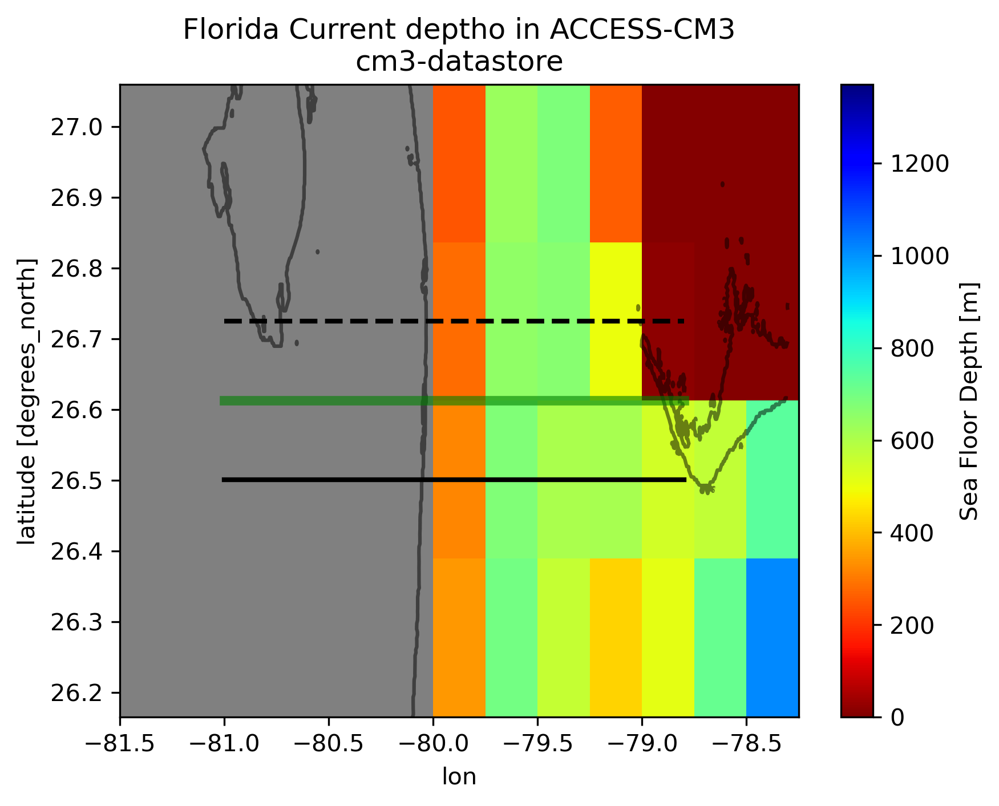

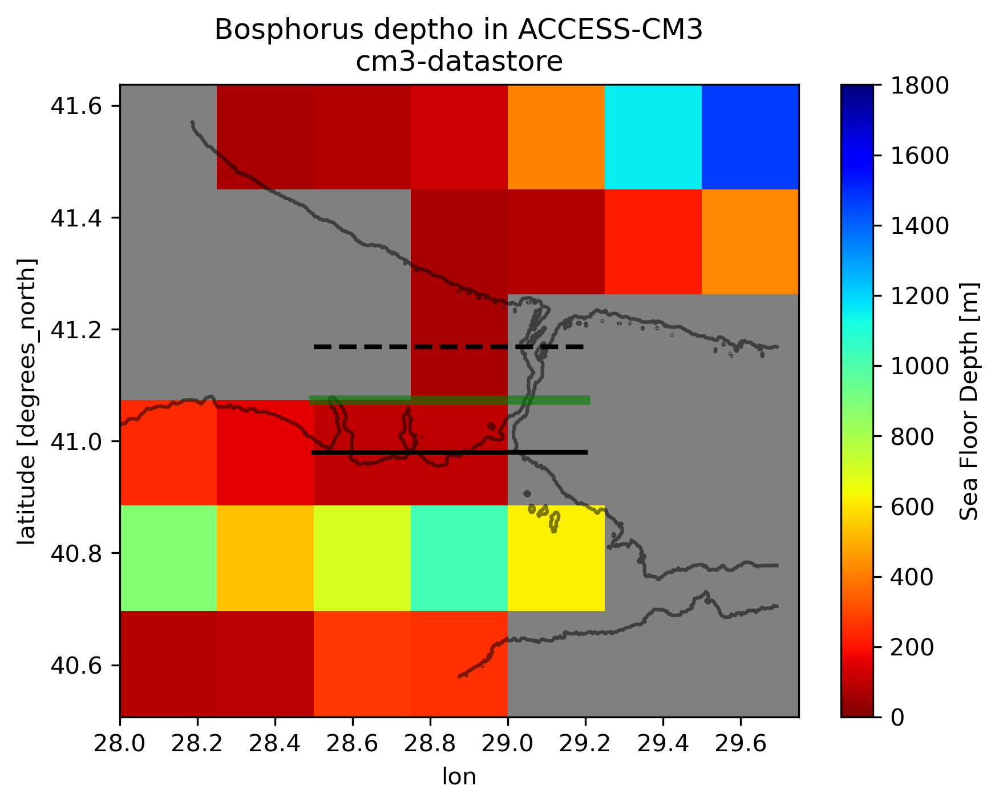

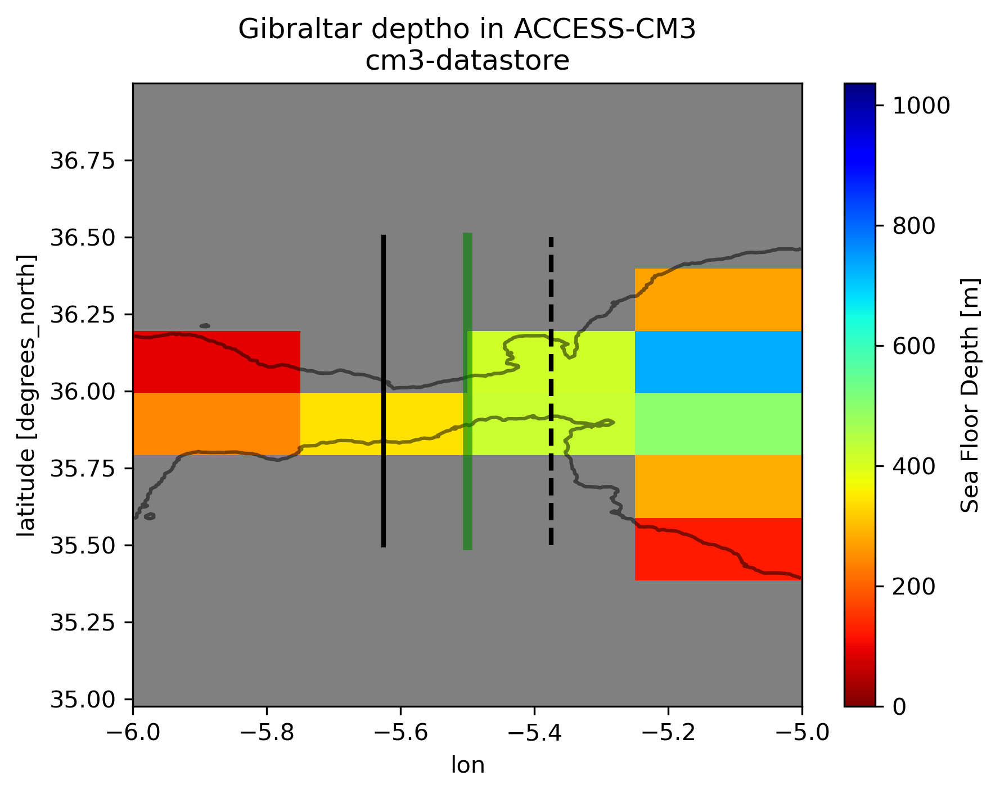

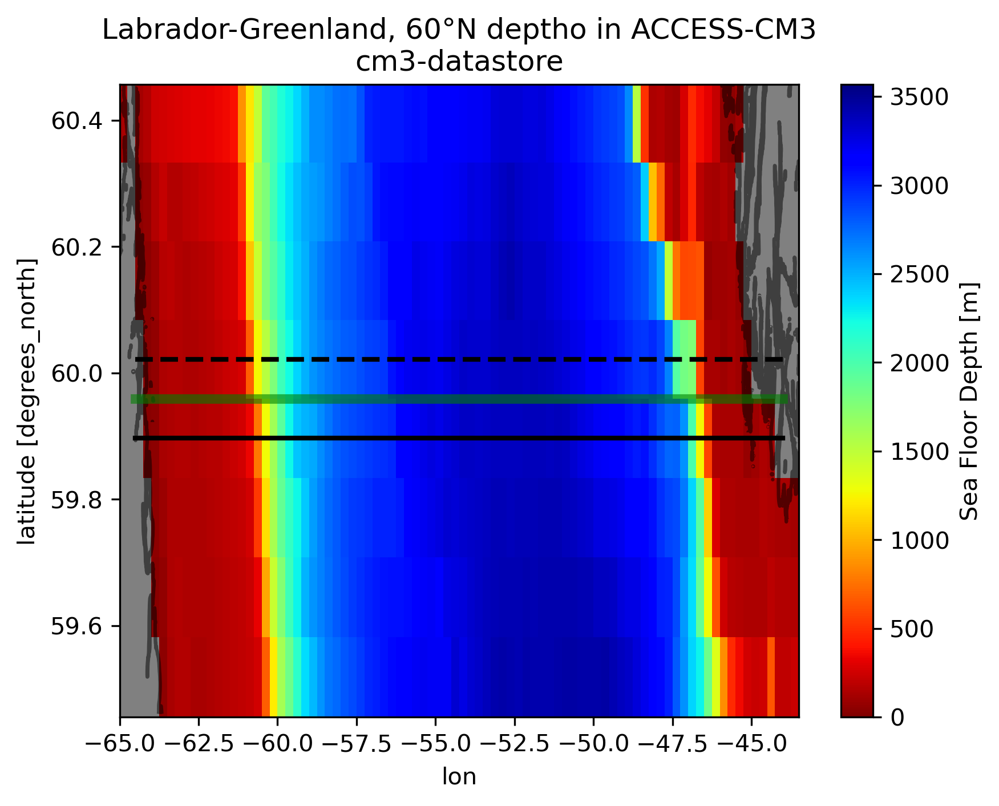

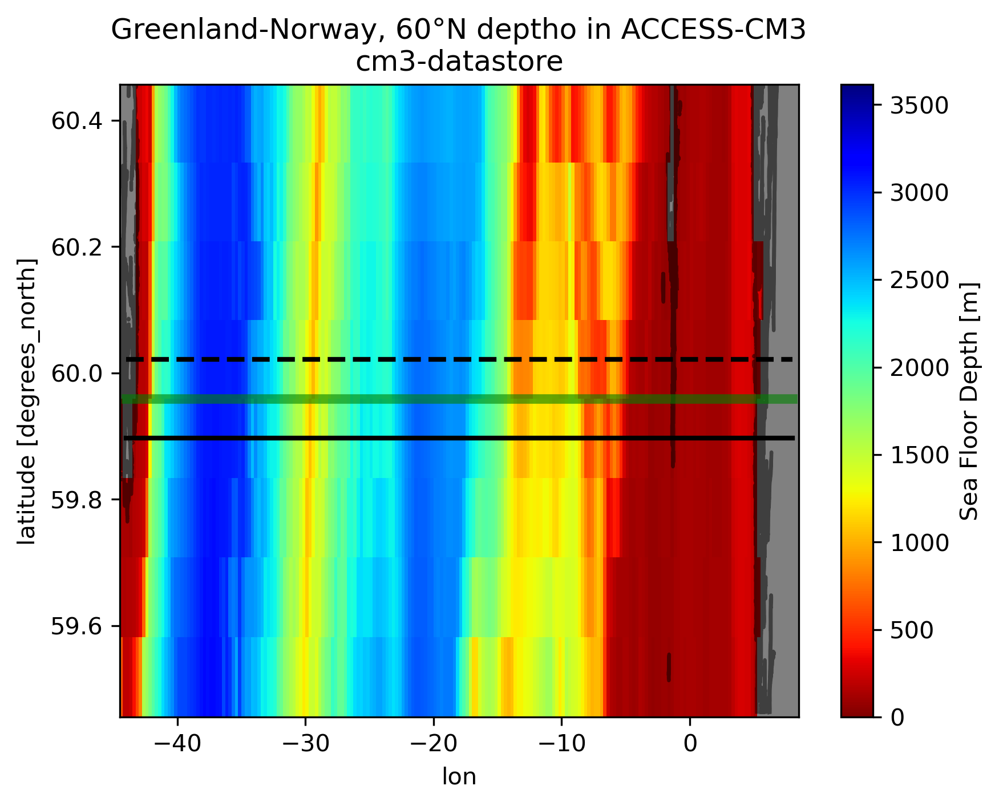

In [25]:
# plot maps of depth at transect locations, with GEBCO coastline
# BUG: GEBCO will be plotted incorrectly in tripolar region
m = 0.5 # margin (degrees)
for strait, (xmin, xmax, ymin, ymax) in om3straits['25km'].items():
    print(strait)
    fig, ax = plt.subplots(nrows=1, ncols=1)
    ax.set_facecolor('gray')  # gray land points
    h = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=slice(ymin-m, ymax+m)).load()
    g = -gebco.sel(lon=slice(glon(xmin-m), glon(xmax+m))).sel(lat=slice(ymin-m, ymax+m)).load()
    g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
    h.plot(cmap='jet_r', vmin=0, vmax=g.max())
    g.plot.contour(vmin=0, vmax=0, levels = 1, colors='black', alpha=0.5)
    if xmin == xmax:
        h1 = deptho.sel(xh=xmin, method='ffill').sel(yh=slice(ymin-m, ymax+m)).xh.values
        h2 = deptho.sel(xh=xmin, method='bfill').sel(yh=slice(ymin-m, ymax+m)).xh.values
        plt.plot([h1, h1], [ymin, ymax], 'k-', linewidth=2)
        plt.plot([h2, h2], [ymin, ymax], 'k--', linewidth=2)
    else:
        h1 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=ymin, method='ffill').yh.values
        h2 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=ymin, method='bfill').yh.values
        plt.plot([xmin, xmax], [h1, h1], 'k-', linewidth=2)
        plt.plot([xmin, xmax], [h2, h2], 'k--', linewidth=2)
    plt.plot([xmin, xmax], [ymin, ymax], color='green', linewidth=4, alpha=0.6)
    plt.title(f"{strait} {h.name} in {model_name}\n{exptname}")

Drake Passage
Makassar Strait
Lifamatola Passage
Lombok Strait
Ombai Strait
Timor Strait
Leti Strait
Karimata Strait
ITF South
ITF North
Bering Strait
Denmark Strait
East Taiwan Channel
Florida Current
Bosphorus
Gibraltar
Labrador-Greenland, 60°N
Greenland-Norway, 60°N


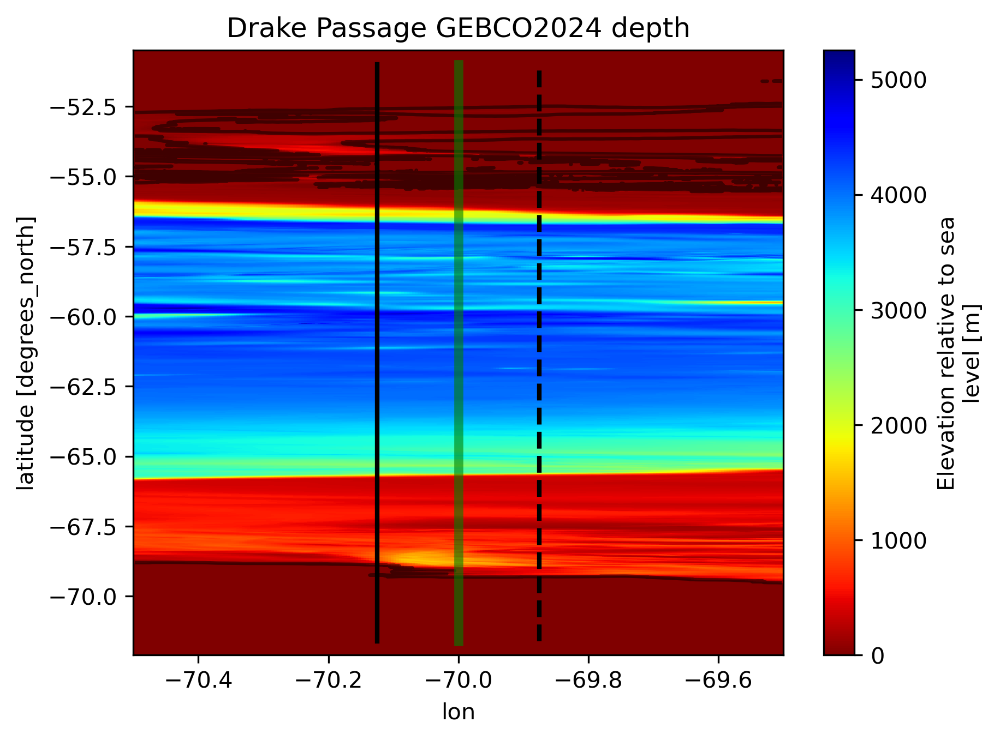

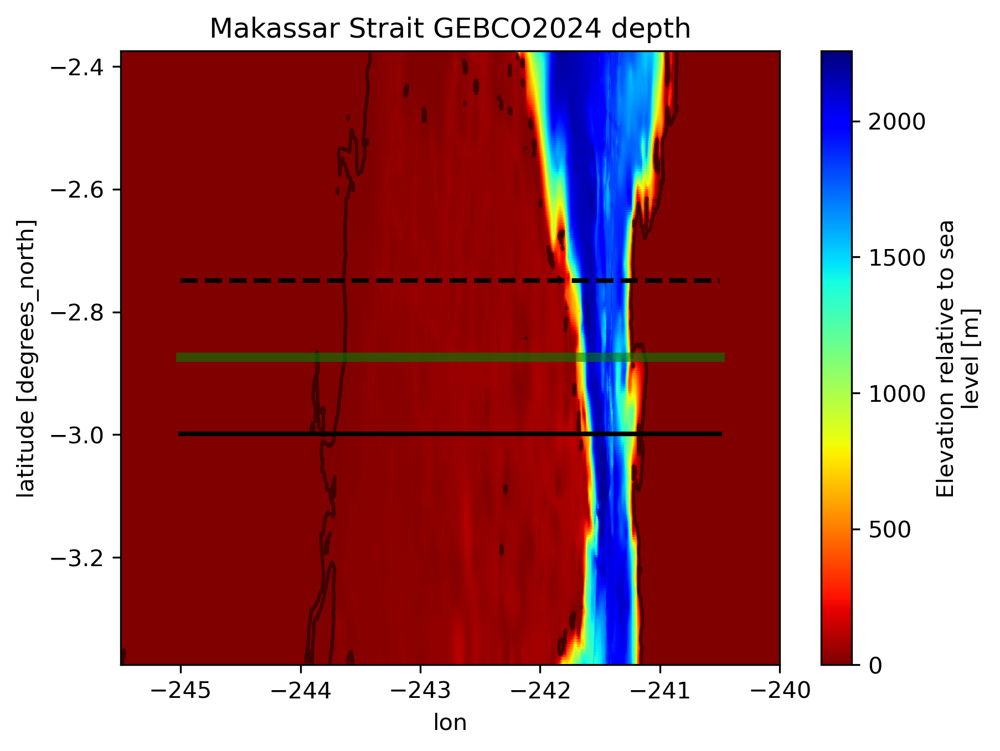

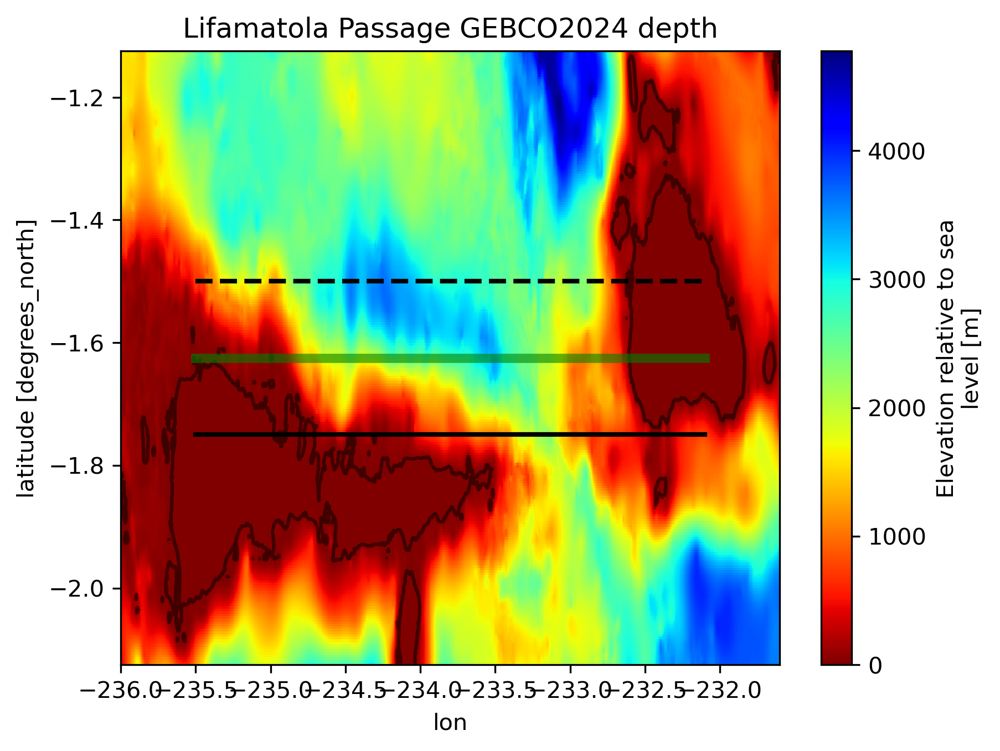

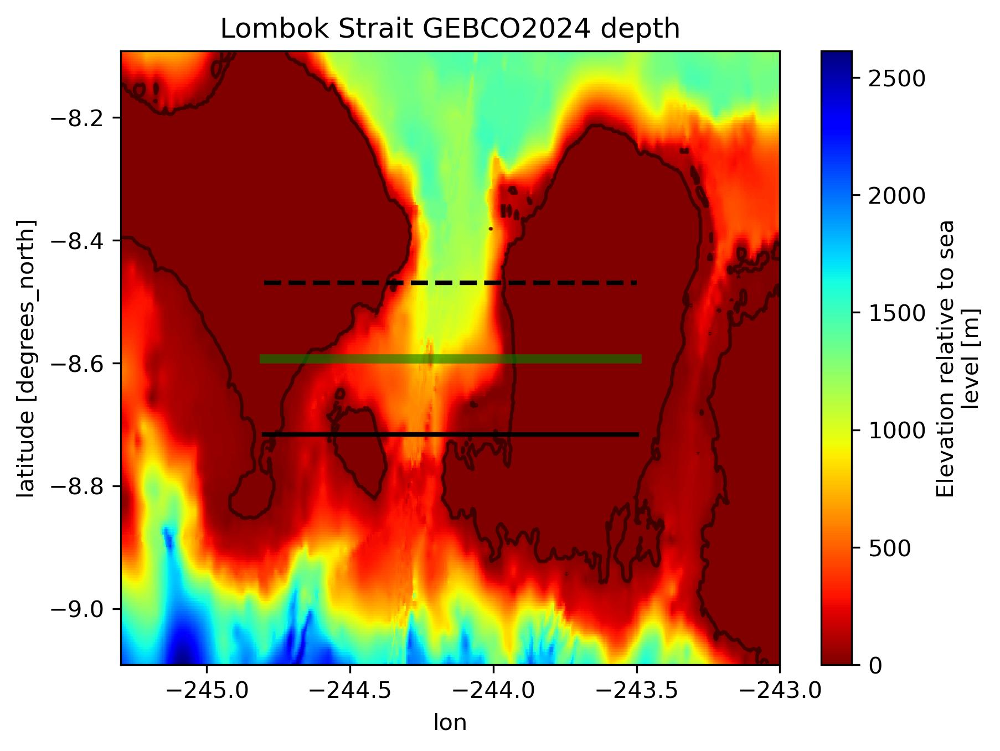

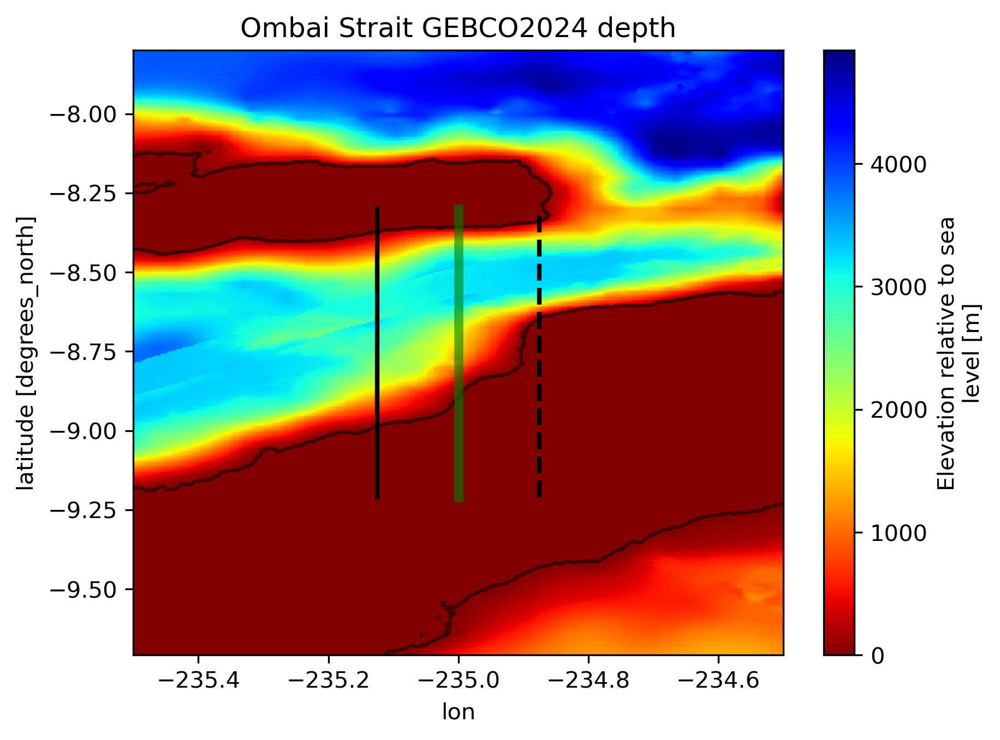

...

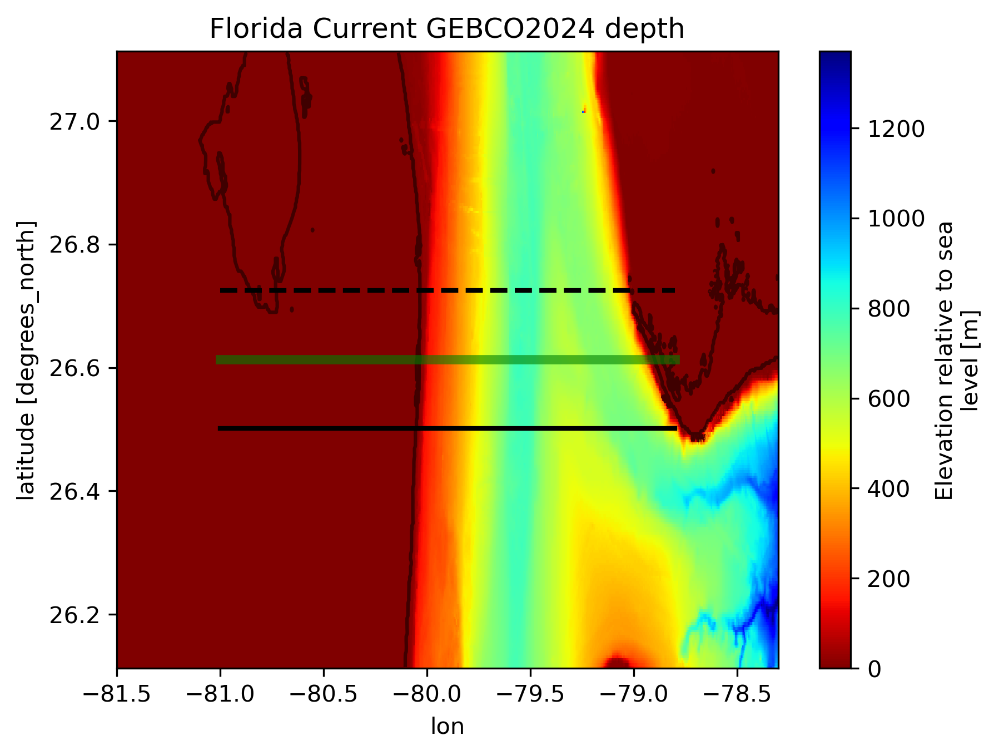

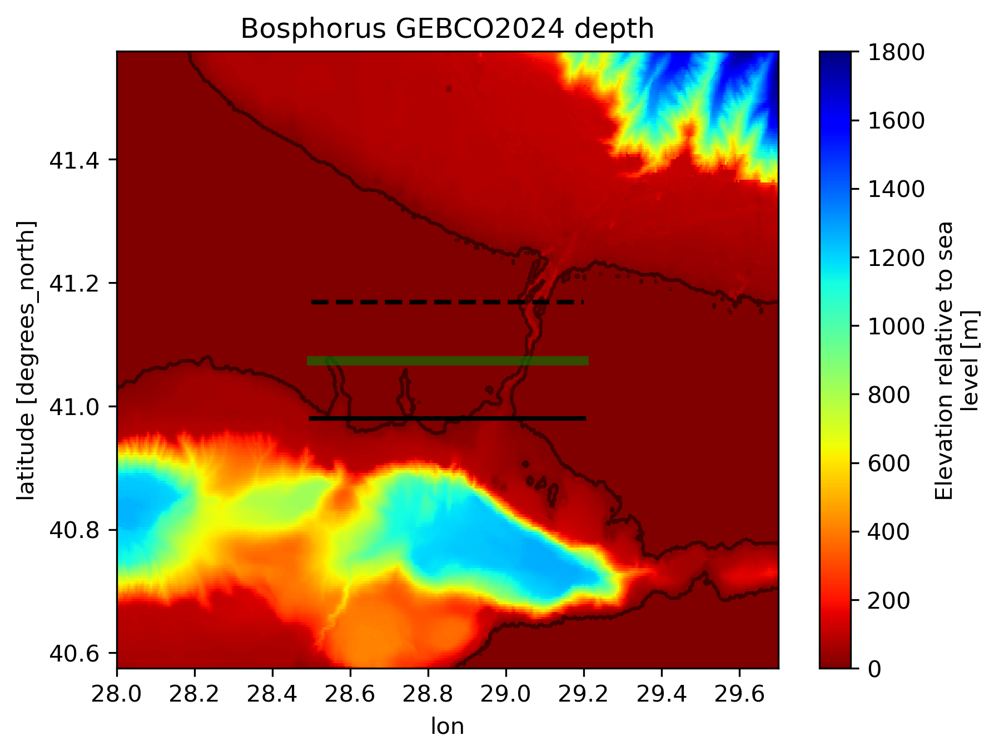

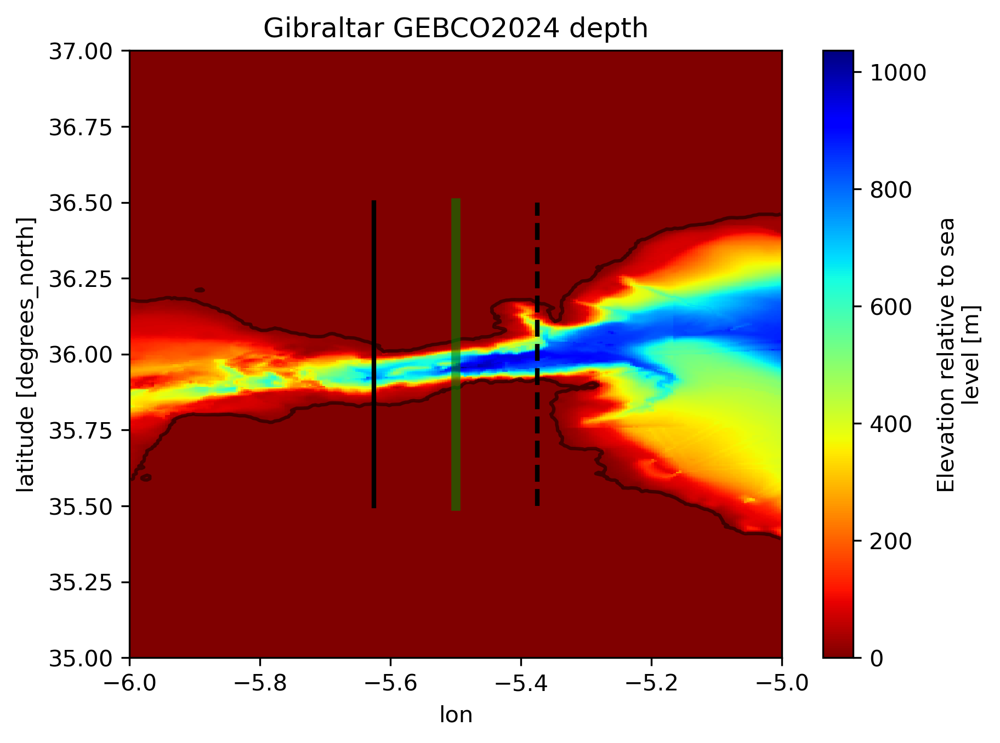

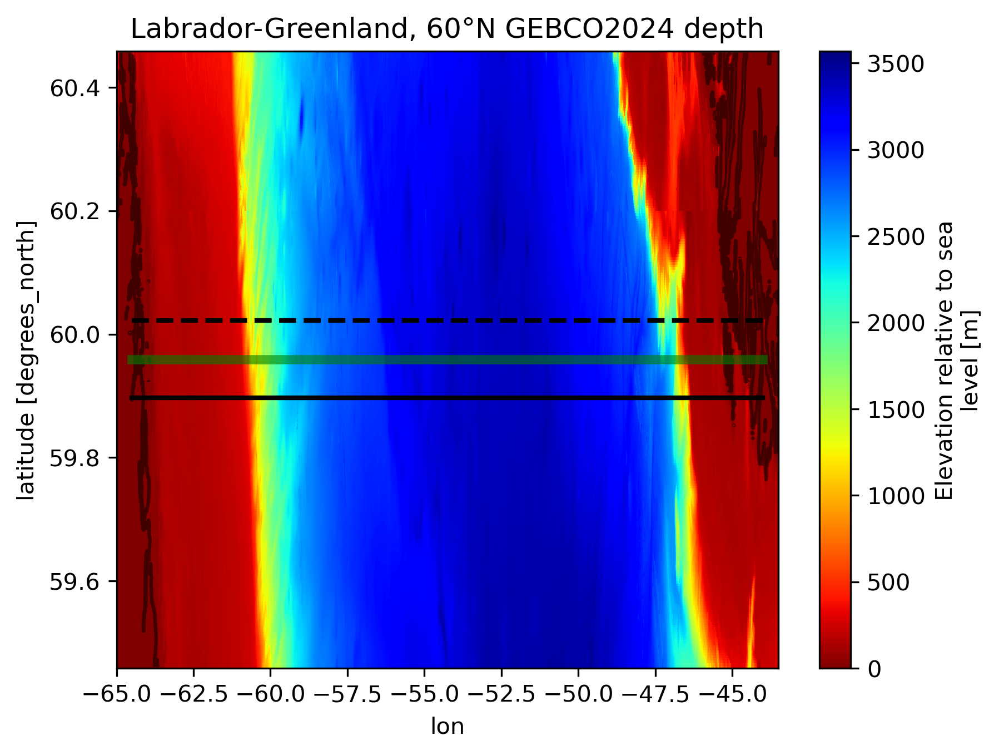

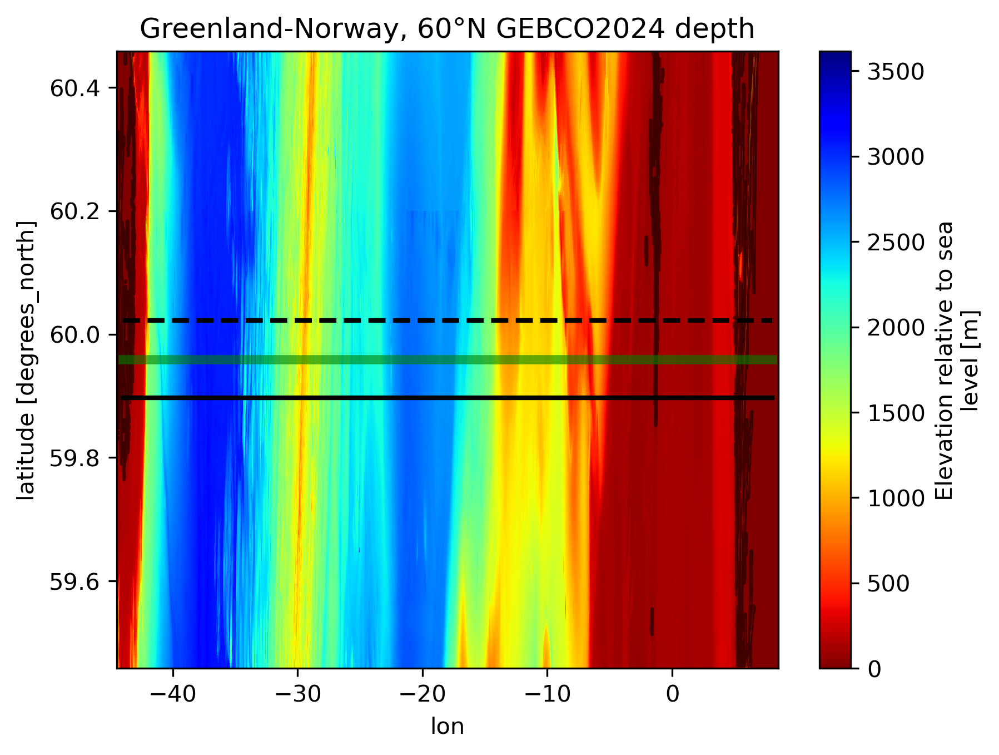

In [26]:
# plot maps of GEBCO depth at transect locations, with GEBCO coastline
# BUG: GEBCO will be plotted incorrectly in tripolar region
m = 0.5 # margin (degrees)
for strait, (xmin, xmax, ymin, ymax) in om3straits['25km'].items():
    print(strait)
    fig, ax = plt.subplots(nrows=1, ncols=1)
    ax.set_facecolor('gray')  # gray land points
    g = -gebco.sel(lon=slice(glon(xmin-m), glon(xmax+m))).sel(lat=slice(ymin-m, ymax+m)).load()
    g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
    g.plot(cmap='jet_r', vmin=0, vmax=g.max(), extend='neither')
    g.plot.contour(vmin=0, vmax=0, levels = 1, colors='black', alpha=0.5)
    if xmin == xmax:
        h1 = deptho.sel(xh=xmin, method='ffill').sel(yh=slice(ymin-m, ymax+m)).xh.values
        h2 = deptho.sel(xh=xmin, method='bfill').sel(yh=slice(ymin-m, ymax+m)).xh.values
        plt.plot([h1, h1], [ymin, ymax], 'k-', linewidth=2)
        plt.plot([h2, h2], [ymin, ymax], 'k--', linewidth=2)
    else:
        h1 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=ymin, method='ffill').yh.values
        h2 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=ymin, method='bfill').yh.values
        plt.plot([xmin, xmax], [h1, h1], 'k-', linewidth=2)
        plt.plot([xmin, xmax], [h2, h2], 'k--', linewidth=2)
    plt.plot([xmin, xmax], [ymin, ymax], color='green', linewidth=4, alpha=0.6)
    plt.title(f"{strait} GEBCO2024 depth")

Drake Passage
Makassar Strait
Lifamatola Passage
Lombok Strait
Ombai Strait
Timor Strait
Leti Strait
Karimata Strait
ITF South
ITF North
Bering Strait
Denmark Strait
East Taiwan Channel
Florida Current
Bosphorus
Gibraltar
Labrador-Greenland, 60°N
Greenland-Norway, 60°N


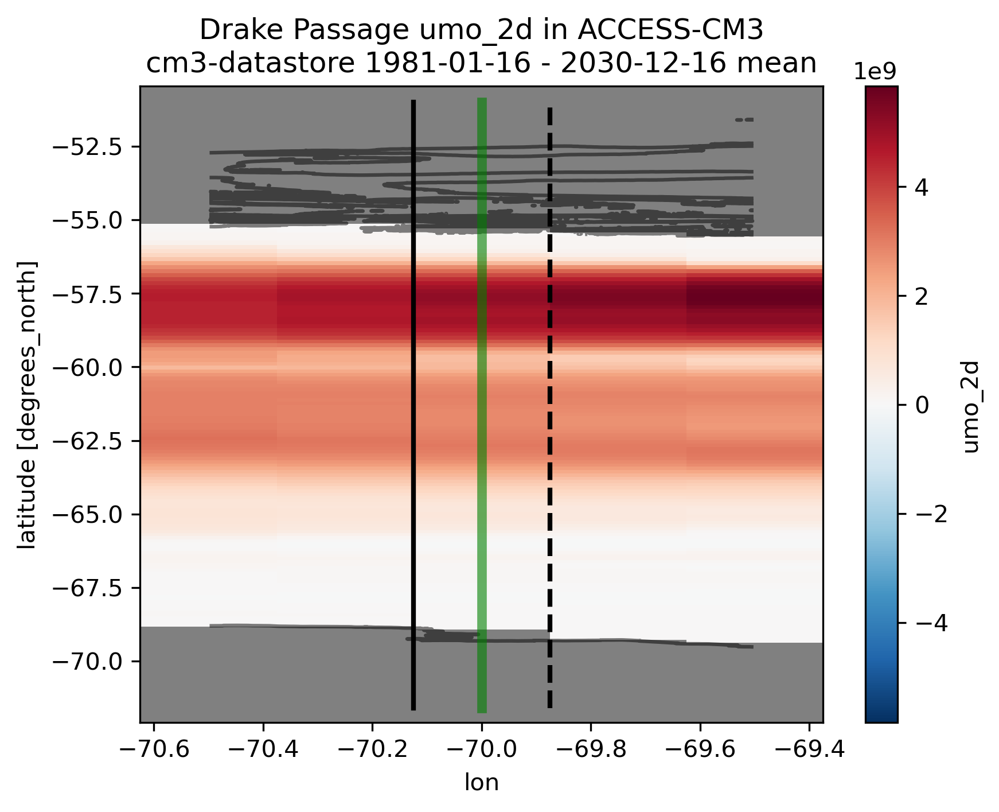

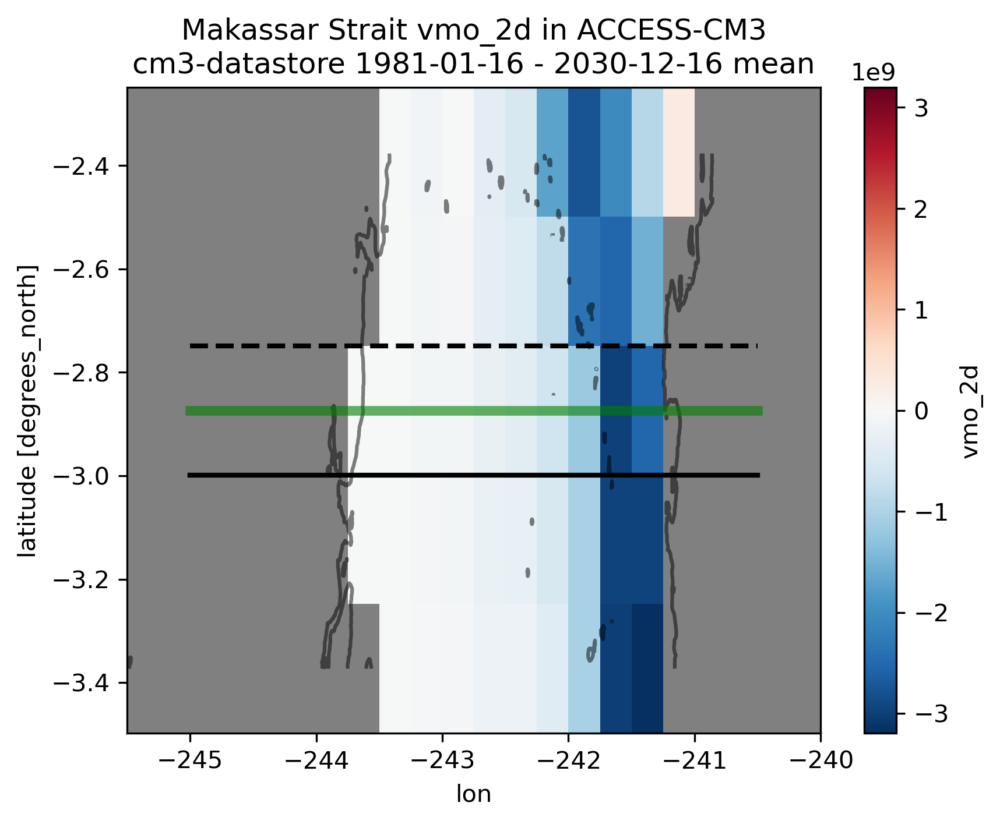

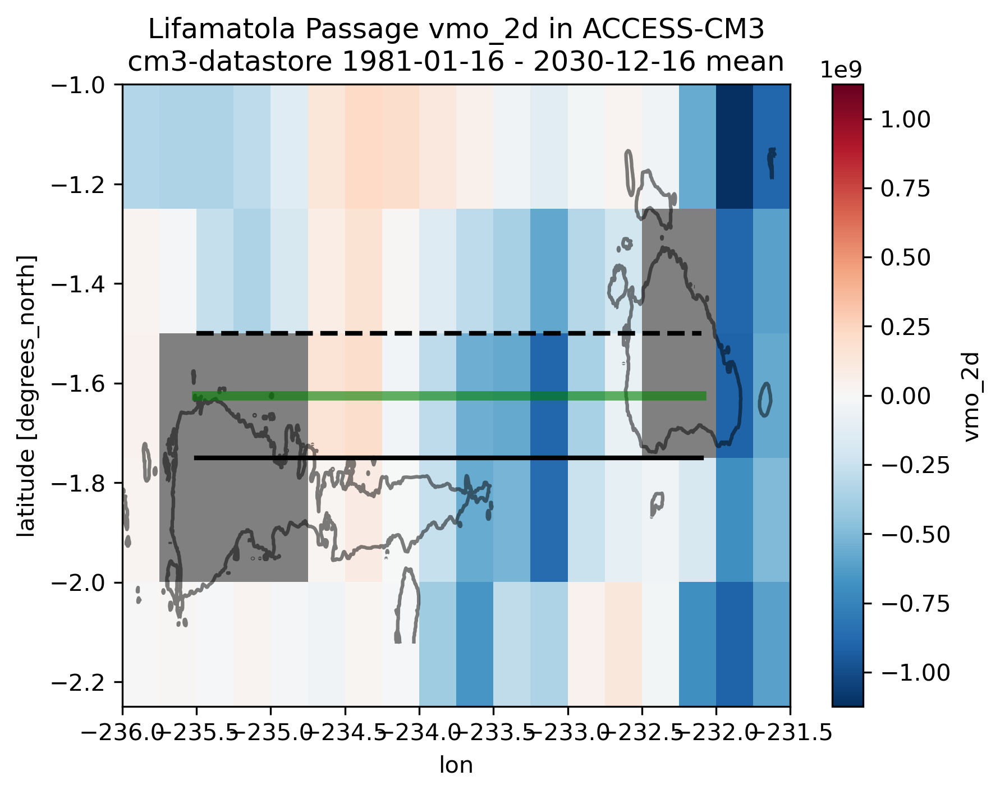

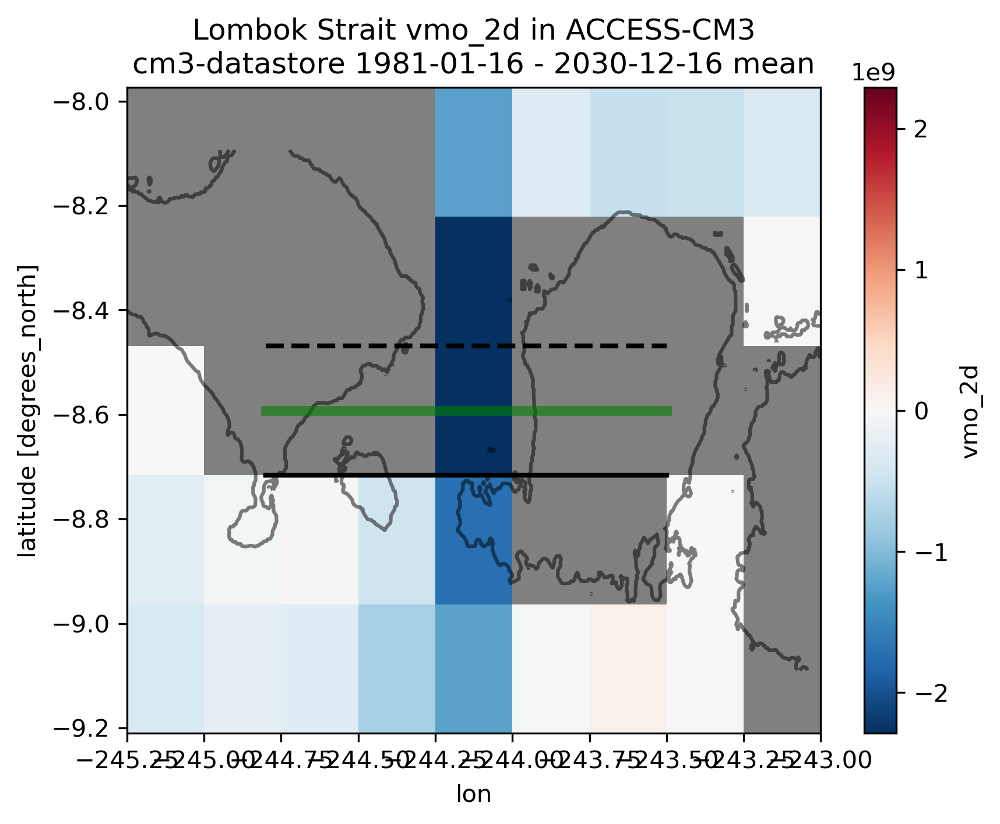

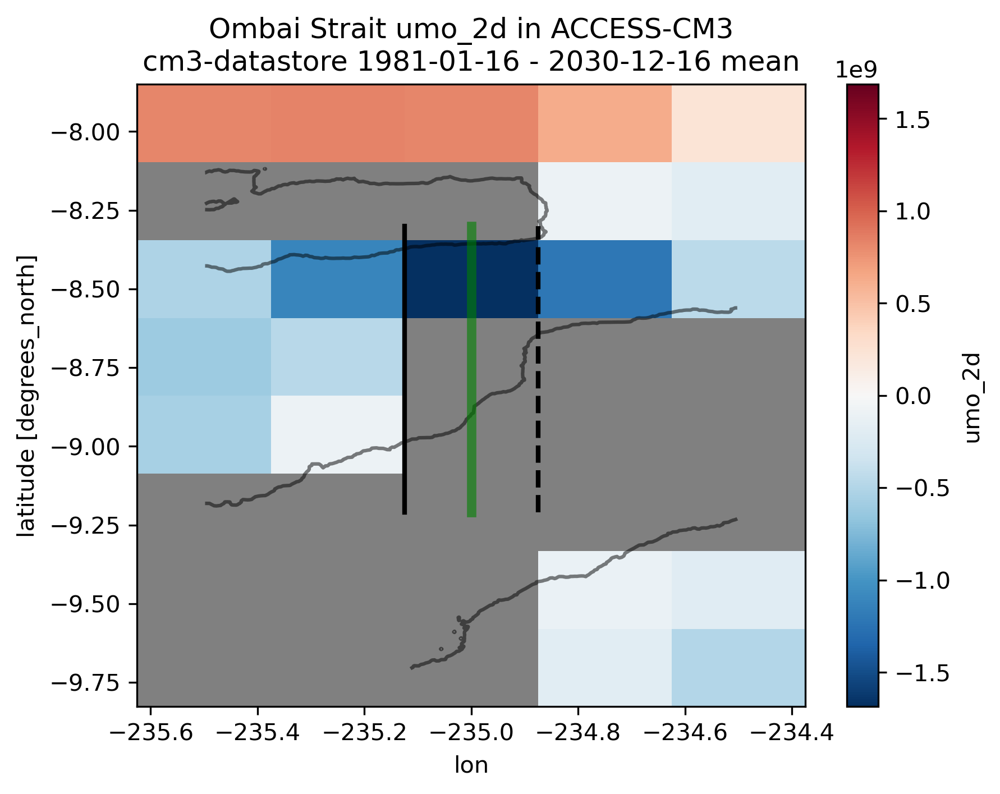

...

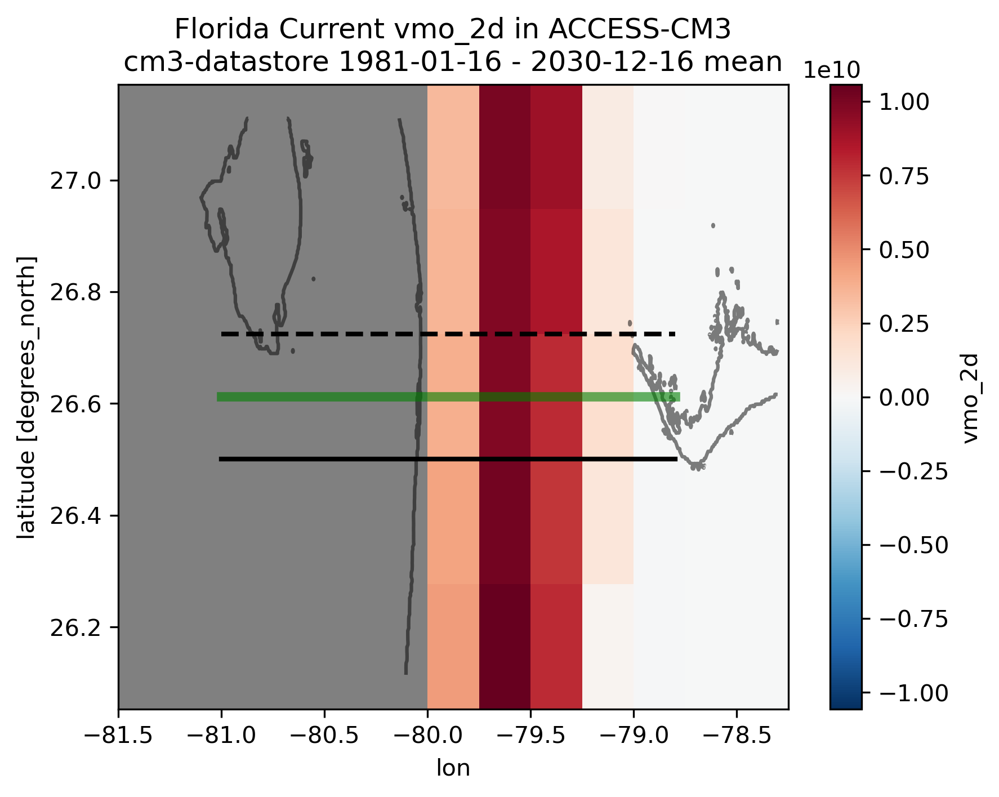

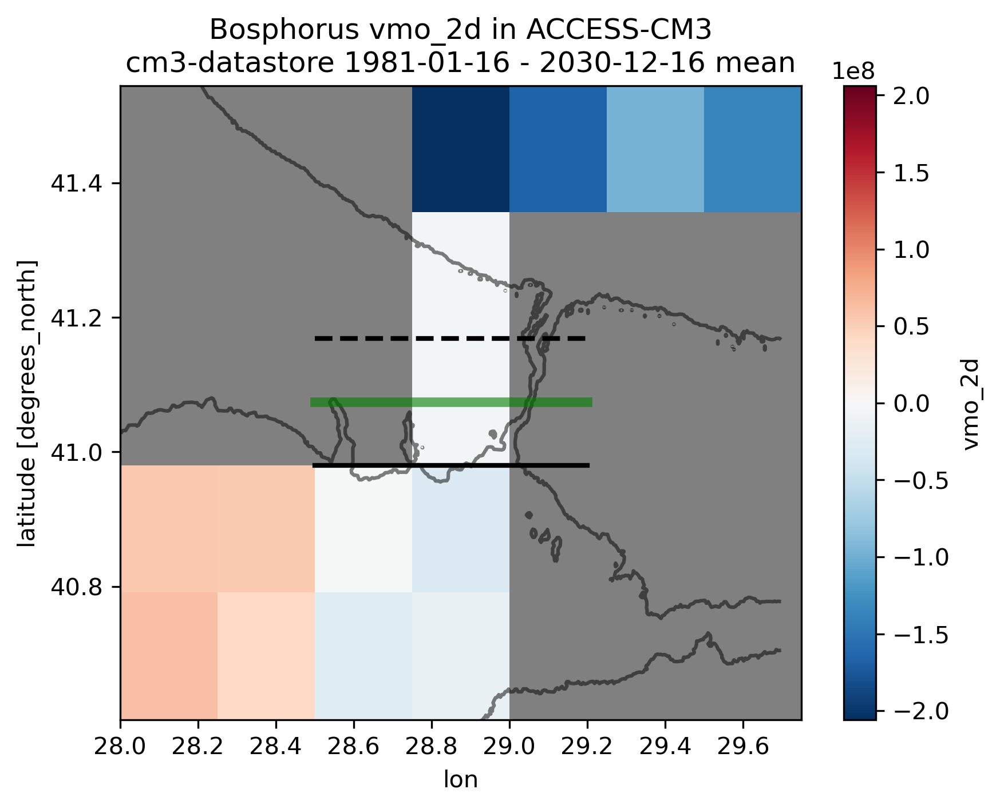

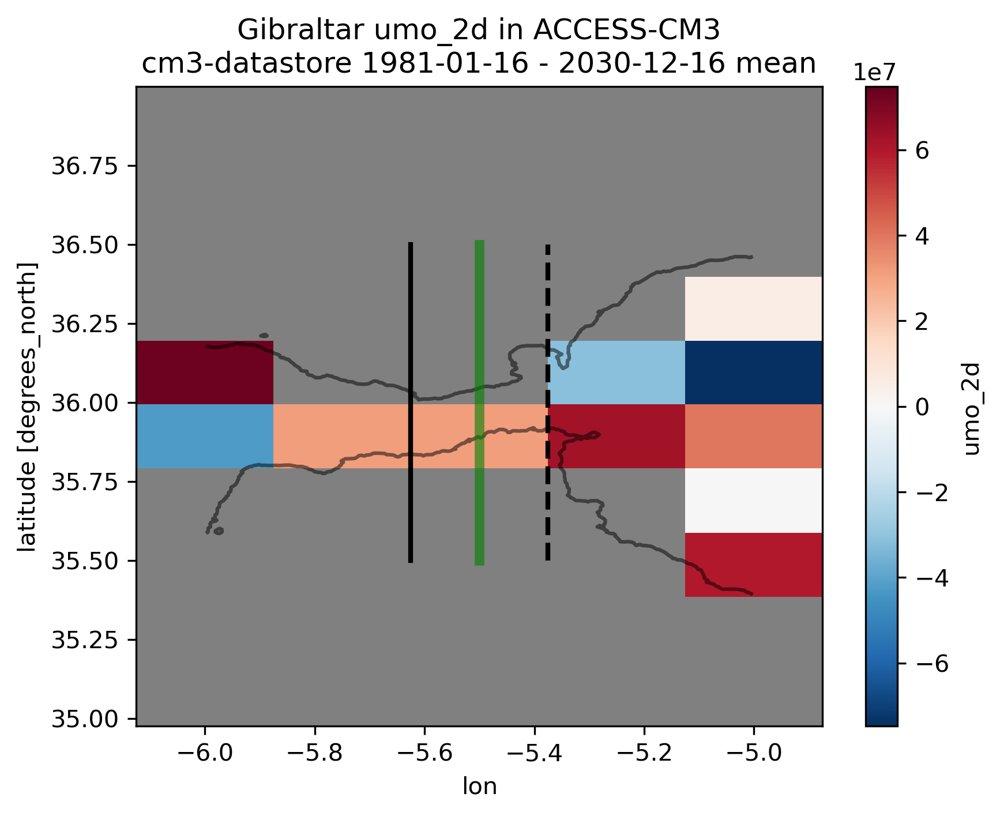

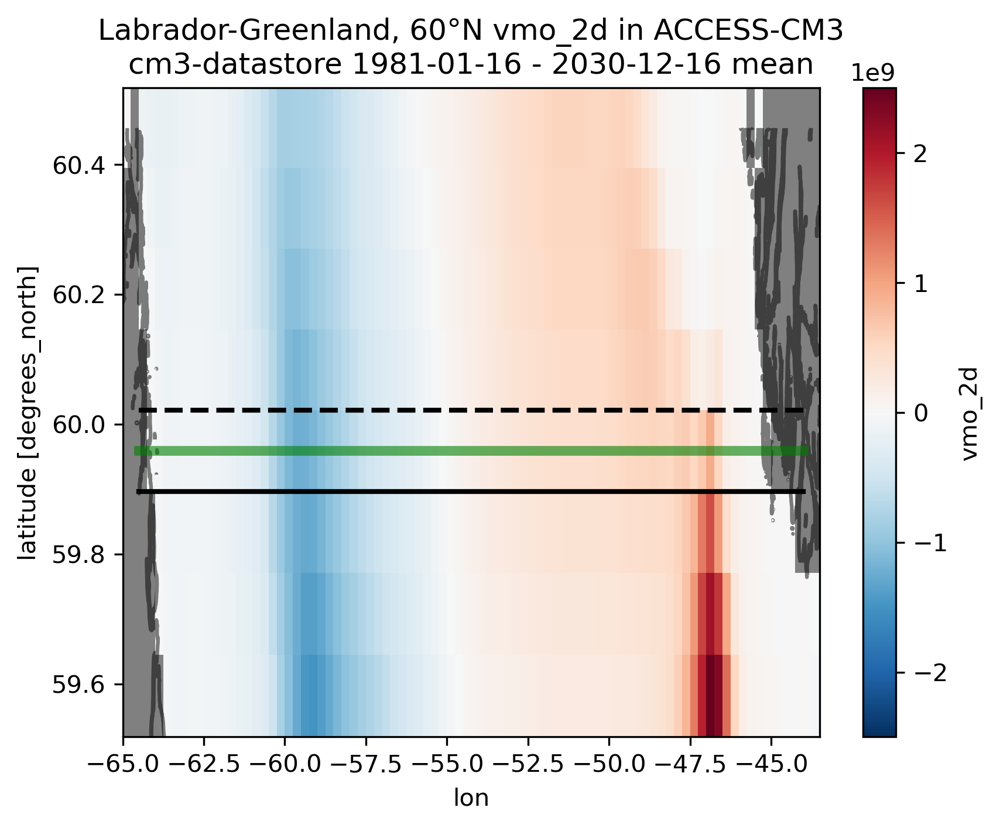

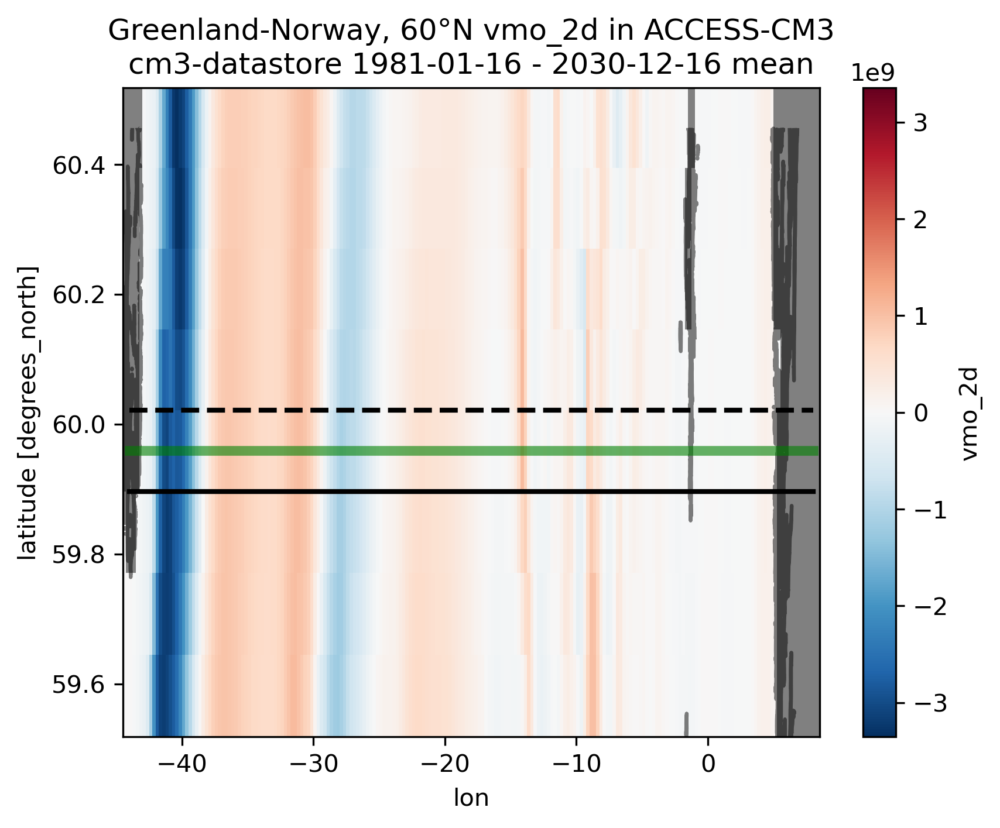

In [27]:
# plot maps of transport at transect locations, with GEBCO coastline
# BUG: GEBCO will be plotted incorrectly in tripolar region
m = 0.5 # margin (degrees)
for strait, (xmin, xmax, ymin, ymax) in om3straits['25km'].items():
    print(strait)
    fig, ax = plt.subplots(nrows=1, ncols=1)
    ax.set_facecolor('gray')  # gray land points
    if xmin == xmax:
        vel = umo_2d.sel(time=timeslice).sel(xq=slice(xmin-m, xmax+m)).sel(yh=slice(ymin-m, ymax+m))
    else:
        vel = vmo_2d.sel(time=timeslice).sel(xh=slice(xmin-m, xmax+m)).sel(yq=slice(ymin-m, ymax+m))
    velmean = vel.mean('time')
    velmean.plot()
    g = -gebco.sel(lon=slice(glon(xmin-m), glon(xmax+m))).sel(lat=slice(ymin-m, ymax+m)).load()
    g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
    g.plot.contour(vmin=0, vmax=0, levels = 1, colors='black', alpha=0.5)
    if xmin == xmax:
        h1 = deptho.sel(xh=xmin, method='ffill').sel(yh=slice(ymin-m, ymax+m)).xh.values
        h2 = deptho.sel(xh=xmin, method='bfill').sel(yh=slice(ymin-m, ymax+m)).xh.values
        plt.plot([h1, h1], [ymin, ymax], 'k-', linewidth=2)
        plt.plot([h2, h2], [ymin, ymax], 'k--', linewidth=2)
    else:
        h1 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=ymin, method='ffill').yh.values
        h2 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=ymin, method='bfill').yh.values
        plt.plot([xmin, xmax], [h1, h1], 'k-', linewidth=2)
        plt.plot([xmin, xmax], [h2, h2], 'k--', linewidth=2)
    plt.plot([xmin, xmax], [ymin, ymax], color='green', linewidth=4, alpha=0.6)
    plt.title(f"{strait} {vel.name} in {model_name}\n{exptname} {vel.time.values[0].strftime('%Y-%m-%d')} - {vel.time.values[-1].strftime('%Y-%m-%d')} mean")

## Plot OM3 transects

Drake Passage
Makassar Strait
Lifamatola Passage
Lombok Strait
Ombai Strait
Timor Strait
Leti Strait
Karimata Strait
ITF South
ITF North
Bering Strait
Denmark Strait
East Taiwan Channel
Florida Current
Bosphorus
Gibraltar
Labrador-Greenland, 60°N
Greenland-Norway, 60°N


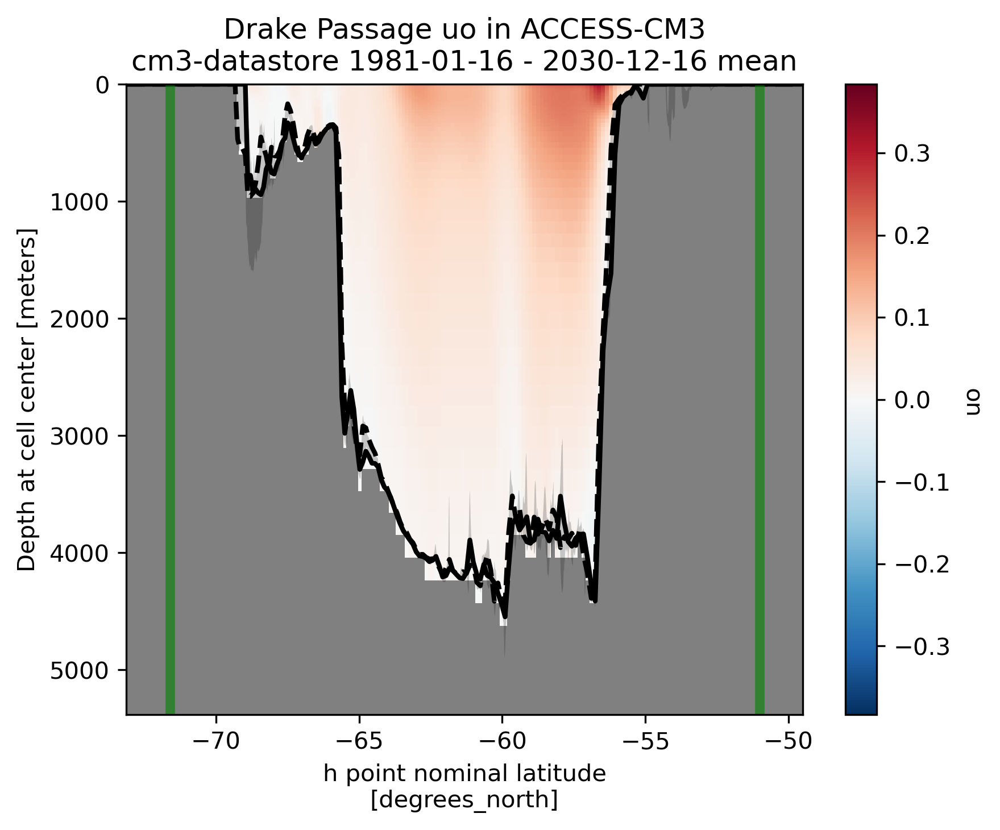

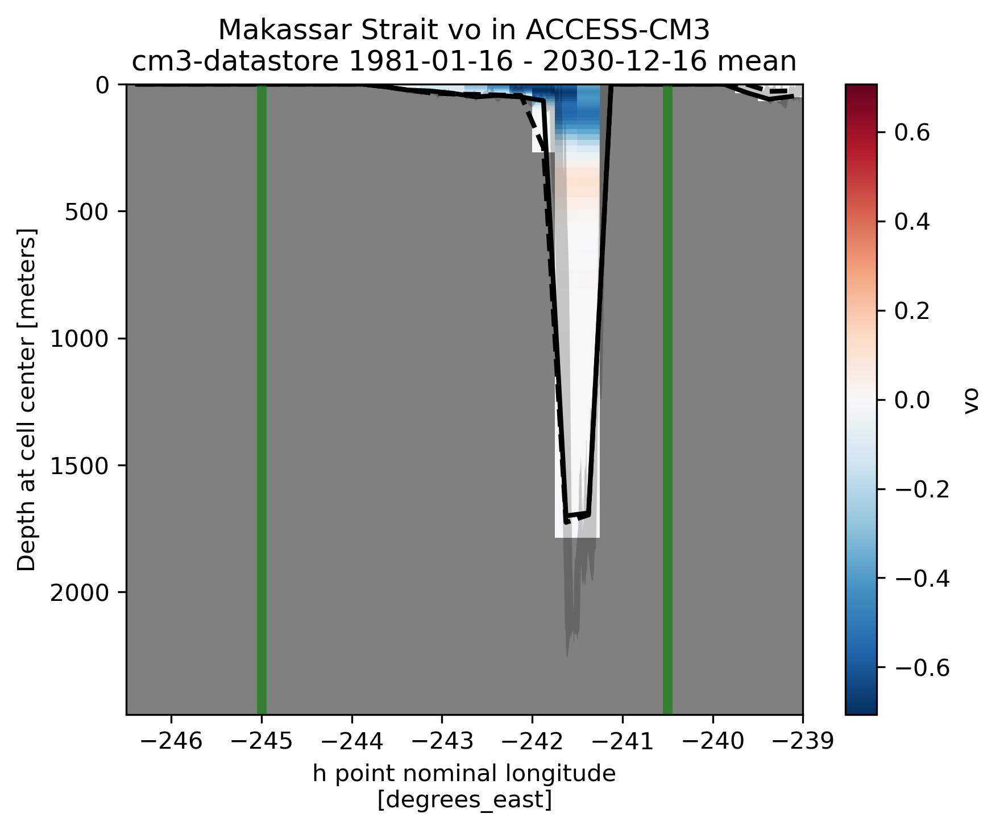

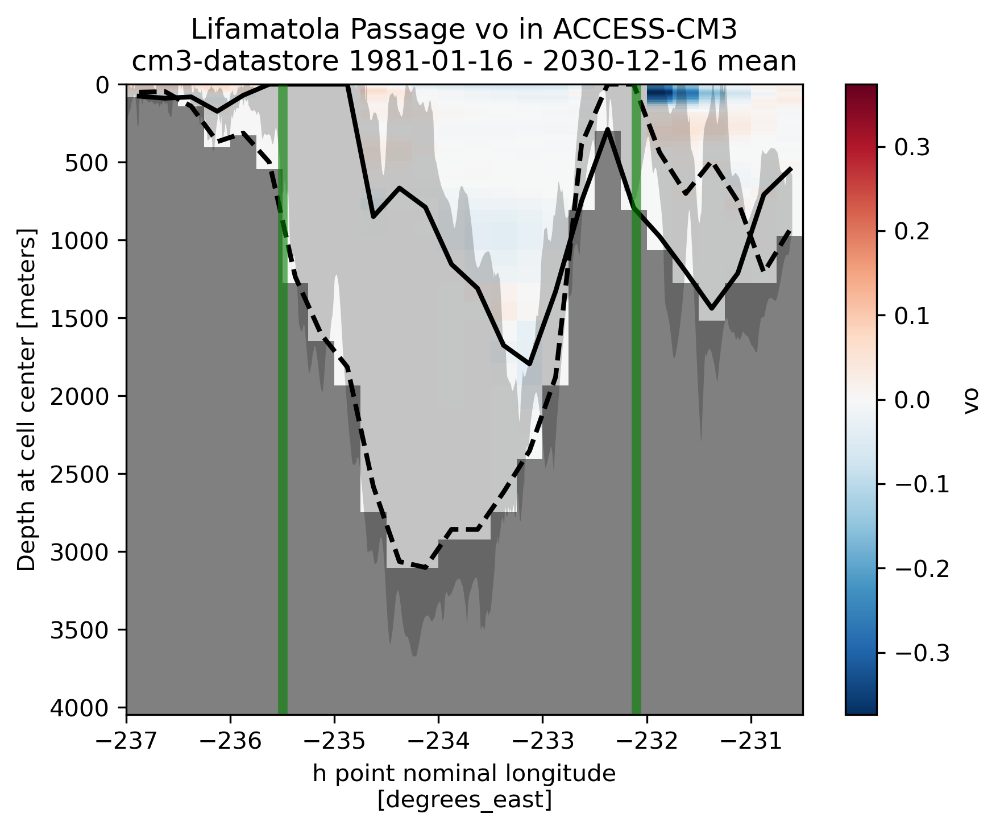

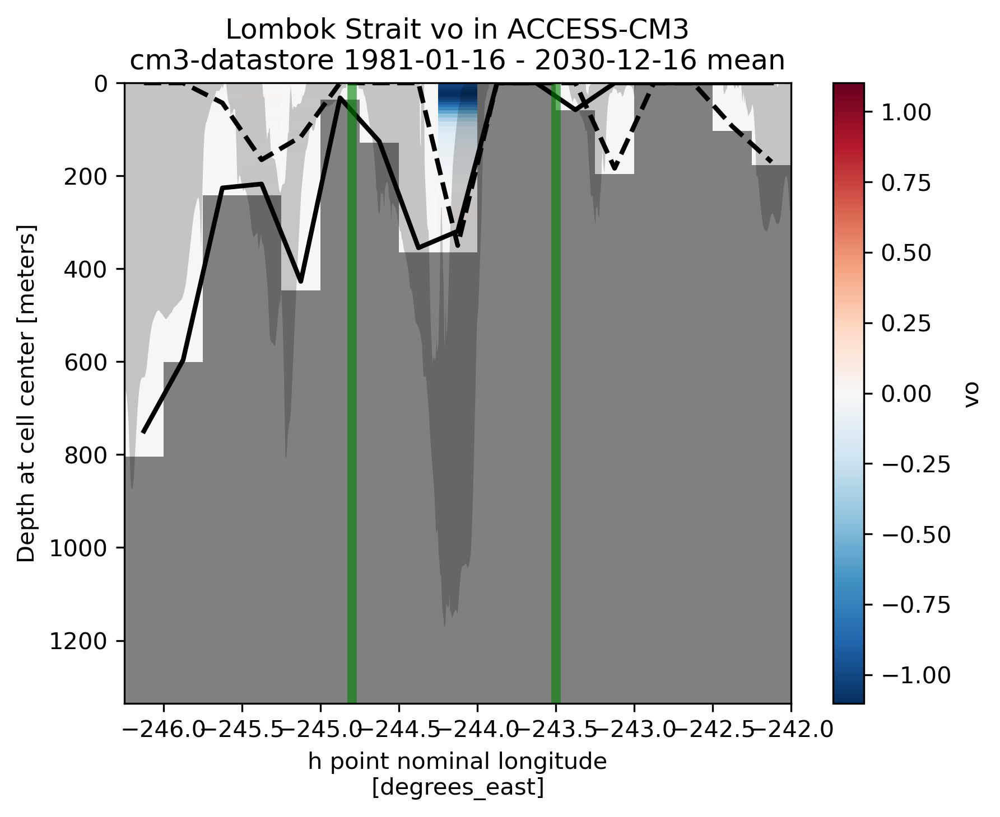

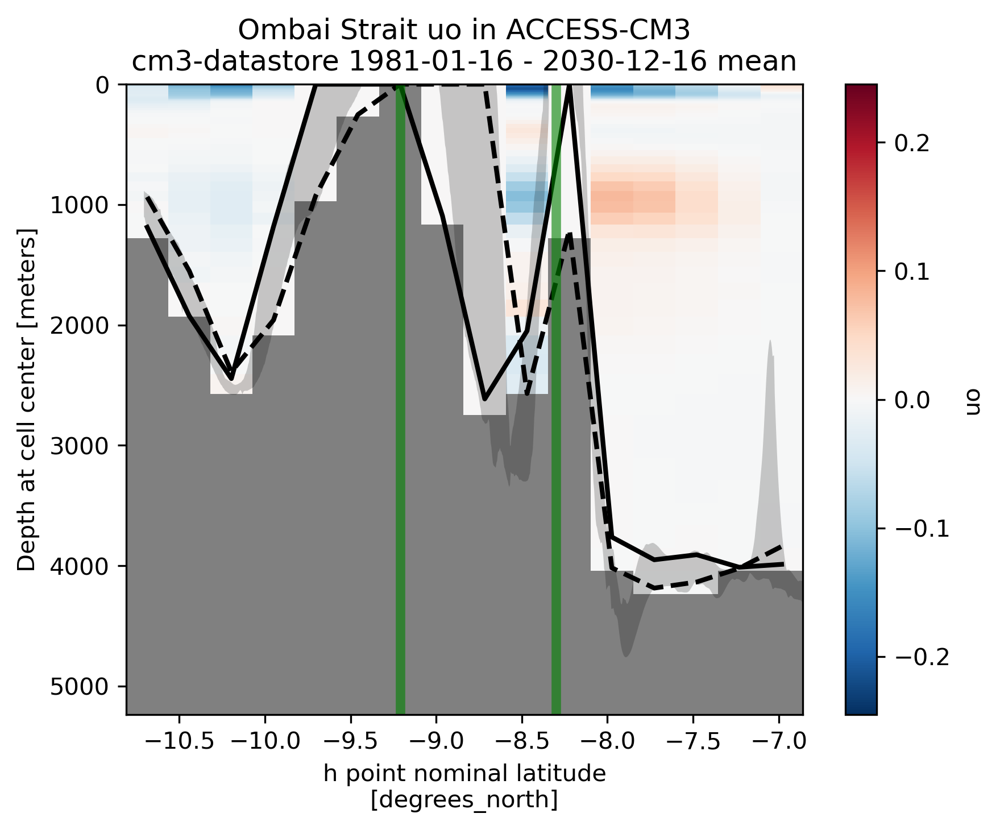

...

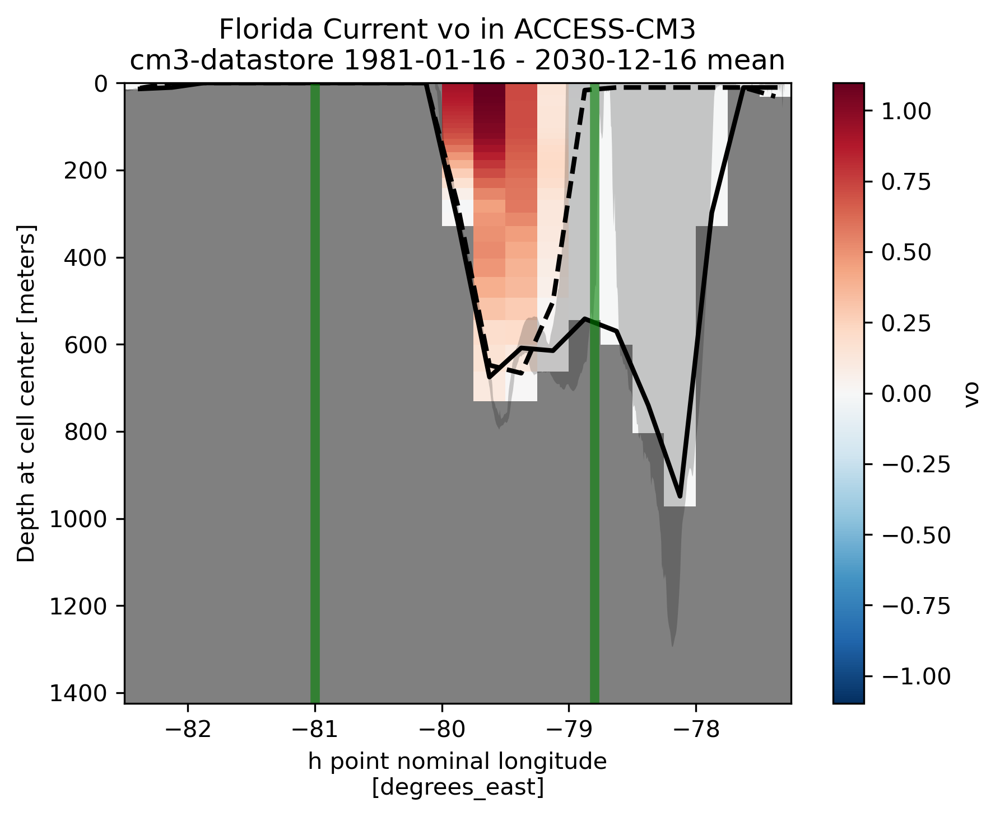

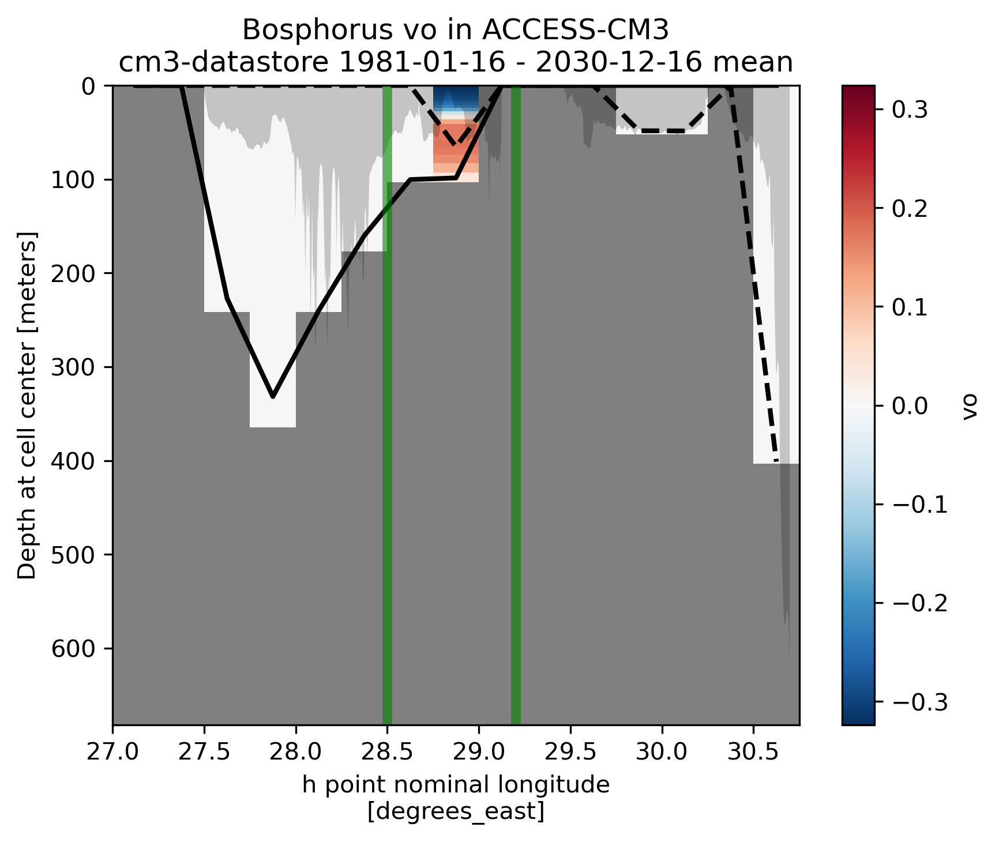

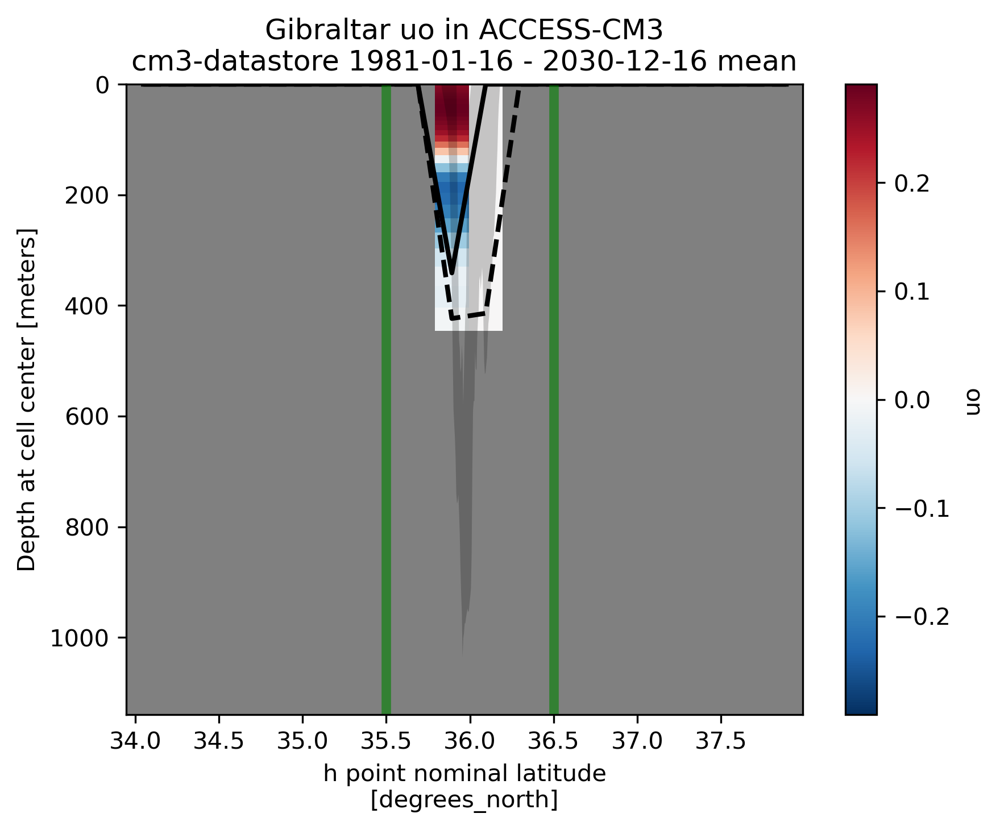

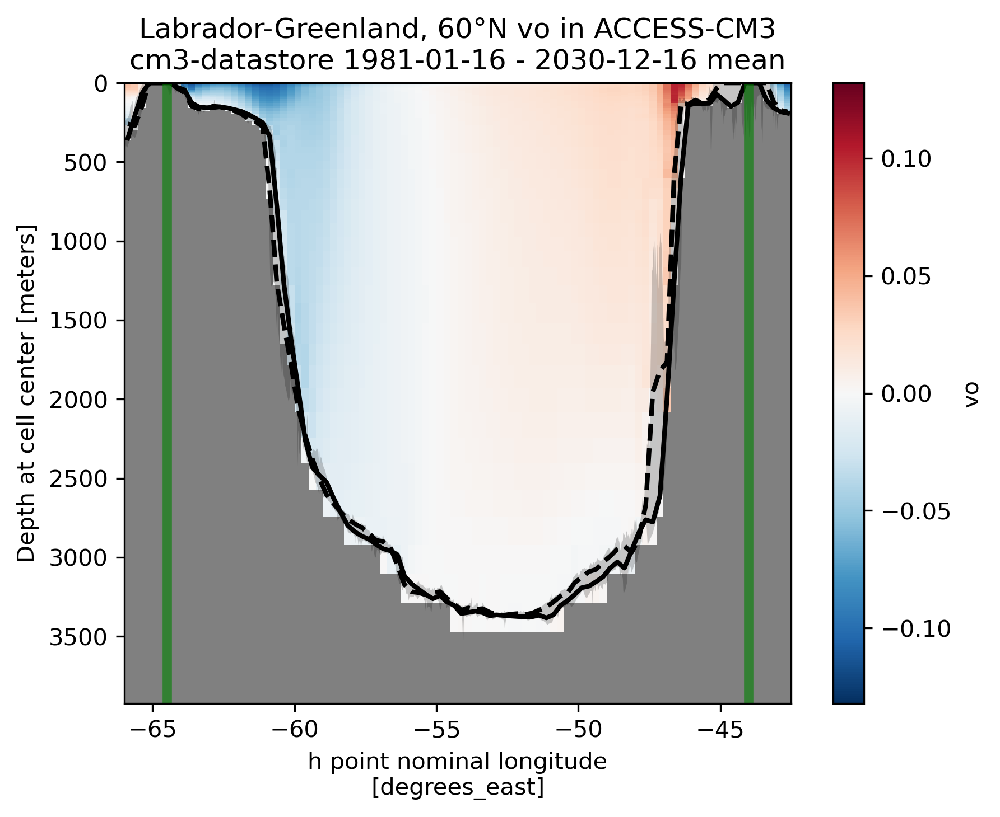

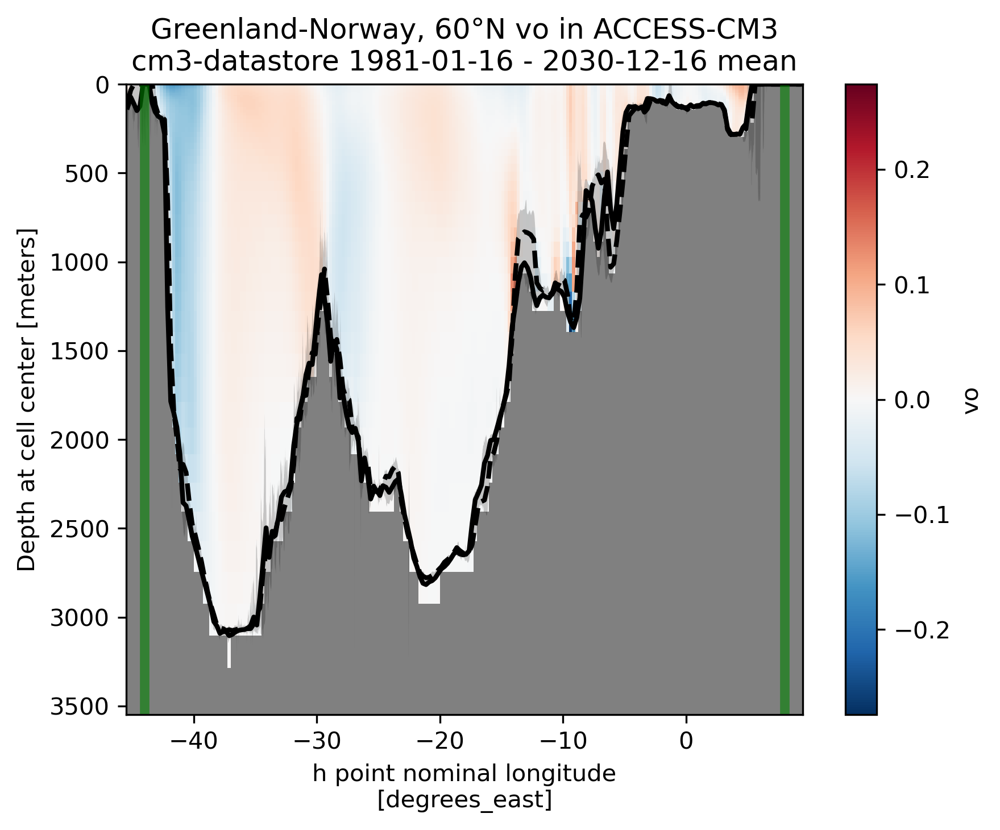

In [28]:
# plot vertical slices at transect locations, with range of GEBCO bathymetry over grid cell width
# BUG: GEBCO will be plotted incorrectly in tripolar region
m = 1.5  # margin (degrees)
res = 0.25  # nominal grid resolution (degrees) - BUG: too large in latitude except at equator
for strait, (xmin, xmax, ymin, ymax) in om3straits['25km'].items():
    print(strait)
    fig, ax = plt.subplots(nrows=1, ncols=1)
    ax.set_facecolor('gray')  # gray land points
    if xmin == xmax:
        vel = uo.sel(time=timeslice).sel(xq=xmin, method='nearest').sel(yh=slice(ymin-m, ymax+m))
        velmean = vel.mean('time')
        velmean.plot()
        g = -gebco.sel(lon=slice(glon(vel.xq.values-res/2), glon(vel.xq.values+res/2))).sel(lat=slice(ymin-m, ymax+m)).load()
        g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
        plt.gca().fill_between(g.lat.values, g.min(dim='lon'), g.max(dim='lon'), color='black', edgecolor=None, alpha=0.2)
        h1 = deptho.sel(xh=vel.xq.values, method='ffill').sel(yh=slice(ymin-m, ymax+m))
        h2 = deptho.sel(xh=vel.xq.values, method='bfill').sel(yh=slice(ymin-m, ymax+m))
        plt.plot(h1.yh, h1.fillna(0), 'k-', linewidth=2)
        plt.plot(h2.yh, h2.fillna(0), 'k--', linewidth=2)
        zlim = 2*plt.gca().get_ylim()[1]
        plt.plot([ymin, ymin, ymax, ymax], [0, zlim, zlim, 0],
            color='green', linewidth=4, alpha=0.6)
    else:
        vel = vo.sel(time=timeslice).sel(xh=slice(xmin-m, xmax+m)).sel(yq=ymin, method='nearest')
        velmean = vel.mean('time')
        velmean.plot()
        g = -gebco.sel(lon=slice(glon(xmin-m), glon(xmax+m))).sel(lat=slice(vel.yq.values-res/2, vel.yq.values+res/2)).load()
        g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
        plt.gca().fill_between(g.lon.values, g.min(dim='lat'), g.max(dim='lat'), color='black', edgecolor=None, alpha=0.2)
        h1 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=vel.yq.values, method='ffill')
        h2 = deptho.sel(xh=slice(xmin-m, xmax+m)).sel(yh=vel.yq.values, method='bfill')
        plt.plot(h1.xh, h1.fillna(0), 'k-', linewidth=2)
        plt.plot(h2.xh, h2.fillna(0), 'k--', linewidth=2)
        zlim = 2*plt.gca().get_ylim()[1]
        plt.plot([xmin, xmin, xmax, xmax], [0, zlim, zlim, 0],
            color='green', linewidth=4, alpha=0.6)
    plt.gca().set_ylim([None, 1.1*np.max(g)])
    plt.gca().invert_yaxis()
    plt.title(f"{strait} {vel.name} in {model_name}\n{exptname} {vel.time.values[0].strftime('%Y-%m-%d')} - {vel.time.values[-1].strftime('%Y-%m-%d')} mean")

## Load ACCESS-OM2 data from ACCESS-NRI Catalog

### BUG: GM and submeso transport neglected!


In [29]:
catalog = intake.cat.access_nri

In [43]:
if model_name == "ACCESS-OM3":
    data_name = 'ACCESS-OM2'
    if IAF:
        om2exptname = '025deg_jra55_iaf_omip2_cycle1'
    else:
        om2exptname = '025deg_jra55_ryf9091_gadi'
elif model_name == "ACCESS-CM3":
        data_name = 'ACCESS-CM2'
        om2exptname = 'cj877'

In [31]:
if model_name == "ACCESS-OM3":

    cat = catalog[om2exptname]

    tx_trans_int_z = cat_var(cat, "tx_trans_int_z", "1mon").rename("tx_trans_int_z")
    ty_trans_int_z = cat_var(cat, "ty_trans_int_z", "1mon").rename("ty_trans_int_z")

    u  = cat_var(cat, "u",  "1mon").rename("u")
    v  = cat_var(cat, "v",  "1mon").rename("v")

    ht = cat_var(cat, "ht", "fx").rename("ht")
    hu = cat_var(cat, "hu", "fx").rename("hu")
    
elif model_name == "ACCESS-CM3":
    # CM3: from file paths (YOU set these patterns)
    tx_trans_int_z = load_cm3("/g/data/p73/archive/non-CMIP/ACCESS-CM2/cj877/history/ocn/ocean-2d-tx_trans_int_z-1-monthly-mean-ym_*.nc", "tx_trans_int_z")
    ty_trans_int_z = load_cm3("/g/data/p73/archive/non-CMIP/ACCESS-CM2/cj877/history/ocn/ocean-2d-ty_trans_int_z-1-monthly-mean-ym_*.nc", "ty_trans_int_z")

    u = load_cm3("/g/data/p73/archive/non-CMIP/ACCESS-CM2/cj877/history/ocn/ocean-3d-u-1-monthly-mean-ym_*.nc", "u")
    v = load_cm3("/g/data/p73/archive/non-CMIP/ACCESS-CM2/cj877/history/ocn/ocean-3d-v-1-monthly-mean-ym_*.nc", "v")

    ht = load_cm3("/g/data/p73/archive/non-CMIP/ACCESS-CM2/cj877/history/ocn/ocean-2d-ht.nc", "ht")
    hu = load_cm3("/g/data/p73/archive/non-CMIP/ACCESS-CM2/cj877/history/ocn/ocean-2d-hu.nc", "hu")

In [32]:
if IAF:
    tx_trans_int_z = tx_trans_int_z.convert_calendar("proleptic_gregorian", use_cftime=True)
    ty_trans_int_z = ty_trans_int_z.convert_calendar("proleptic_gregorian", use_cftime=True)
    u = u.convert_calendar("proleptic_gregorian", use_cftime=True)
    v = v.convert_calendar("proleptic_gregorian", use_cftime=True)

## Quantise OM2 transect locations to relevant grid

In [33]:
straits = om2straits['025deg']
for strait, (xmin, xmax, ymin, ymax) in straits.items():
    if xmin == xmax:
        xmin = xmax = tx_trans_int_z.sel(xu_ocean=xmin, method='nearest').xu_ocean.values
    elif ymin == ymax:
        ymin = ymax = ty_trans_int_z.sel(yu_ocean=ymin, method='nearest').yu_ocean.values
    straits[strait] = [xmin, xmax, ymin, ymax]

## Plot OM2 maps

Drake Passage
Makassar Strait
Lifamatola Passage
Lombok Strait
Ombai Strait
Timor Strait
Leti Strait
Karimata Strait
ITF South
ITF North
Bering Strait
Denmark Strait
North Atlantic, 60°N
Labrador-Greenland, 60°N
Greenland-Norway, 60°N
East Taiwan Channel
Florida Current
Bosphorus
Gibraltar


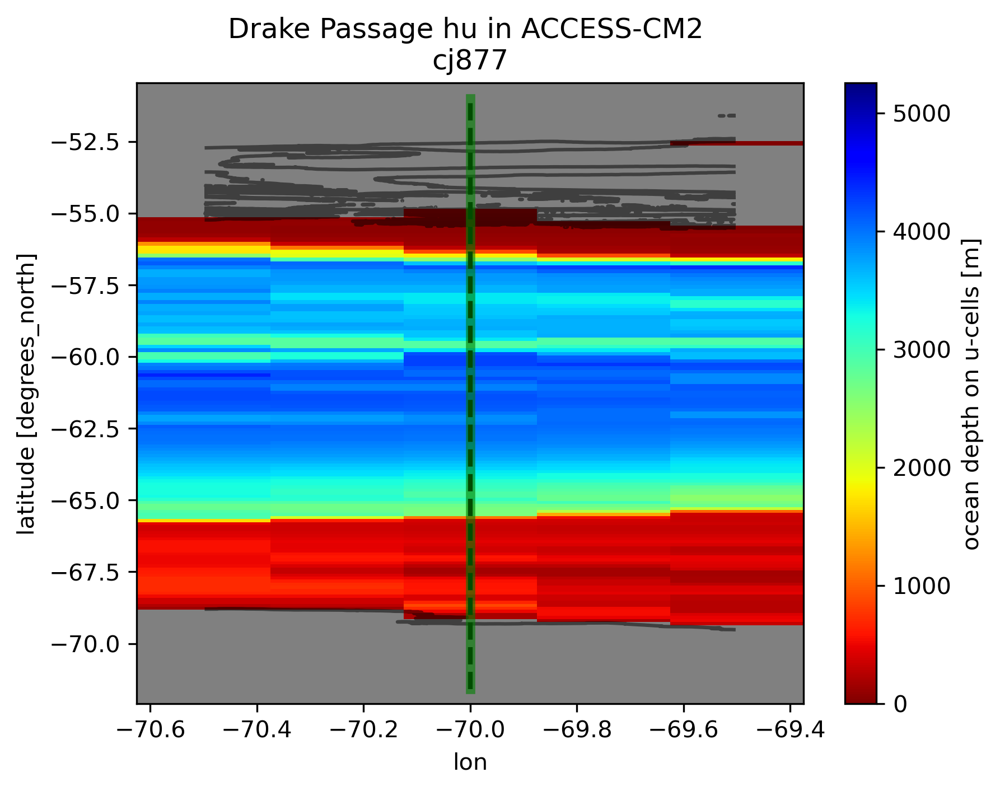

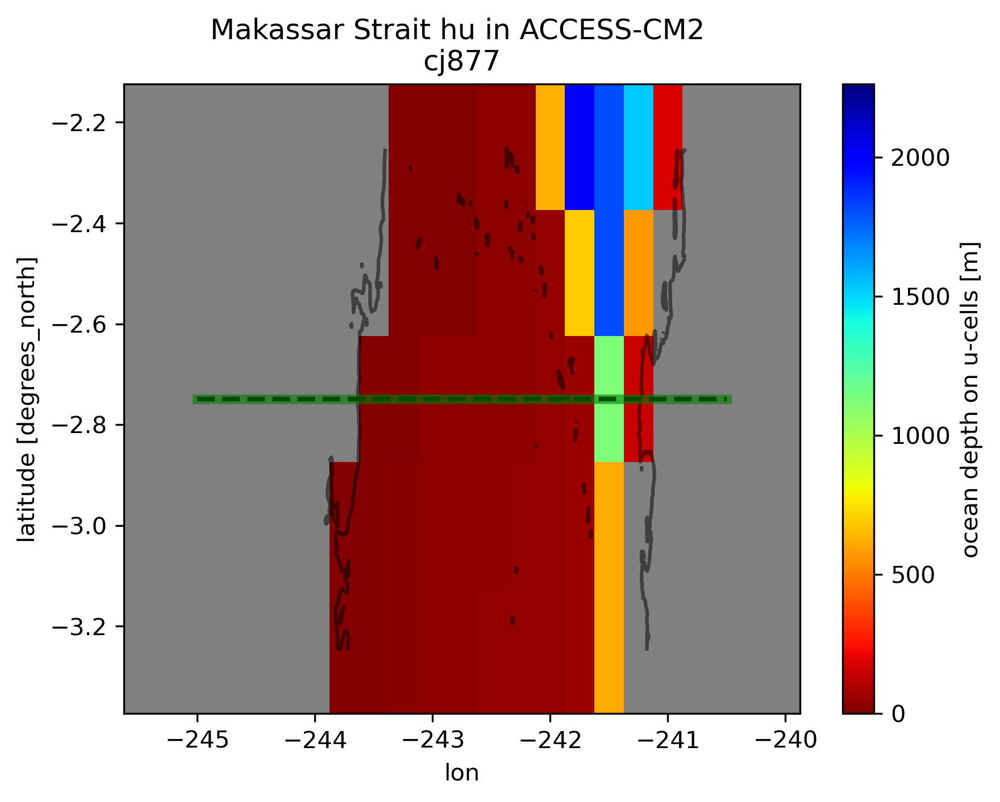

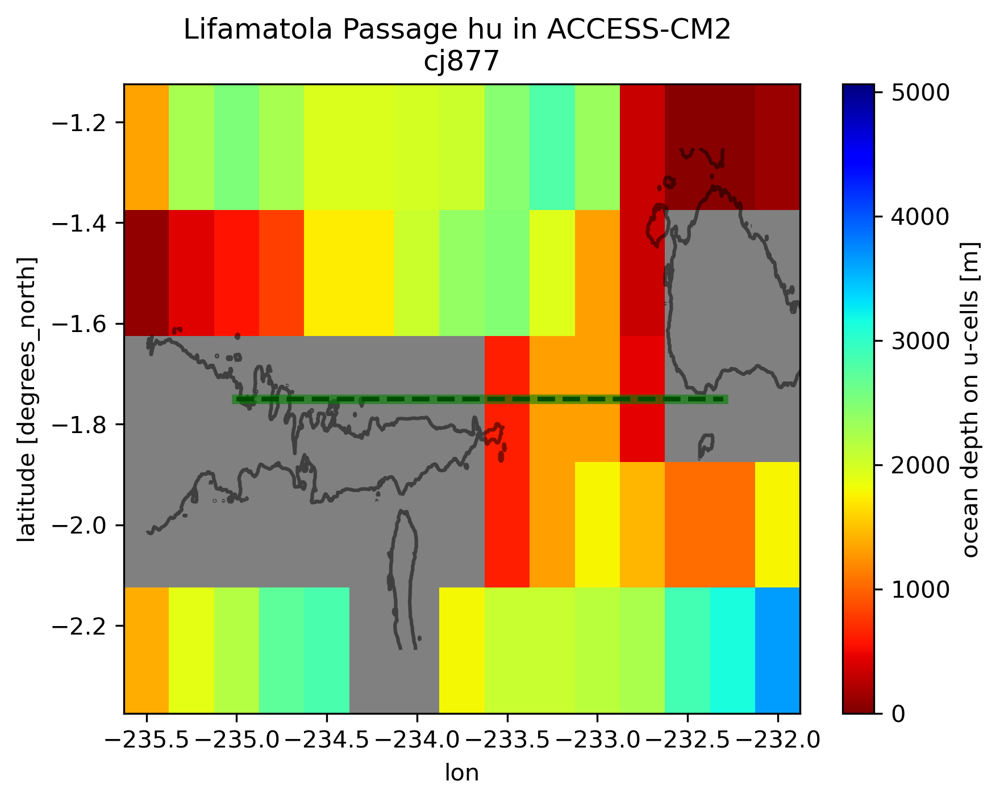

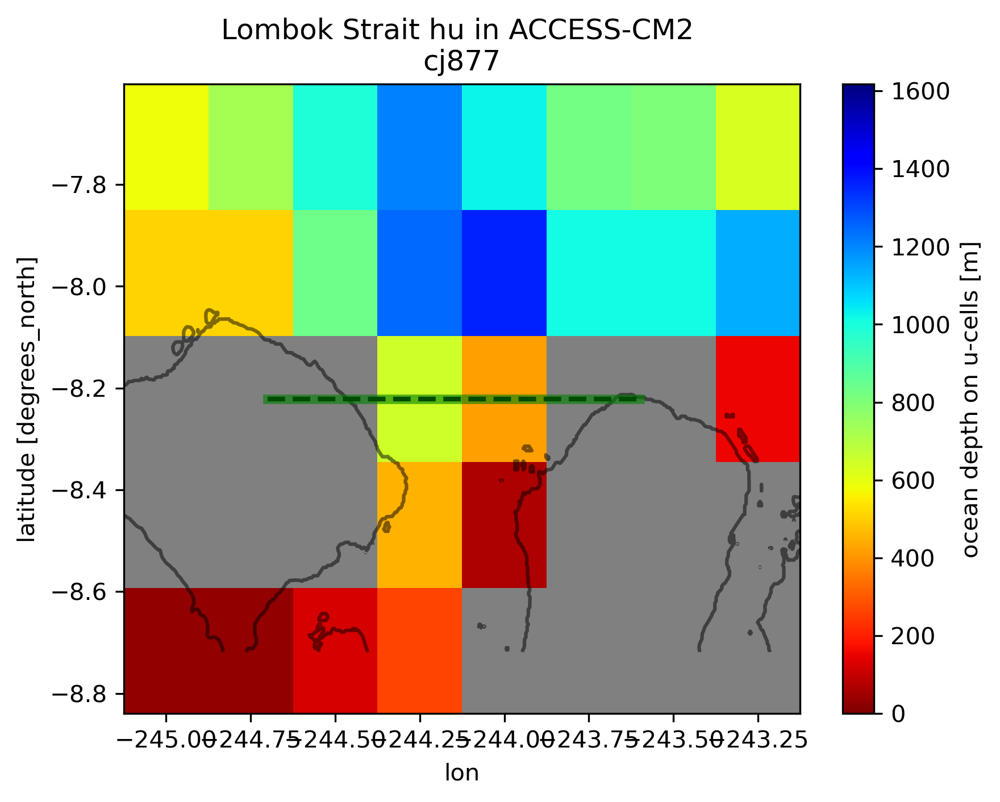

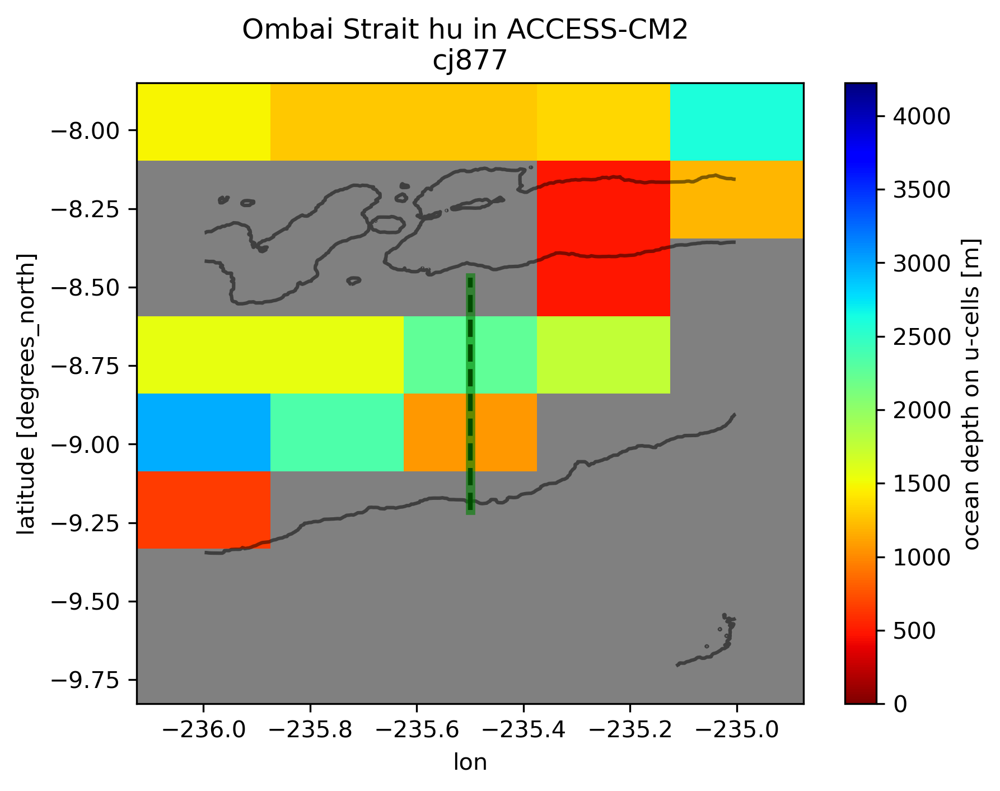

...

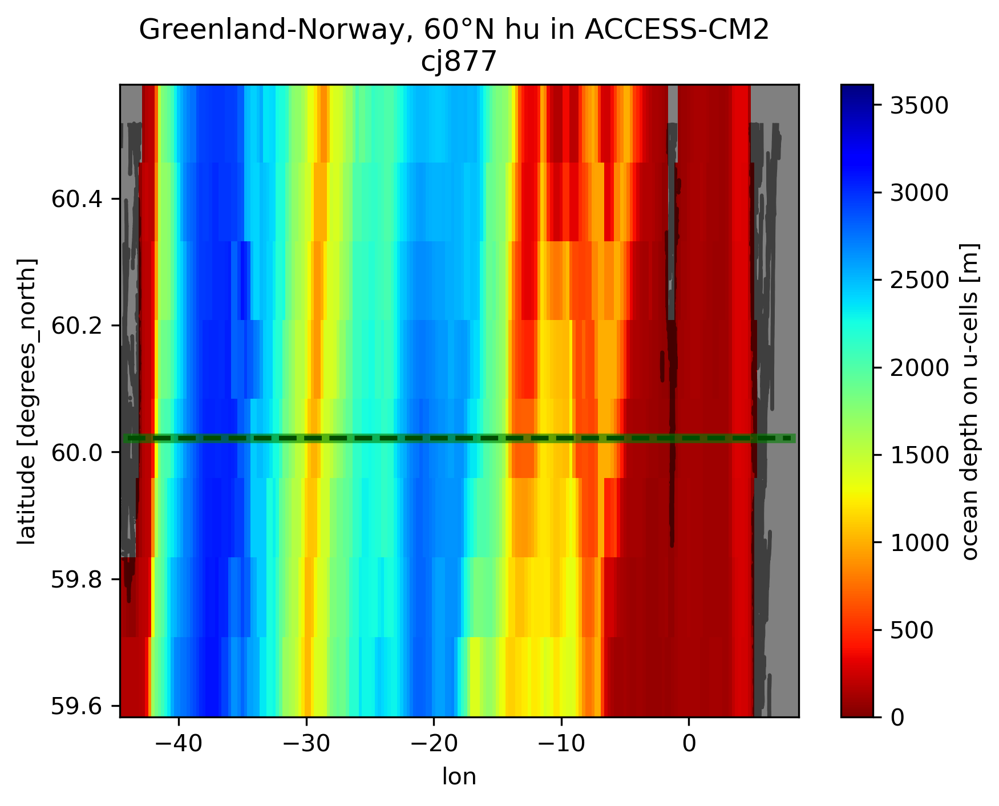

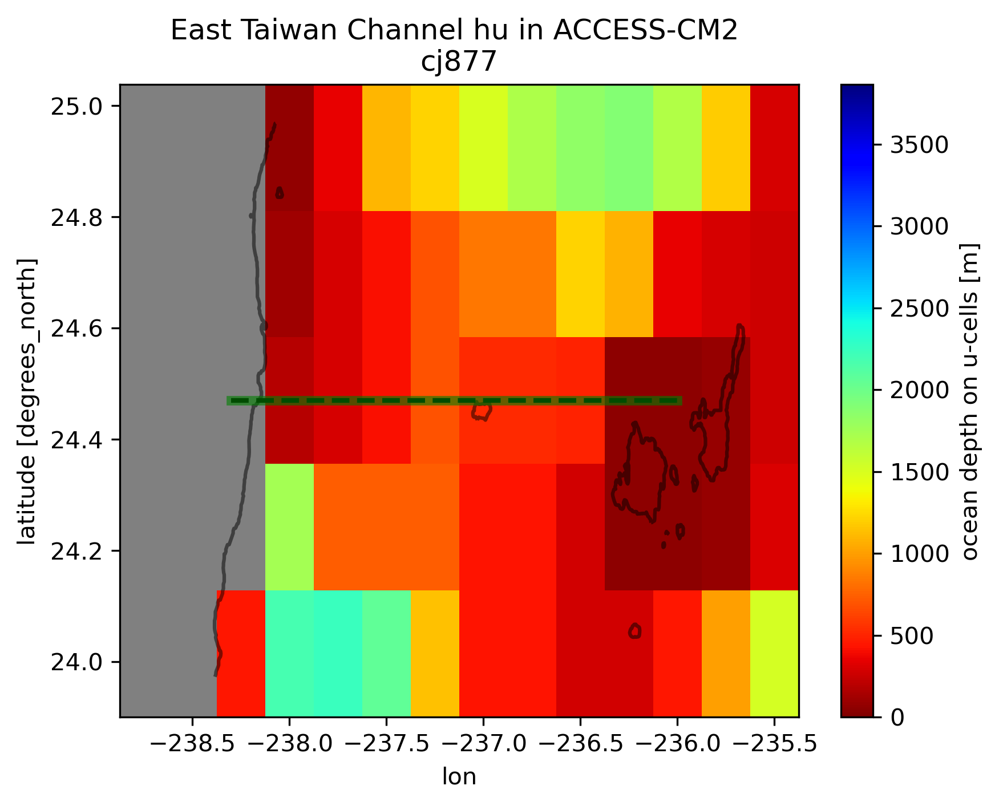

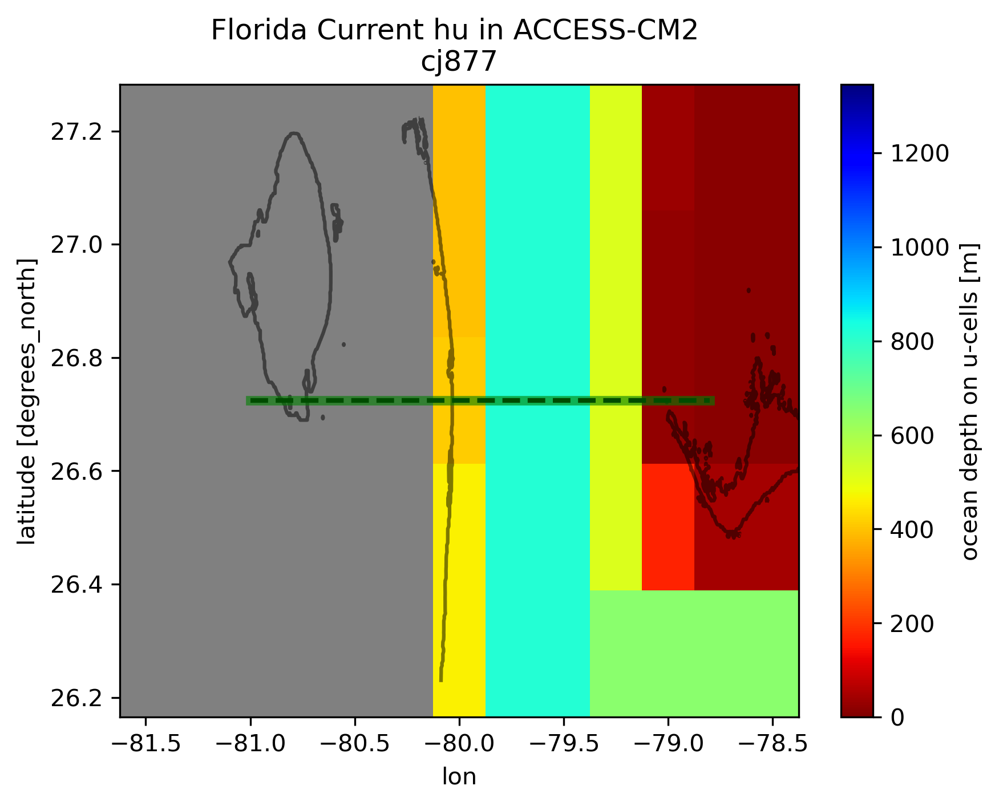

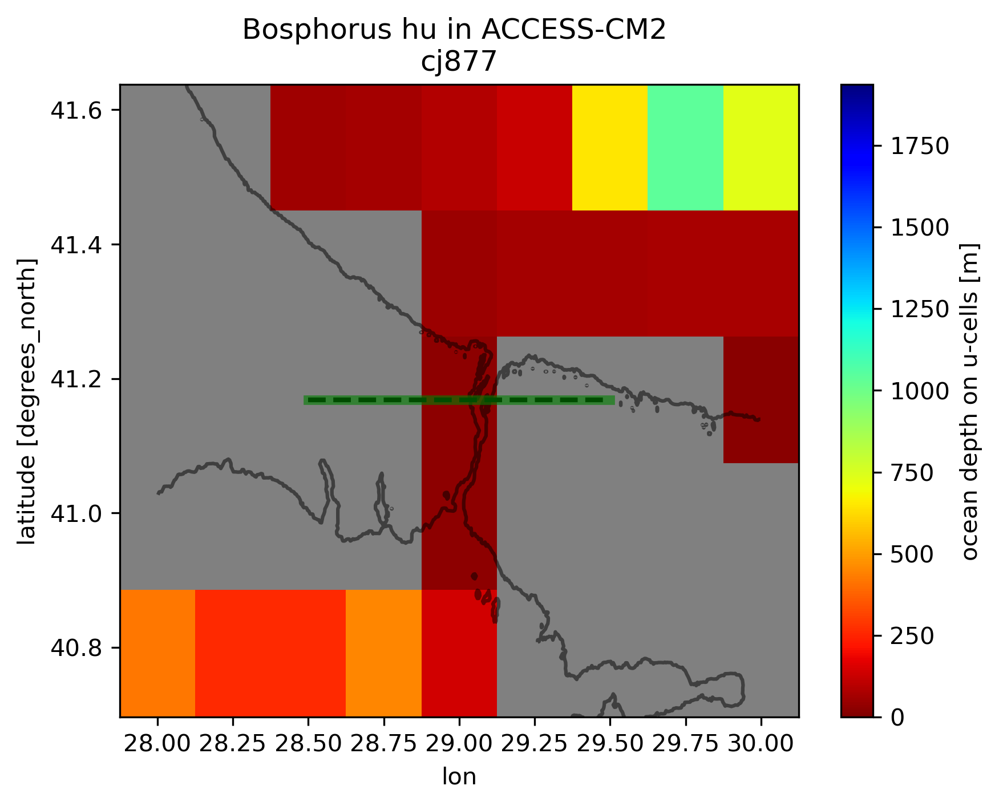

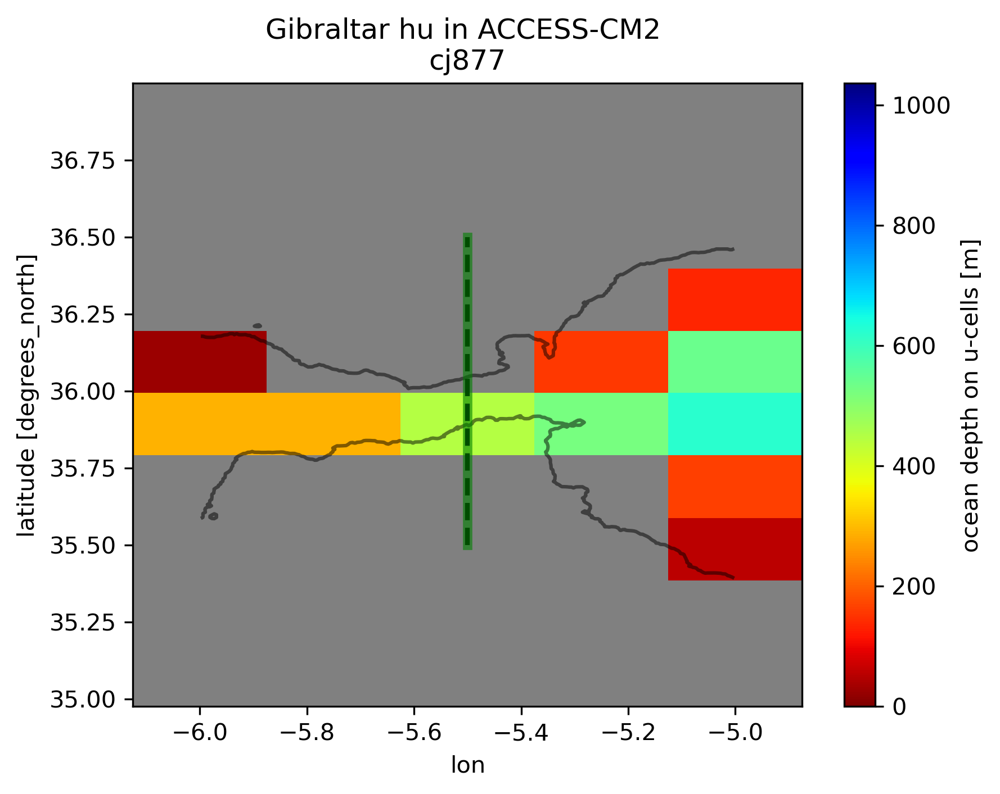

In [44]:
# plot maps of depth at transect locations, with GEBCO coastline
# BUG: GEBCO will be plotted incorrectly in tripolar region
m = 0.5 # margin (degrees)
for strait, (xmin, xmax, ymin, ymax) in om2straits['025deg'].items():
    print(strait)
    fig, ax = plt.subplots(nrows=1, ncols=1)
    ax.set_facecolor('gray')  # gray land points
    h = hu.sel(xu_ocean=slice(xmin-m, xmax+m)).sel(yu_ocean=slice(ymin-m, ymax+m)).load()
    g = -gebco.sel(lon=slice(glon(xmin-m), glon(xmax+m))).sel(lat=slice(ymin-m, ymax+m)).load()
    g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
    h.plot(cmap='jet_r', vmin=0, vmax=g.max())
    g.plot.contour(vmin=0, vmax=0, levels = 1, colors='black', alpha=0.5)
    if xmin == xmax:
        h1 = hu.sel(xu_ocean=xmin, method='nearest').xu_ocean.values
        plt.plot([h1, h1], [ymin, ymax], 'k--', linewidth=2)
    else:
        h1 = hu.sel(yu_ocean=ymin, method='nearest').yu_ocean.values
        plt.plot([xmin, xmax], [h1, h1], 'k--', linewidth=2)
    plt.plot([xmin, xmax], [ymin, ymax], color='green', linewidth=4, alpha=0.6)
    plt.title(f"{strait} {h.name} in {data_name} \n{om2exptname}")

In [35]:
# Align OM2 diagnostic time labels to OM3 calendar just before plotting workflow.
if model_name == "ACCESS-CM3":
    if "time" in tx_trans_int_z.dims and "time" in umo_2d.dims:
        n_om2 = tx_trans_int_z.sizes["time"]
        n_om3 = umo_2d.sizes["time"]
        n_shared = min(n_om2, n_om3)
    
        if n_om2 != n_om3:
            print(f"Aligning OM2/OM3 with last {n_shared} time steps (OM2={n_om2}, OM3={n_om3})")
    
        om3_time_shared = umo_2d.time.isel(time=slice(-n_shared, None))
        tx_trans_int_z = (
            tx_trans_int_z
            .isel(time=slice(-n_shared, None))
            .assign_coords(time=("time", om3_time_shared.values))
            .sortby("time")
        )
        ty_trans_int_z = (
            ty_trans_int_z
            .isel(time=slice(-n_shared, None))
            .assign_coords(time=("time", om3_time_shared.values))
            .sortby("time")
        )
    else:
        print("Skipping OM2/OM3 time alignment: missing 'time' dimension")

Aligning OM2/OM3 with last 600 time steps (OM2=6024, OM3=600)


In [36]:
tx_trans_int_z

<xarray.DataArray 'tx_trans_int_z' (time: 600, yt_ocean: 1080, xu_ocean: 1440)> Size: 4GB
dask.array<getitem, shape=(600, 1080, 1440), dtype=float32, chunksize=(6, 540, 720), chunktype=numpy.ndarray>
Coordinates:
  * time      (time) object 5kB 1981-01-16 12:00:00 ... 2030-12-16 12:00:00
  * yt_ocean  (yt_ocean) float64 9kB -81.08 -80.97 -80.87 ... 89.74 89.84 89.95
  * xu_ocean  (xu_ocean) float64 12kB -279.8 -279.5 -279.2 ... 79.5 79.75 80.0
Attributes:
    long_name:      T-cell i-mass transport vertically summed
    units:          kg/s
    valid_range:    [-1.e+20  1.e+20]
    cell_methods:   time: mean
    time_avg_info:  average_T1,average_T2,average_DT

Drake Passage
Makassar Strait
Lifamatola Passage
Lombok Strait
Ombai Strait
Timor Strait
Leti Strait
Karimata Strait
ITF South
ITF North
Bering Strait
Denmark Strait
North Atlantic, 60°N
Labrador-Greenland, 60°N
Greenland-Norway, 60°N
East Taiwan Channel
Florida Current
Bosphorus
Gibraltar


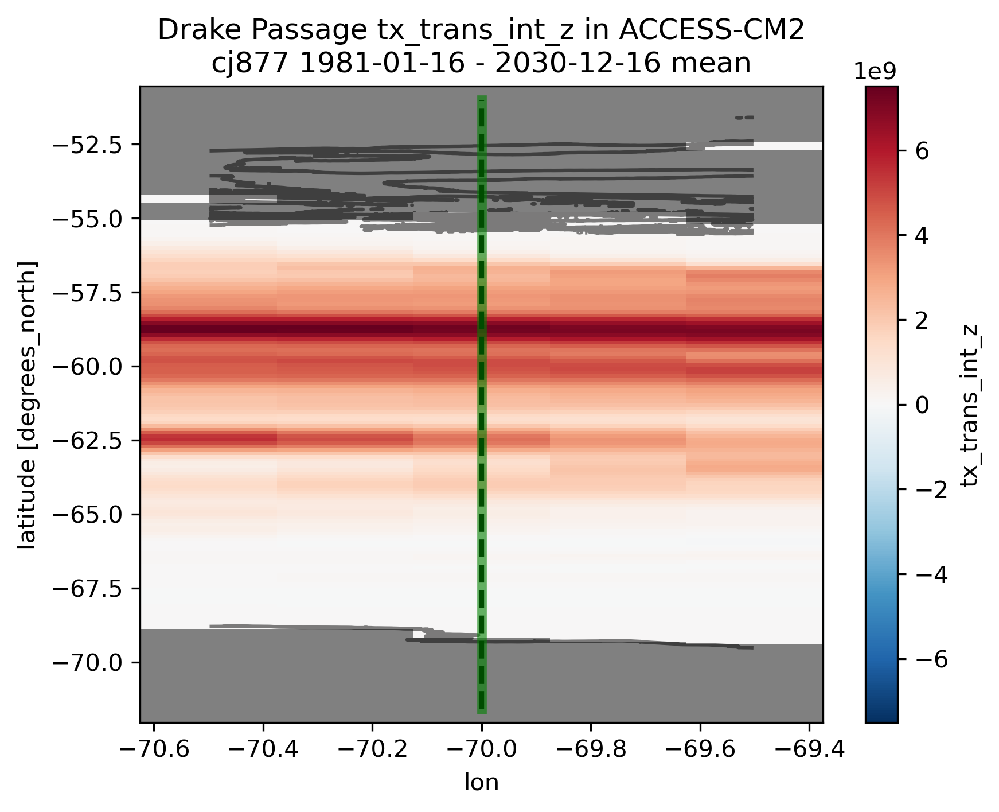

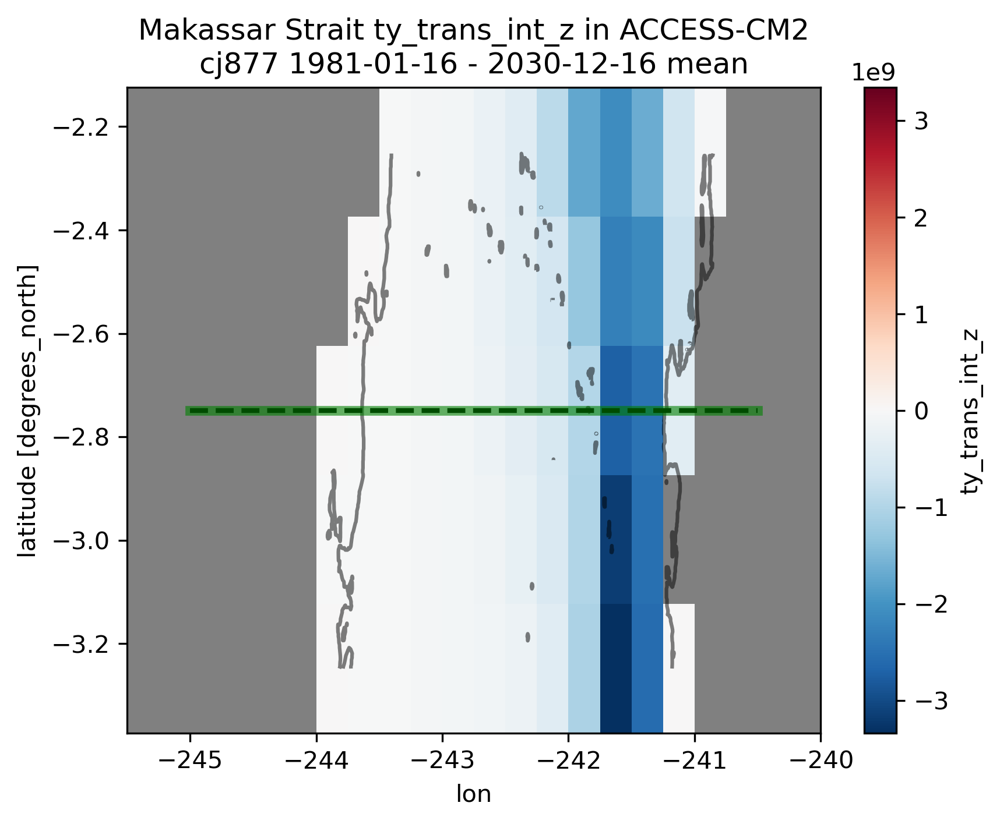

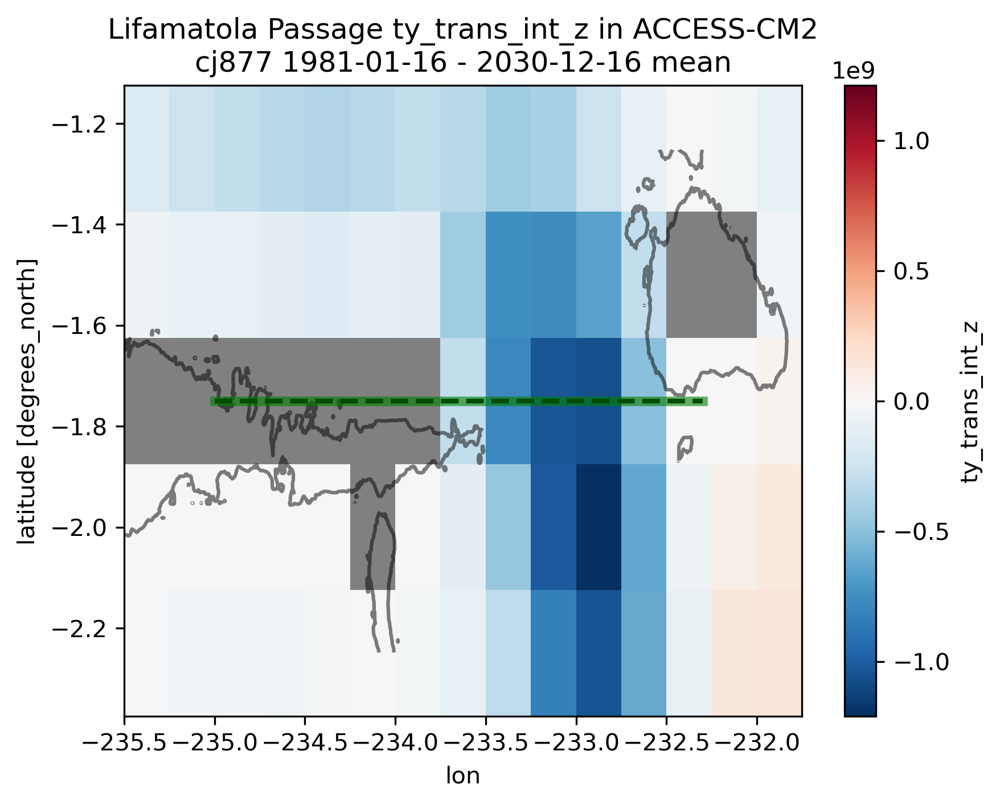

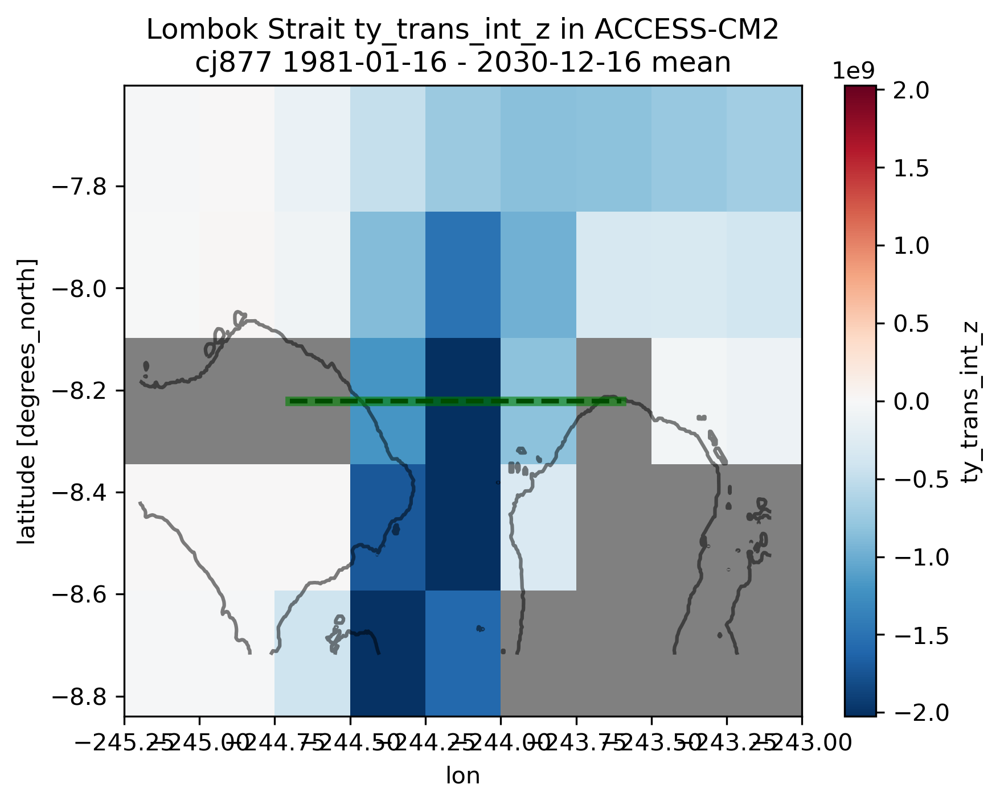

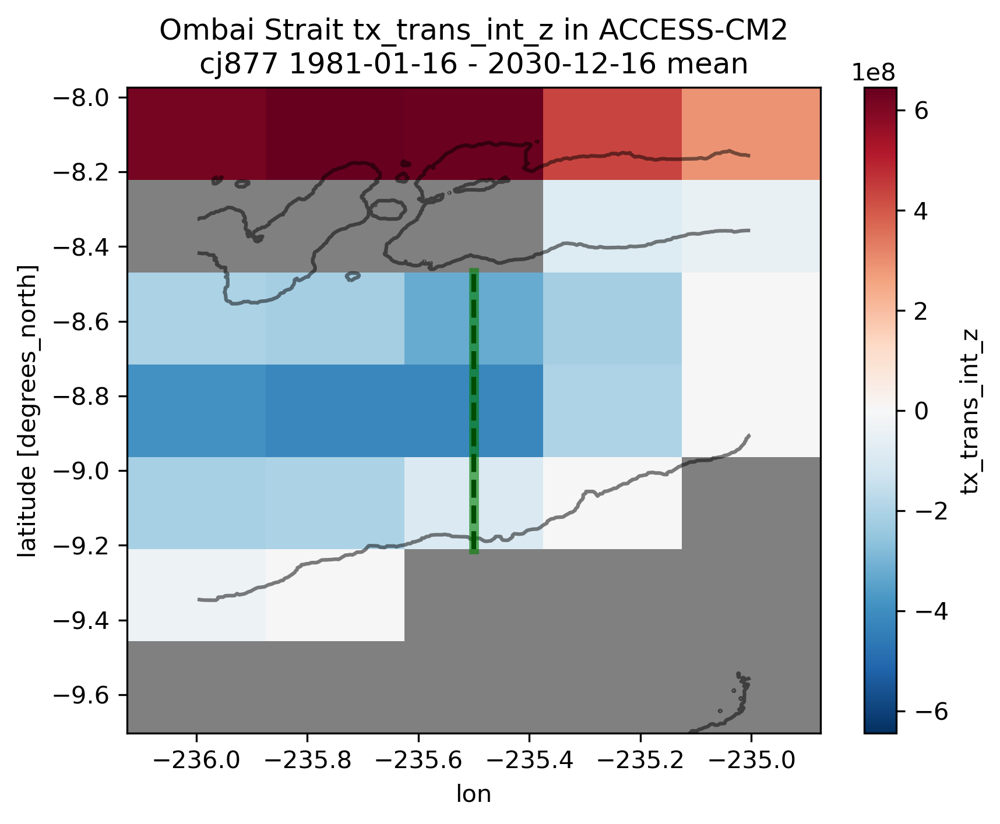

...

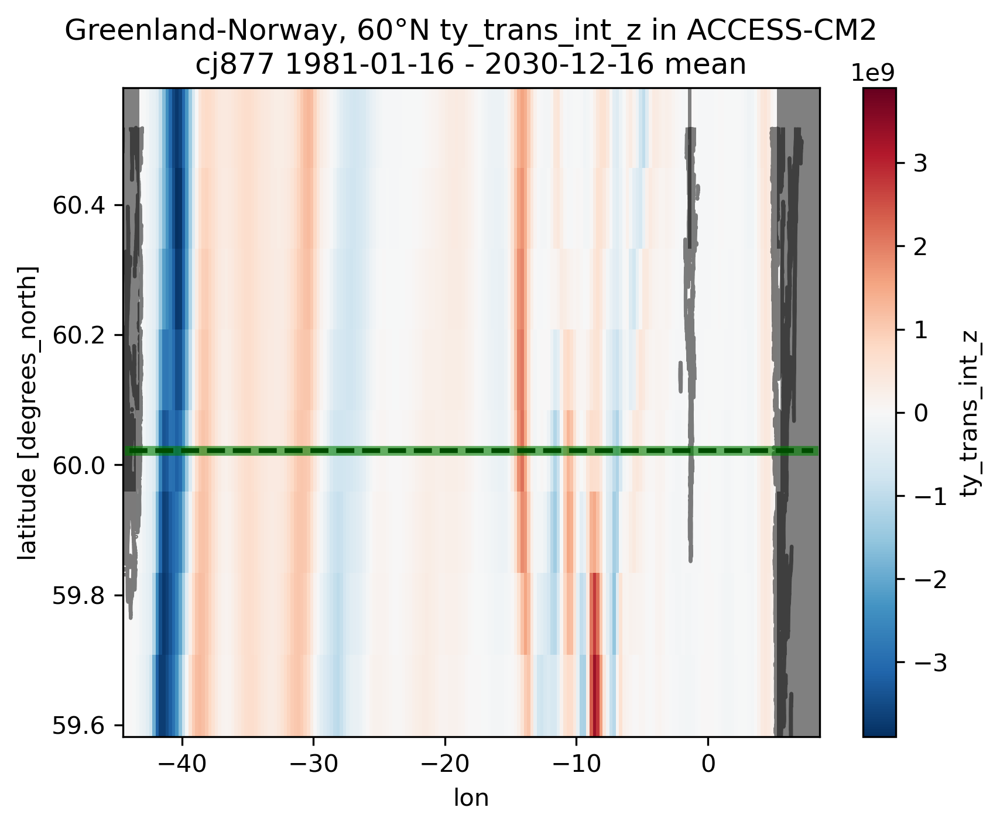

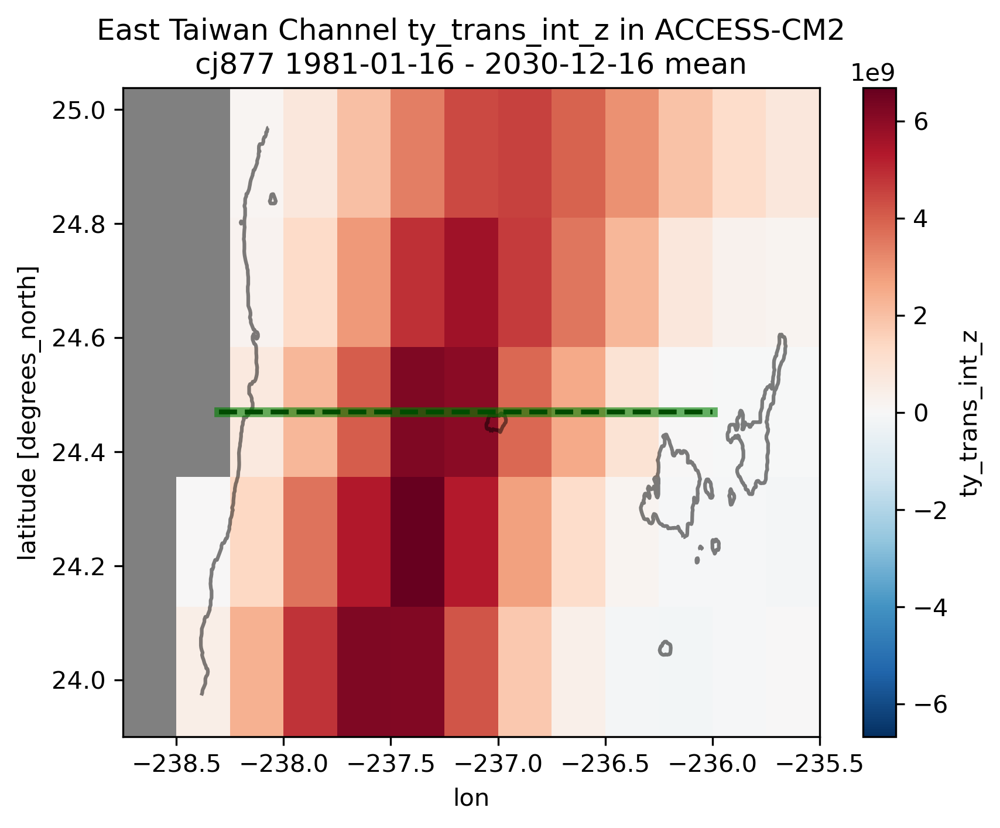

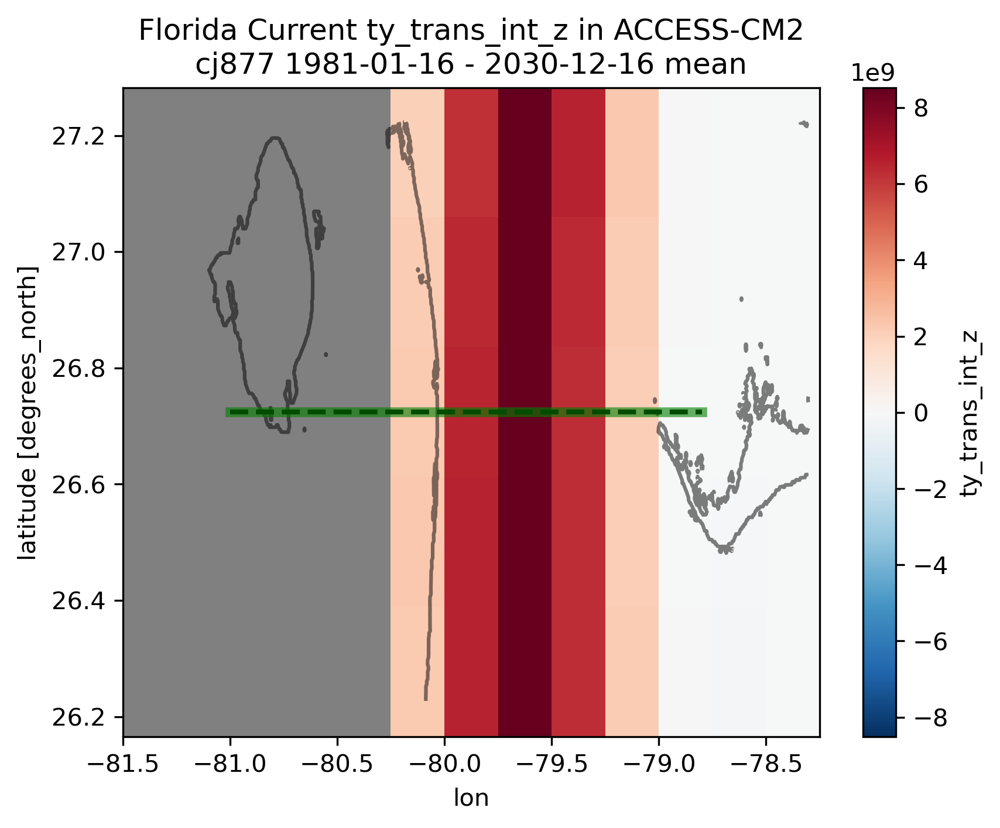

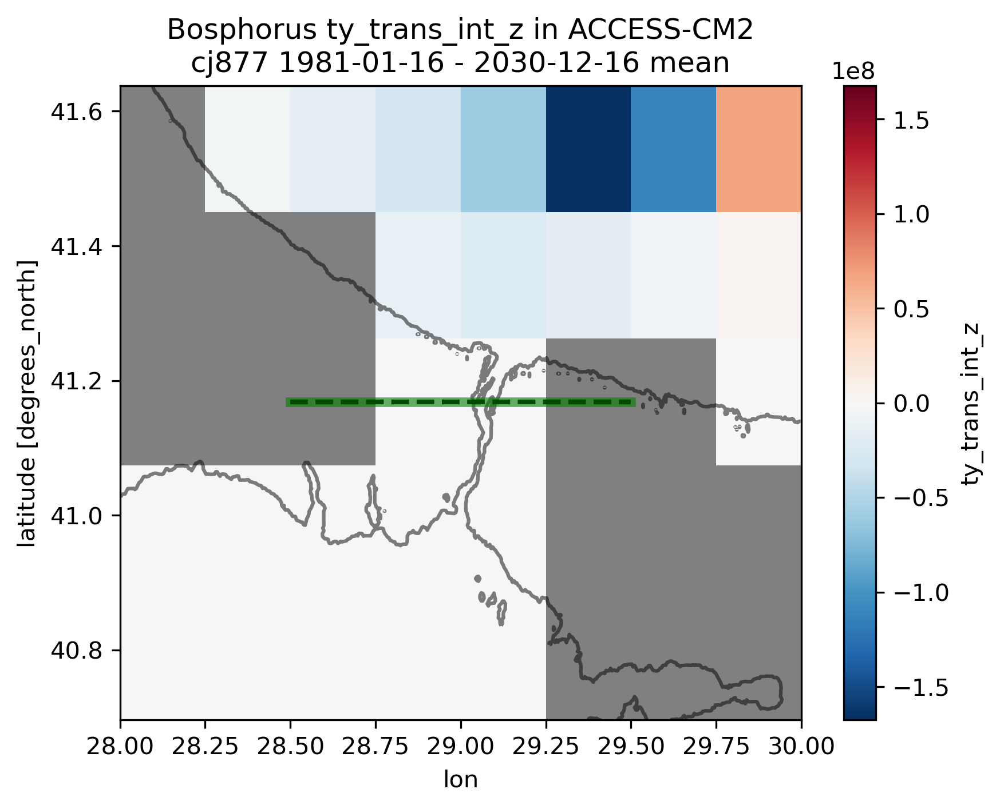

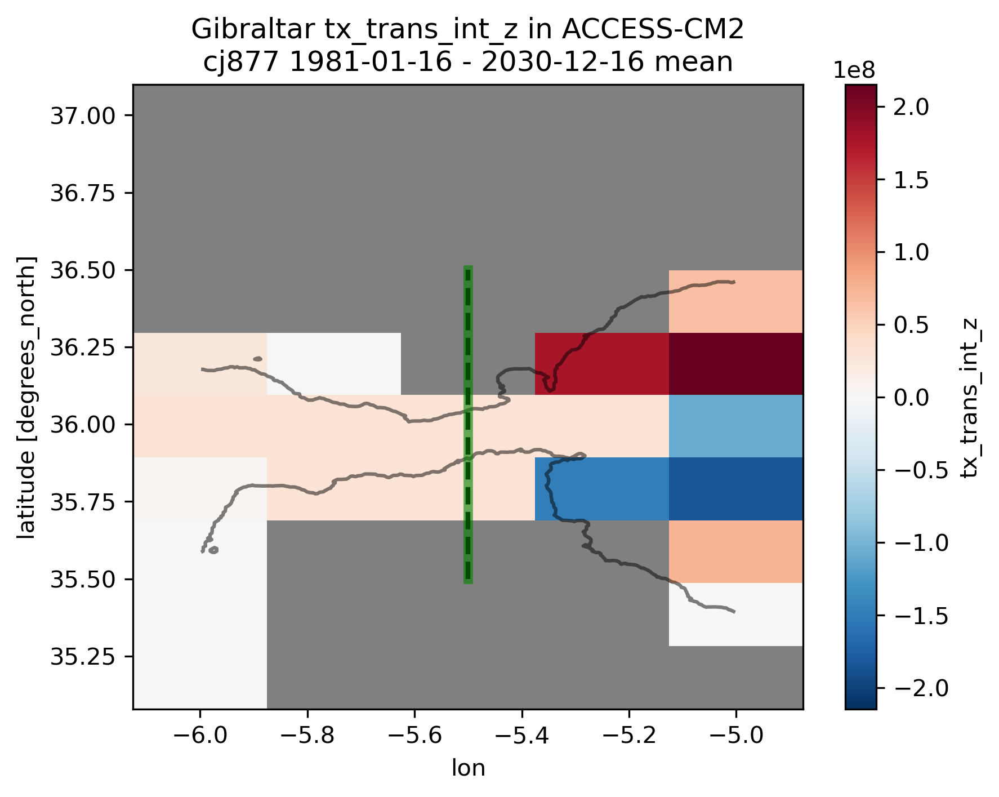

In [45]:
# plot maps of transect locations, with GEBCO coastline
# BUG: GEBCO will be plotted incorrectly in tripolar region
# BUG: GM and submeso transport neglected!
m = 0.5 # margin (degrees)
for strait, (xmin, xmax, ymin, ymax) in om2straits['025deg'].items():
    print(strait)
    fig, ax = plt.subplots(nrows=1, ncols=1)
    ax.set_facecolor('gray')  # gray land points
    if xmin == xmax:
        vel = tx_trans_int_z.sel(time=timeslice).sel(xu_ocean=slice(xmin-m, xmax+m)).sel(yt_ocean=slice(ymin-m, ymax+m))
    else:
        vel = ty_trans_int_z.sel(time=timeslice).sel(xt_ocean=slice(xmin-m, xmax+m)).sel(yu_ocean=slice(ymin-m, ymax+m))
    velmean = vel.mean('time').load()
    velmean.plot()
    g = -gebco.sel(lon=slice(glon(xmin-m), glon(xmax+m))).sel(lat=slice(ymin-m, ymax+m)).load()
    g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
    g.plot.contour(vmin=0, vmax=0, levels = 1, colors='black', alpha=0.5)
    if xmin == xmax:
        h1 = hu.sel(xu_ocean=xmin, method='nearest').xu_ocean.values
        plt.plot([h1, h1], [ymin, ymax], 'k--', linewidth=2)
    else:
        h1 = hu.sel(yu_ocean=ymin, method='nearest').yu_ocean.values
        plt.plot([xmin, xmax], [h1, h1], 'k--', linewidth=2)
    plt.plot([xmin, xmax], [ymin, ymax], color='green', linewidth=4, alpha=0.6)
    plt.title(f"{strait} {vel.name} in {data_name}\n{om2exptname} {vel.time.values[0].strftime('%Y-%m-%d')} - {vel.time.values[-1].strftime('%Y-%m-%d')} mean")

In [38]:
print("  vel sizes:", vel.sizes)
print("  time range:", vel.time.values[:1], vel.time.values[-1:])

  vel sizes: Frozen({'time': 600, 'yt_ocean': 10, 'xu_ocean': 5})
  time range: [cftime.DatetimeProlepticGregorian(1981, 1, 16, 12, 0, 0, 0, has_year_zero=True)] [cftime.DatetimeProlepticGregorian(2030, 12, 16, 12, 0, 0, 0, has_year_zero=True)]


In [39]:
vel

<xarray.DataArray 'tx_trans_int_z' (time: 600, yt_ocean: 10, xu_ocean: 5)> Size: 120kB
dask.array<getitem, shape=(600, 10, 5), dtype=float32, chunksize=(6, 10, 5), chunktype=numpy.ndarray>
Coordinates:
  * time      (time) object 5kB 1981-01-16 12:00:00 ... 2030-12-16 12:00:00
  * yt_ocean  (yt_ocean) float64 80B 35.18 35.38 35.59 35.79 ... 36.6 36.8 37.0
  * xu_ocean  (xu_ocean) float64 40B -6.0 -5.75 -5.5 -5.25 -5.0
Attributes:
    long_name:      T-cell i-mass transport vertically summed
    units:          kg/s
    valid_range:    [-1.e+20  1.e+20]
    cell_methods:   time: mean
    time_avg_info:  average_T1,average_T2,average_DT

## Plot OM2 transects

In [40]:
# Align OM2 diagnostic time labels to OM3 calendar just before plotting workflow.
if model_name == "ACCESS-CM3":
    if "time" in u.dims and "time" in uo.dims:
        n_om2 = u.sizes["time"]
        n_om3 = uo.sizes["time"]
        n_shared = min(n_om2, n_om3)
    
        if n_om2 != n_om3:
            print(f"Aligning OM2/OM3 with last {n_shared} time steps (OM2={n_om2}, OM3={n_om3})")
    
        om3_time_shared = uo.time.isel(time=slice(-n_shared, None))
        u = (
            u
            .isel(time=slice(-n_shared, None))
            .assign_coords(time=("time", om3_time_shared.values))
            .sortby("time")
        )
        v = (
            v
            .isel(time=slice(-n_shared, None))
            .assign_coords(time=("time", om3_time_shared.values))
            .sortby("time")
        )
    else:
        print("Skipping OM2/OM3 time alignment: missing 'time' dimension")

Aligning OM2/OM3 with last 600 time steps (OM2=6024, OM3=600)


Drake Passage
Makassar Strait
Lifamatola Passage
Lombok Strait
Ombai Strait
Timor Strait
Leti Strait
Karimata Strait
ITF South
ITF North
Bering Strait
Denmark Strait
North Atlantic, 60°N
Labrador-Greenland, 60°N
Greenland-Norway, 60°N
East Taiwan Channel
Florida Current
Bosphorus
Gibraltar


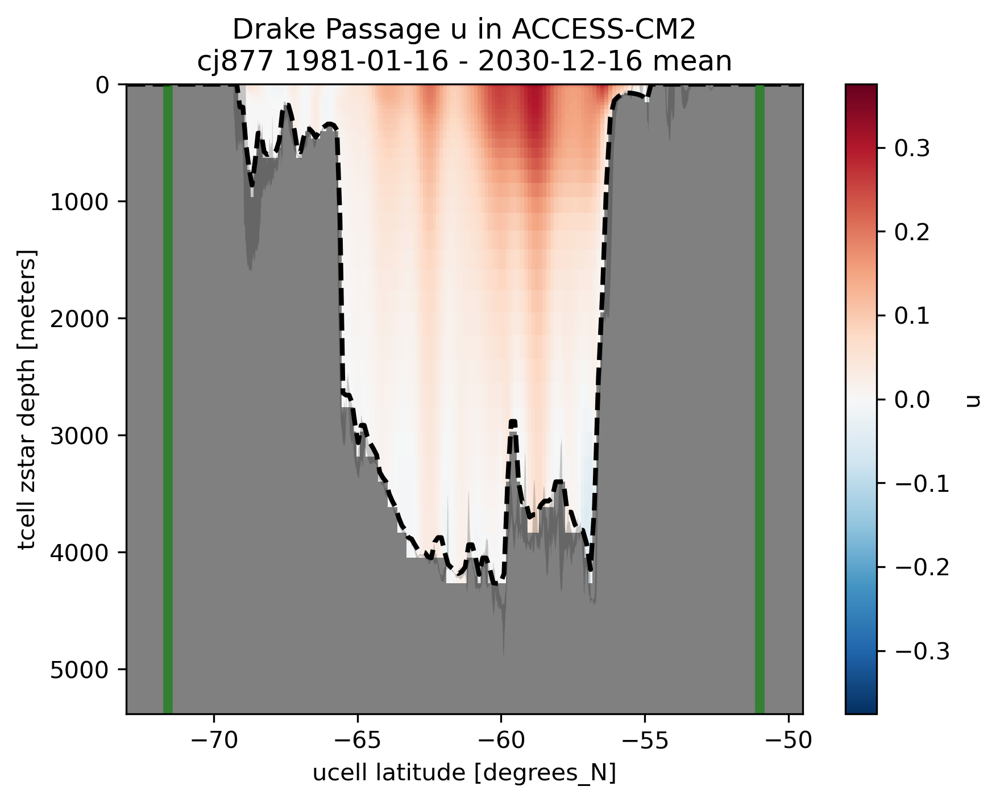

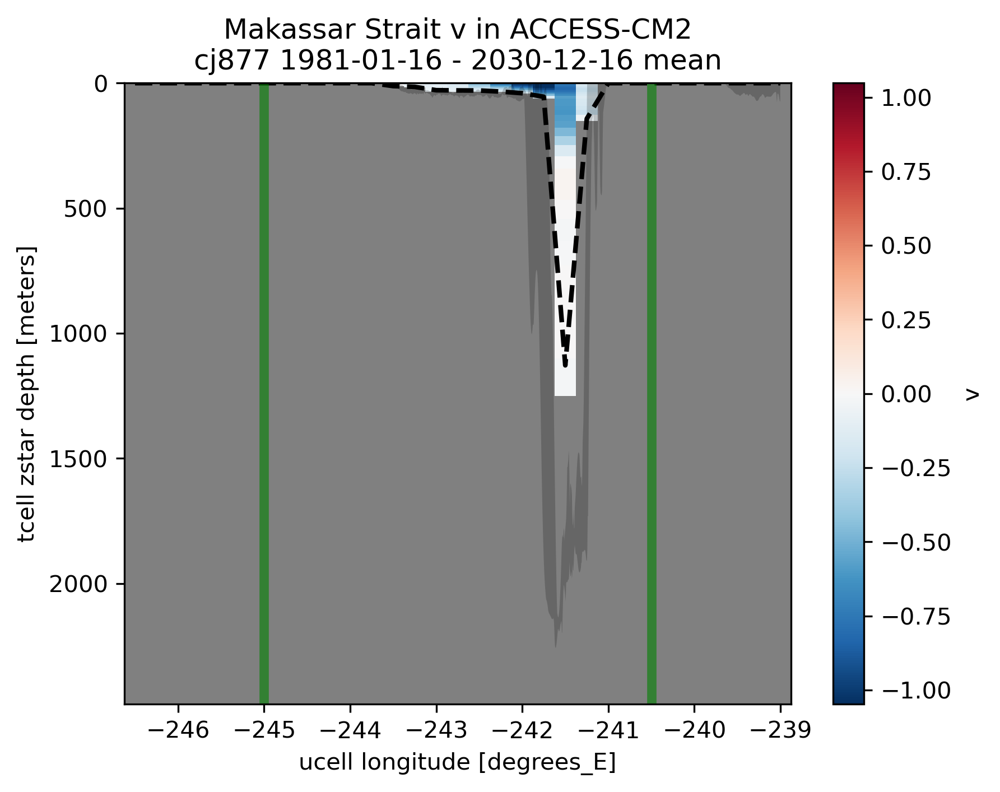

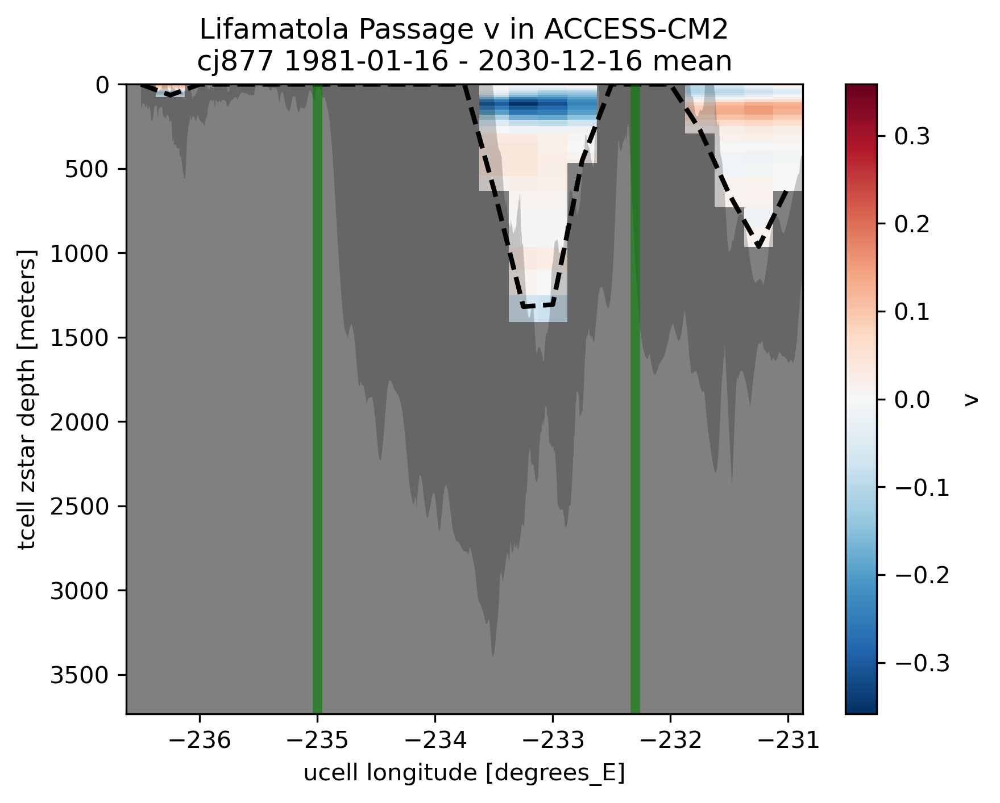

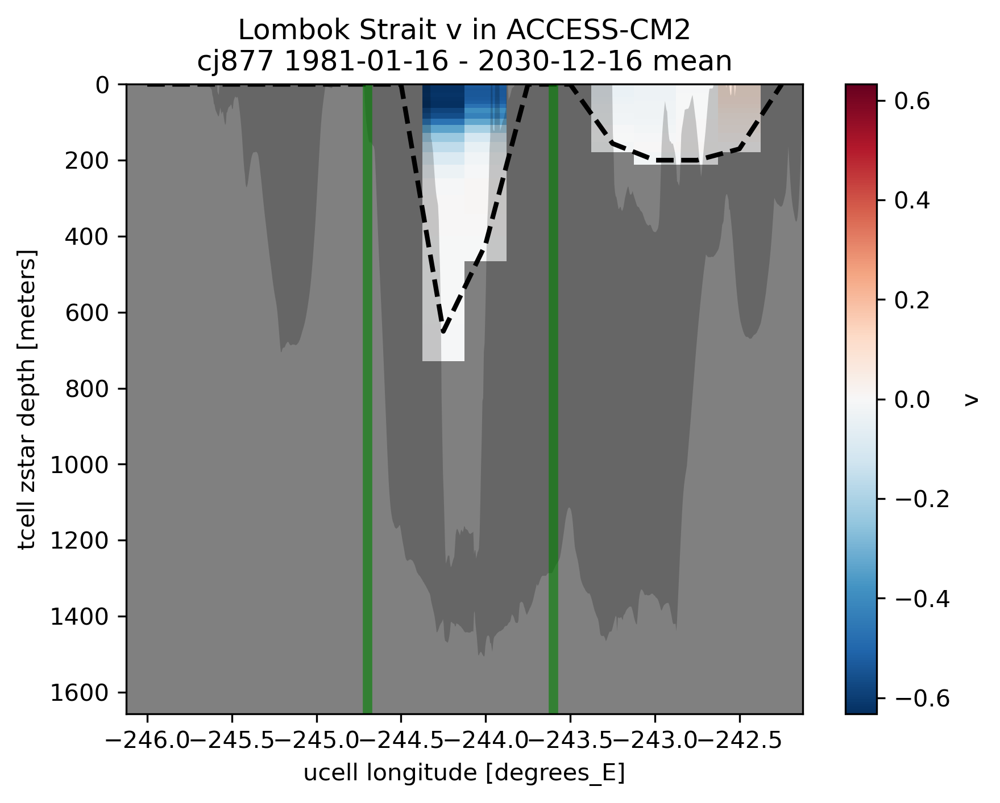

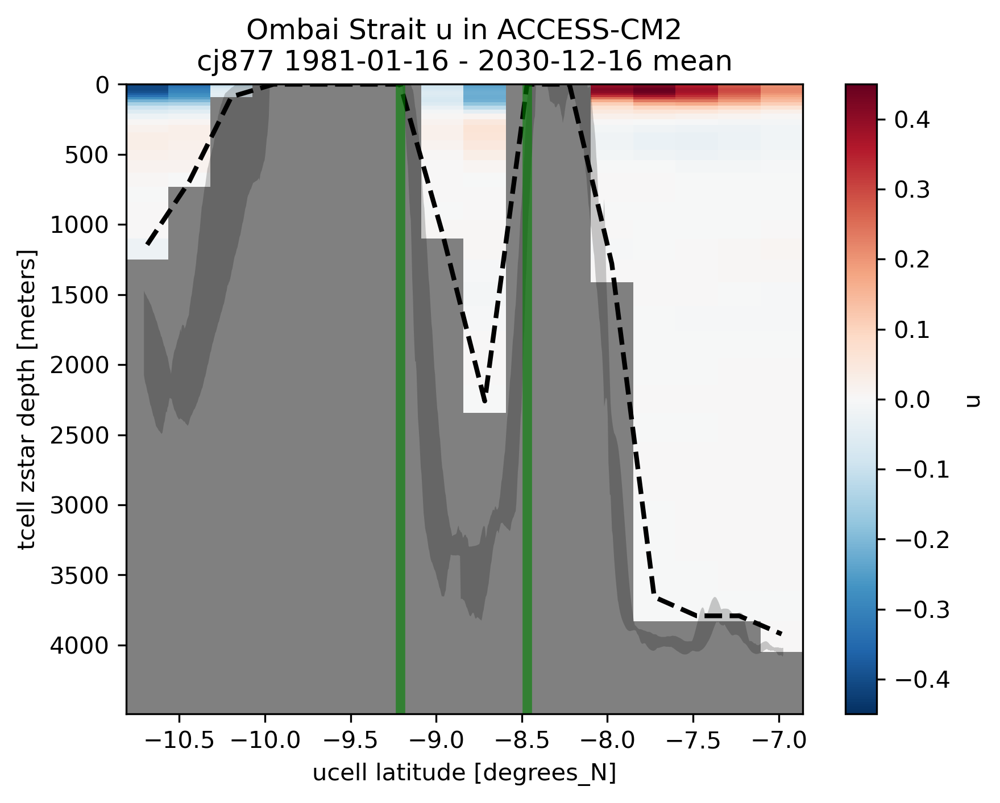

...

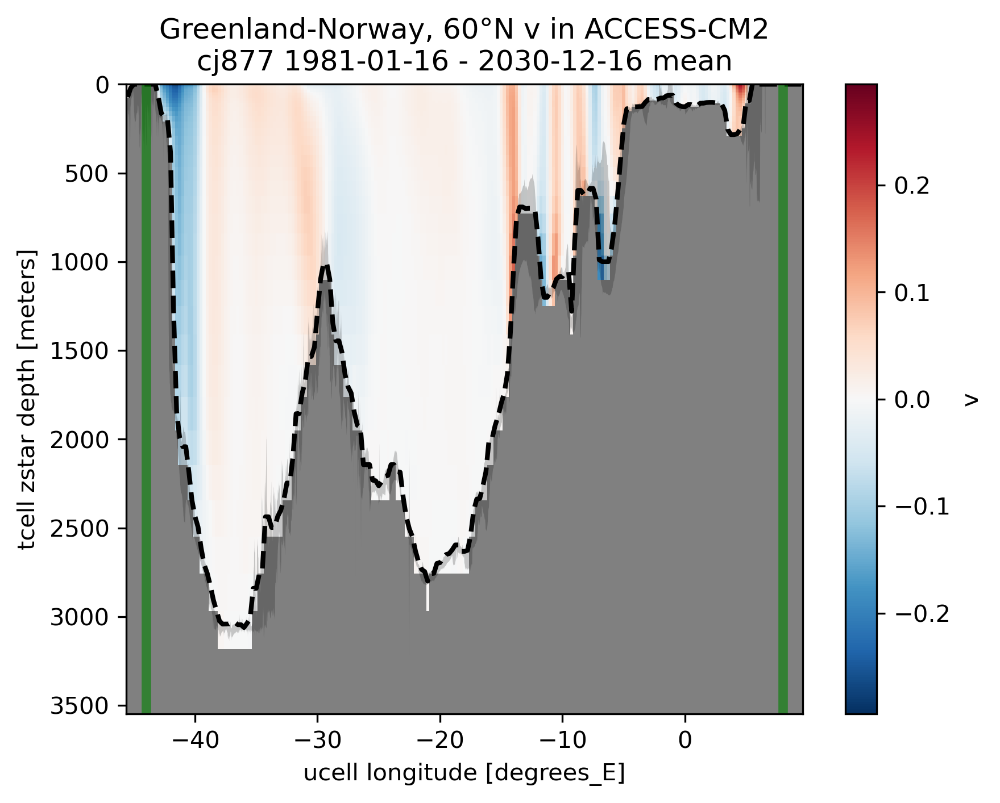

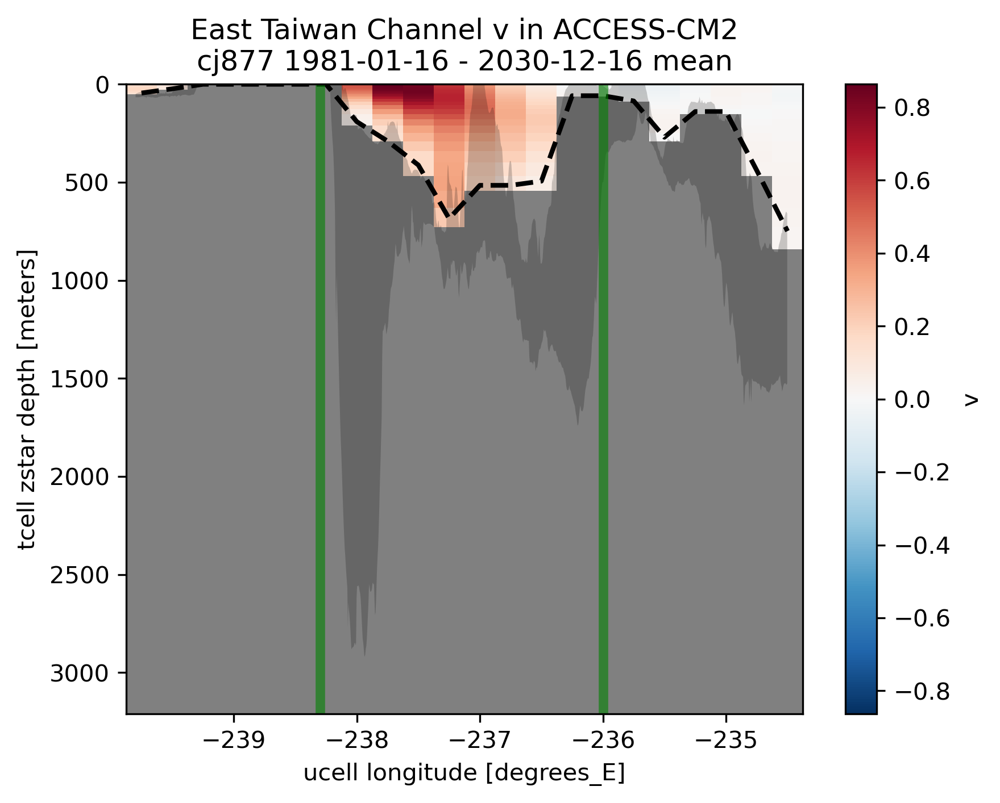

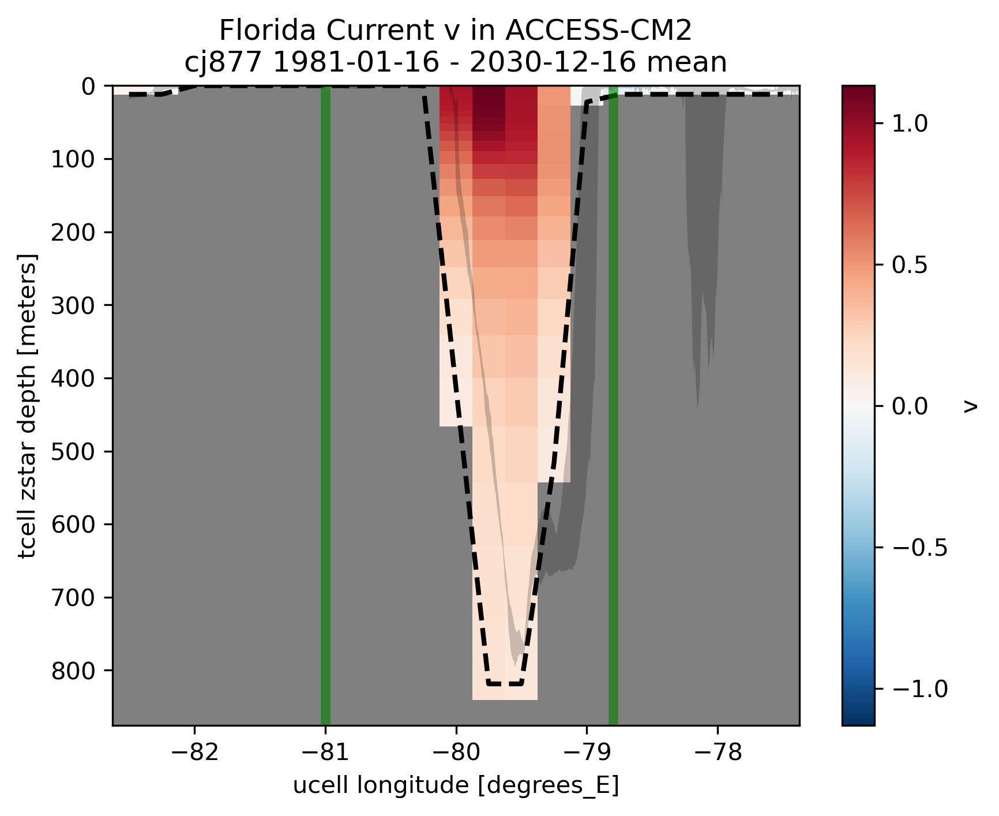

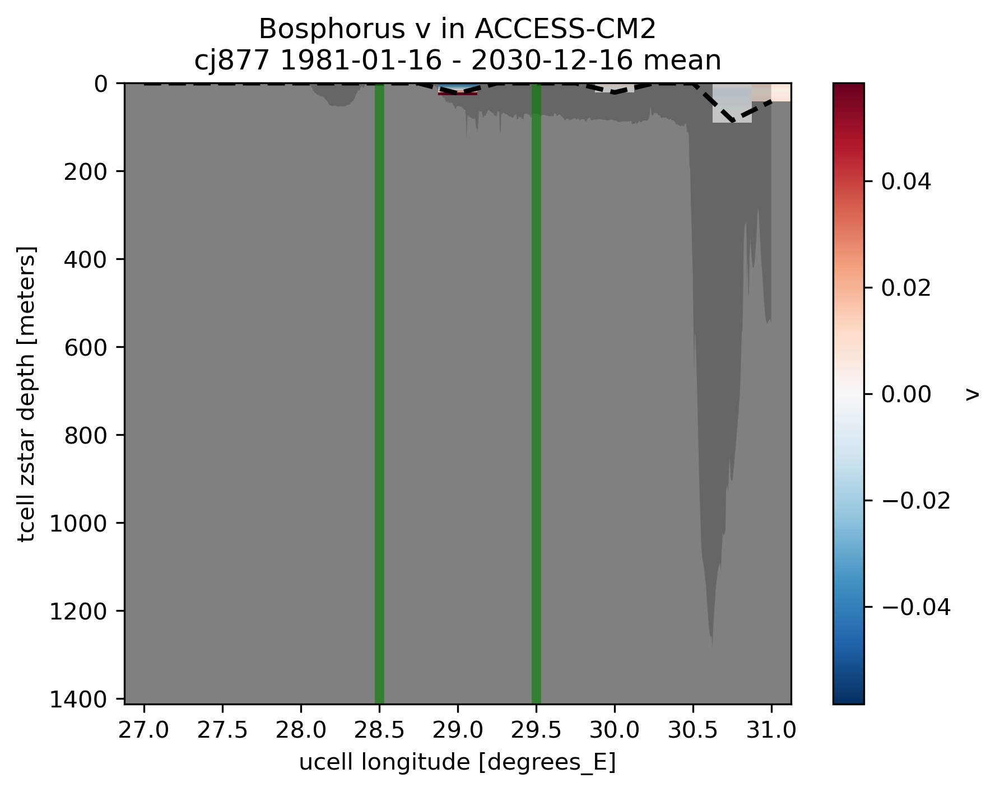

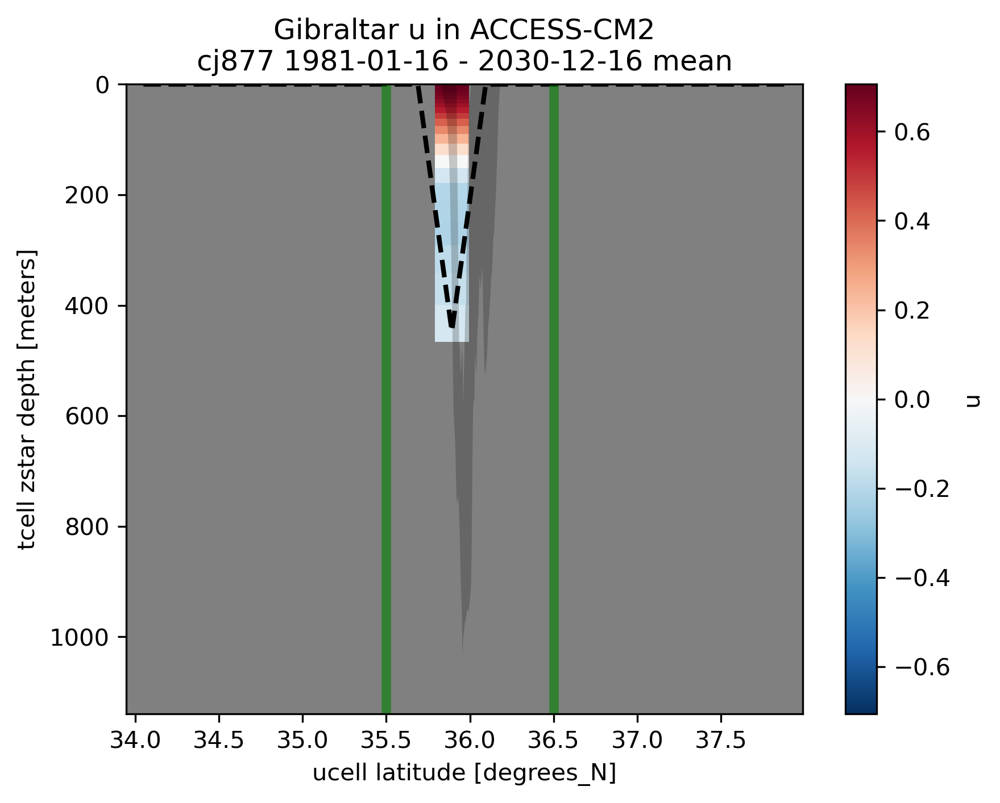

In [47]:
# plot vertical slices at transect locations, with range of GEBCO bathymetry over grid cell width
# BUG: GEBCO will be plotted incorrectly in tripolar region
# BUG: GM and submeso transport neglected!
m = 1.5  # margin (degrees)
res = 0.25  # nominal grid resolution (degrees) - BUG: too large in latitude except at equator
for strait, (xmin, xmax, ymin, ymax) in om2straits['025deg'].items():
    print(strait)
    fig, ax = plt.subplots(nrows=1, ncols=1)
    ax.set_facecolor('gray')  # gray land points
    if xmin == xmax:
        vel = u.sel(time=timeslice).sel(xu_ocean=xmin, method='nearest').sel(yu_ocean=slice(ymin-m, ymax+m))
        velmean = vel.mean('time').load()
        velmean.plot()
        g = -gebco.sel(lon=slice(glon(vel.xu_ocean.values-res/2), glon(vel.xu_ocean.values+res/2))).sel(lat=slice(ymin-m, ymax+m)).load()
        g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
        plt.gca().fill_between(g.lat.values, g.min(dim='lon'), g.max(dim='lon'), color='black', edgecolor=None, alpha=0.2)
        h1 = hu.sel(xu_ocean=vel.xu_ocean.values, method='nearest').sel(yu_ocean=slice(ymin-m, ymax+m))
        plt.plot(h1.yu_ocean, h1.fillna(0), 'k--', linewidth=2)
        zlim = 2*plt.gca().get_ylim()[1]
        plt.plot([ymin, ymin, ymax, ymax], [0, zlim, zlim, 0], color='green', linewidth=4, alpha=0.6)
    else:
        vel = v.sel(time=timeslice).sel(xu_ocean=slice(xmin-m, xmax+m)).sel(yu_ocean=ymin, method='nearest')
        velmean = vel.mean('time').load()
        velmean.plot()
        g = -gebco.sel(lon=slice(glon(xmin-m), glon(xmax+m))).sel(lat=slice(vel.yu_ocean.values-res/2, vel.yu_ocean.values+res/2)).load()
        g.coords['lon'] = np.vectorize(mlon)(g.lon.values)
        plt.gca().fill_between(g.lon.values, g.min(dim='lat'), g.max(dim='lat'), color='black', edgecolor=None, alpha=0.2)
        h1 = hu.sel(xu_ocean=slice(xmin-m, xmax+m)).sel(yu_ocean=vel.yu_ocean.values, method='nearest')
        plt.plot(h1.xu_ocean, h1.fillna(0), 'k--', linewidth=2)
        zlim = 2*plt.gca().get_ylim()[1]
        plt.plot([xmin, xmin, xmax, xmax], [0, zlim, zlim, 0], color='green', linewidth=4, alpha=0.6)
    plt.gca().set_ylim([None, 1.1*np.max(g)])
    plt.gca().invert_yaxis()
    plt.title(f"{strait} {vel.name} in {data_name}\n{om2exptname} {vel.time.values[0].strftime('%Y-%m-%d')} - {vel.time.values[-1].strftime('%Y-%m-%d')} mean")

### Plot OM3 and OM2 timeseries

#### BUG: OM2 GM and submeso transport neglected!


| Strait | ACCESS-CM2 | ACCESS-CM3 | Obs |
| ------ | --: | --: | --: |
| Drake Passage | 211.64 | 205.35 | 173.30 |
| Makassar Strait | -7.57 | -7.85 | -11.60 |
| Lifamatola Passage | -3.56 | -2.41 | -1.40 |
| Lombok Strait | -3.91 | -2.21 | -2.60 |
| Ombai Strait | -0.81 | -1.13 | -4.90 |
| Timor Strait | -3.11 | -1.69 | -7.50 |
| Leti Strait | -3.99 | -0.94 |  --  |
| Karimata Strait | 0.55 | 0.37 |  --  |
| ITF South | -9.99 | -11.82 |  --  |
| ITF North | -9.36 | -11.39 |  --  |
| Bering Strait | 1.07 | 0.91 | 1.00 |
| Denmark Strait | -4.15 | -3.73 |  --  |
| East Taiwan Channel | 25.64 | 32.90 | 21.50 |
| Florida Current | 24.76 | 22.52 | 32.10 |
| Bosphorus | -0.00 | -0.00 |  --  |
| Gibraltar | 0.06 | 0.03 |  --  |
| Labrador-Greenland, 60°N | -1.26 | -1.55 |  --  |
| Greenland-Norway, 60°N | -0.05 | 0.47 |  --  |


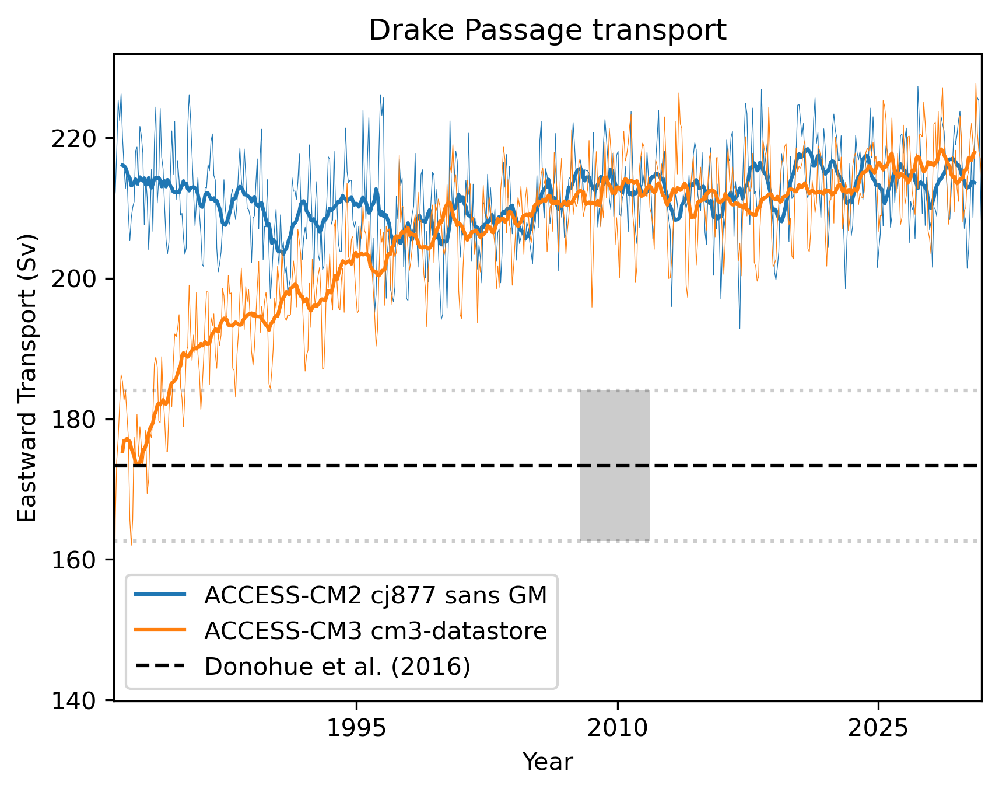

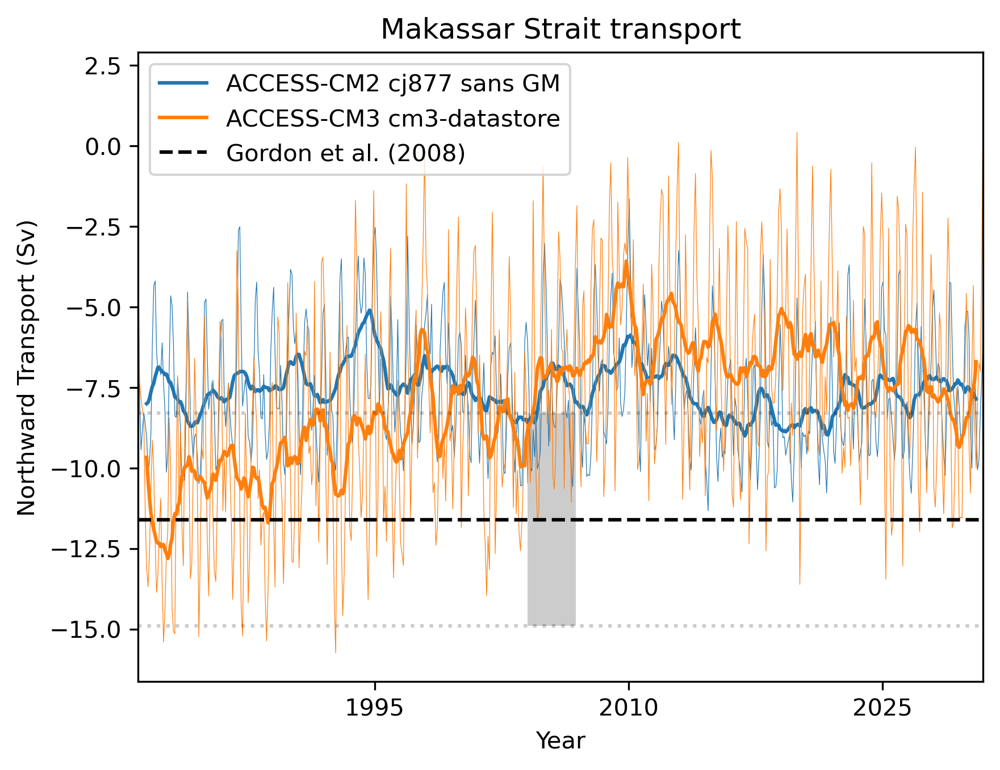

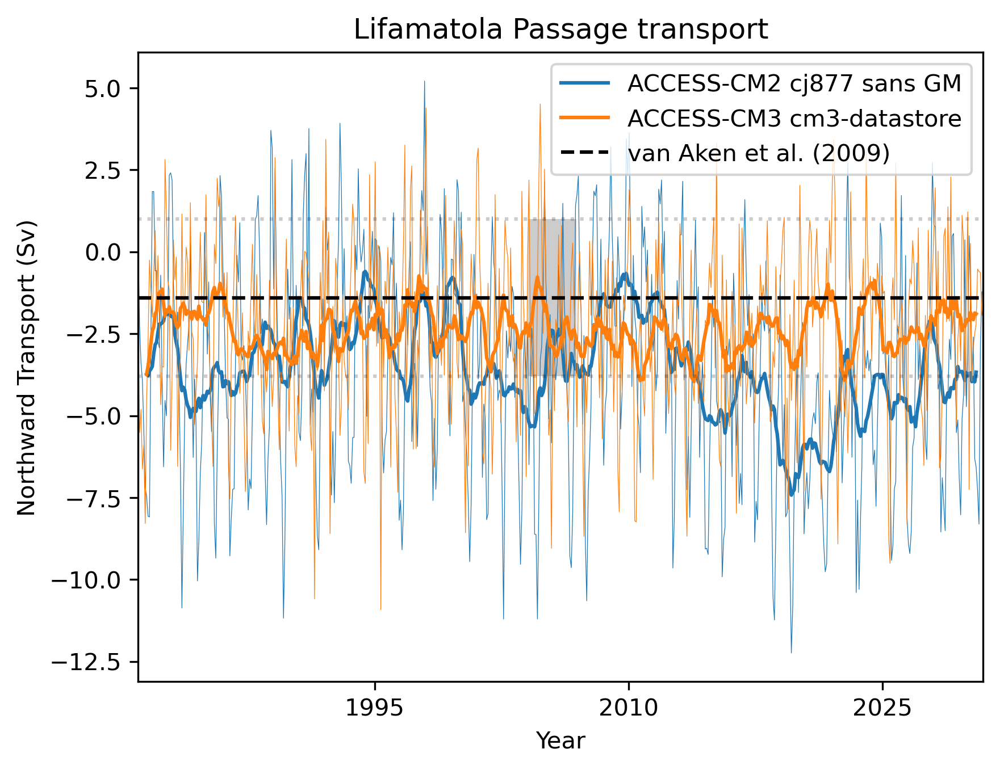

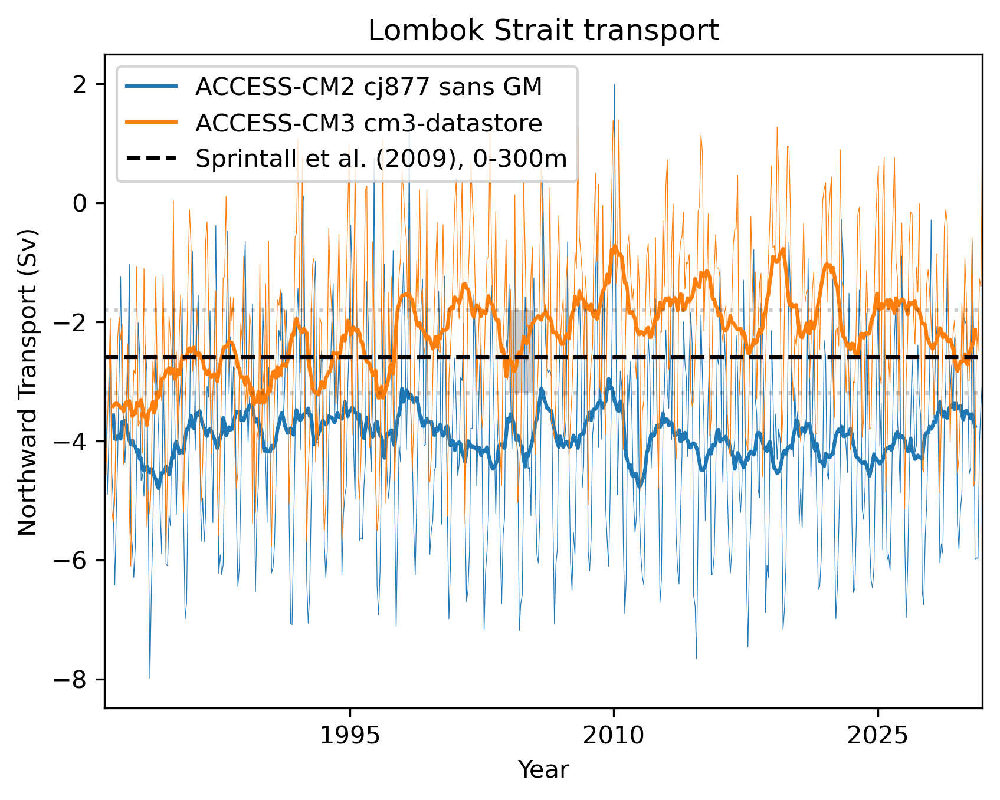

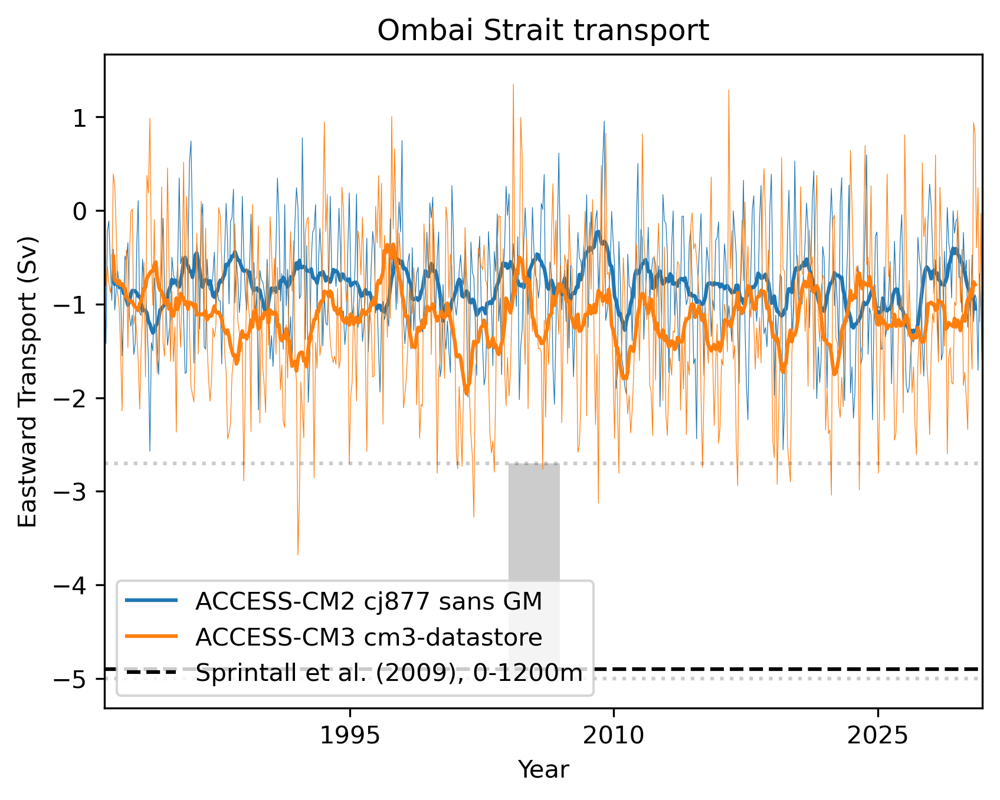

...

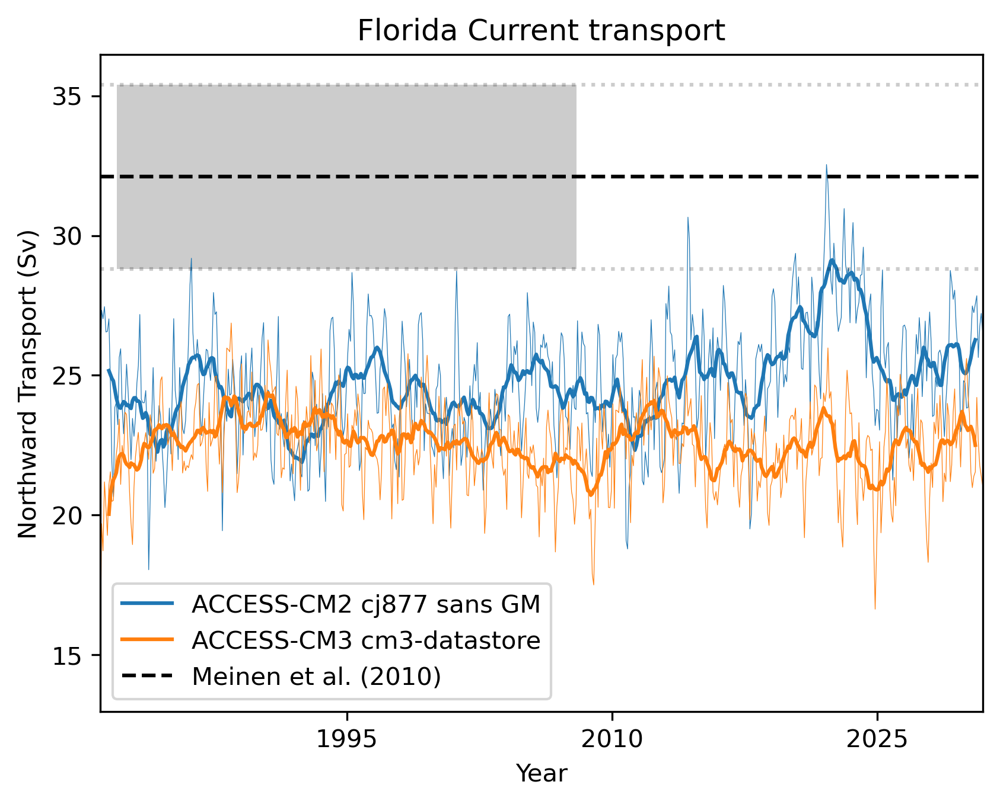

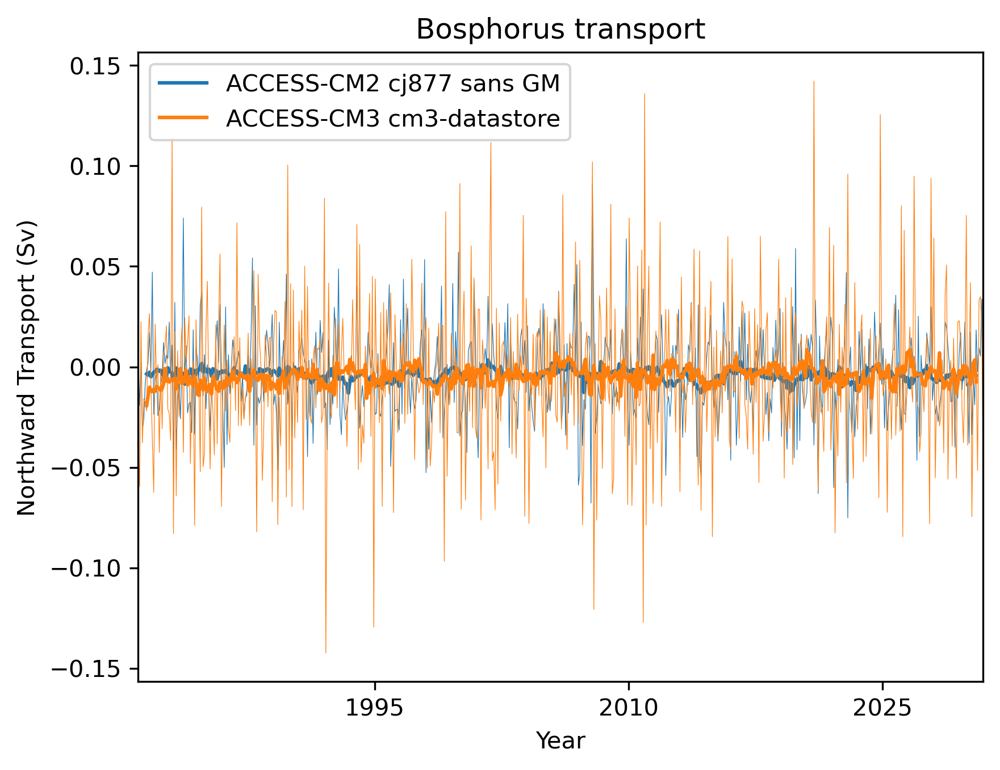

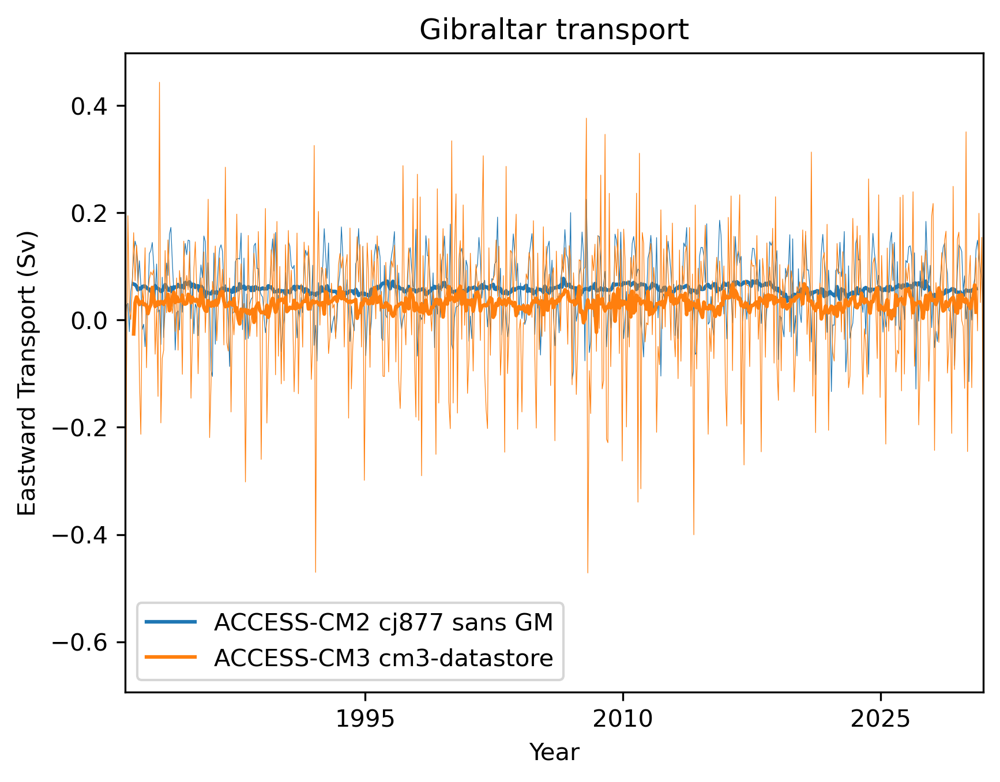

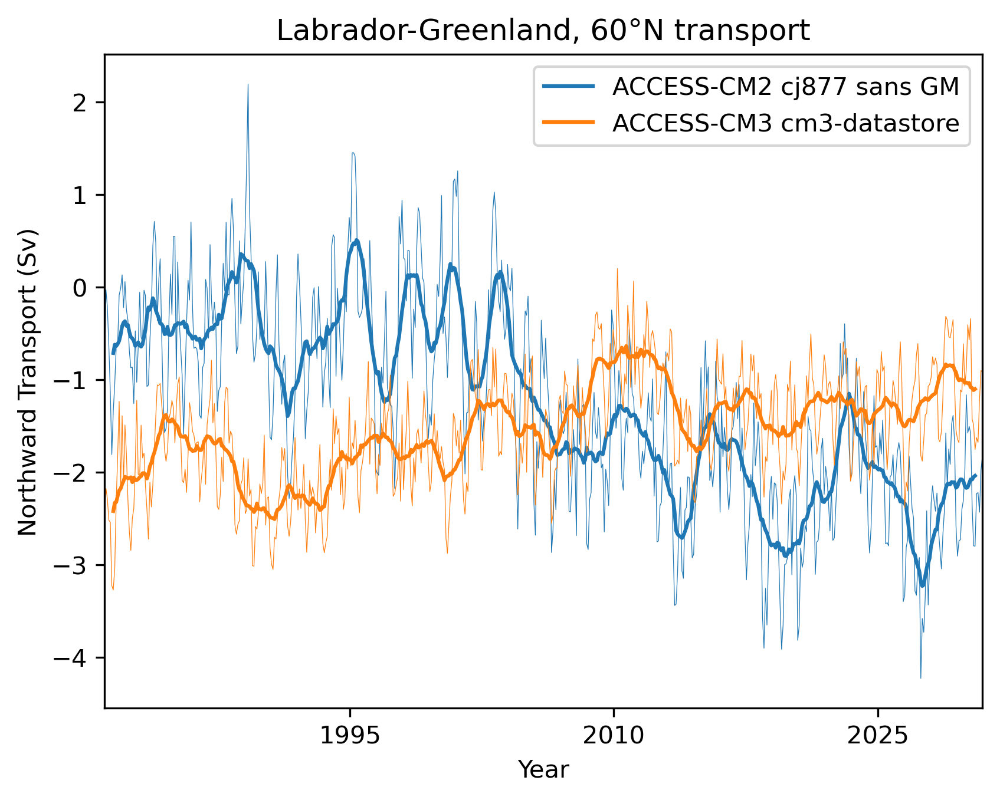

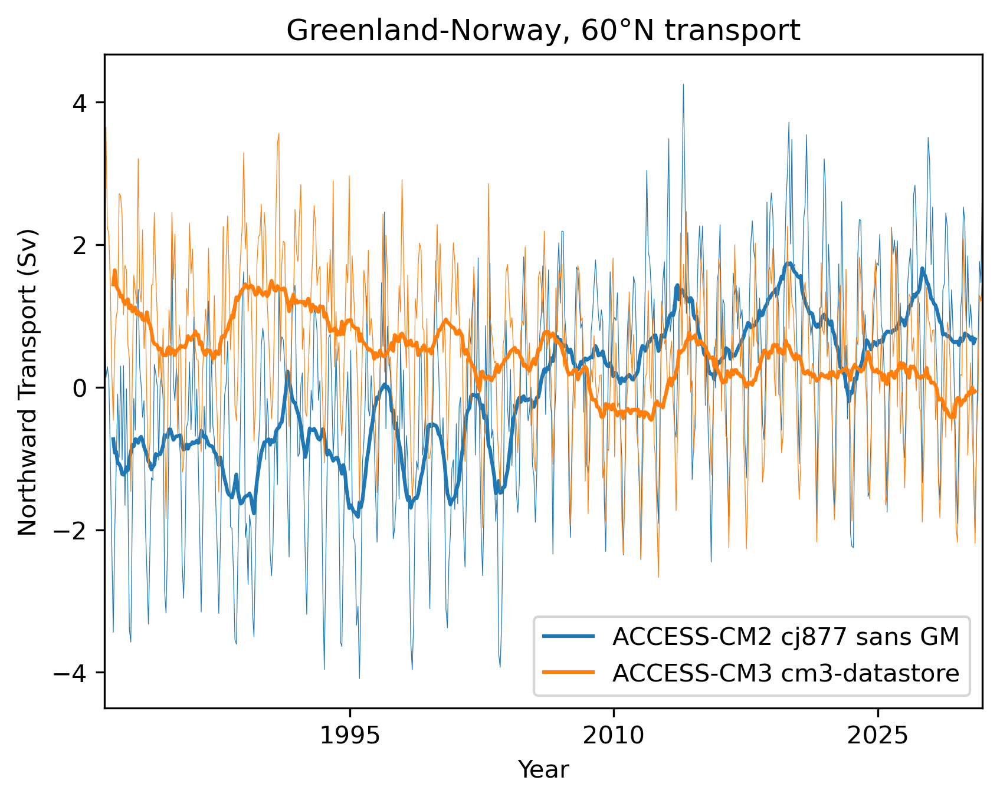

In [50]:
# plot mass transport timeseries (Sv)
# BUG: OM2 GM and submeso transport neglected!
print(f"| Strait | {data_name} | {model_name} | Obs |")
print('| ------ | --: | --: | --: |')

for strait, (xmin, xmax, ymin, ymax) in om3straits['25km'].items():
    plt.figure()

    if strait in om2straits['025deg']:
        (xmin, xmax, ymin, ymax) = om2straits['025deg'][strait]
        if xmin == xmax:
            trans = tx_trans_int_z.sel(xu_ocean=xmin, method='nearest').sel(yt_ocean=slice(ymin, ymax)).sum('yt_ocean')
        elif ymin == ymax:
            trans = ty_trans_int_z.sel(xt_ocean=slice(xmin, xmax)).sel(yu_ocean=ymin, method='nearest').sum('xt_ocean')
        else:
            raise ValueError('Transports are computed only along lines of either constant latitude or longitude')
        trans = trans/1e6/1035  # convert to Sv, rho0 = 1035.0
        # trans = trans.sel(time=timeslice)
        trans.plot(linewidth=0.3)
        trans.rolling(time=12, center=True).mean().plot(label=f"{data_name} {om2exptname} sans GM", linewidth=1.5, color=plt.gca().lines[-1].get_color())
        om2transmeanval = trans.mean('time').values
        om2transmean = f'{om2transmeanval:.2f}'
    else:
        om2transmean = ' -- '

    if xmin == xmax:
        trans = umo_2d.sel(xq=xmin, method='nearest').sel(yh=slice(ymin, ymax)).sum('yh')
        direction = 'Eastward'
    elif ymin == ymax:
        trans = vmo_2d.sel(xh=slice(xmin, xmax)).sel(yq=ymin, method='nearest').sum('xh')
        direction = 'Northward'
    else:
        raise ValueError('Transports are computed only along lines of either constant latitude or longitude')
    trans = trans/1e6/1035  # convert to Sv, RHO_0 = 1035.0
    trans.plot(linewidth=0.3)
    trans = trans.chunk({"time": -1})
    trans.rolling(time=12, center=True).mean().plot(label=f"{model_name} {exptname}", linewidth=1.5, color=plt.gca().lines[-1].get_color())
    transmeanval = trans.mean('time').values
    transmean = f'{transmeanval:.2f}'

    plt.autoscale(enable=True, axis='x', tight=True)

    if strait in obs:
        for ref, d in obs[strait].items():
            # plt.plot([timeslice.start, timeslice.stop], [d, d], 'k--', label=ref)
            if 'depth' in d:
                depths = f", {str(d['depth'][0])}-{str(d['depth'][1])}m"
            else:
                depths = ""
            plt.plot(plt.gca().get_xlim(), [d['value'], d['value']], 'k--', label=f"{ref}{depths}",)
            plt.plot(plt.gca().get_xlim(), [d['hi'], d['hi']], 'k:', alpha=0.2)
            plt.plot(plt.gca().get_xlim(), [d['lo'], d['lo']], 'k:', alpha=0.2)
            plt.gca().fill_between(d['time'],
                                   [d['hi'], d['hi']],
                                   [d['lo'], d['lo']],
                                   color='black', edgecolor=None, alpha=0.2)
            obstransval = d['value']
            obstrans = f'{obstransval:.2f}'
    else:
        obstrans = ' -- '

    plt.title(f"{strait} transport")
    plt.xlabel('Year')
    plt.ylabel(f'{direction} Transport (Sv)')
    plt.legend(fontsize=10)

    # Markdown table
    print(f'| {strait} | {om2transmean} | {transmean} | {obstrans} |')

Lombok Strait
Ombai Strait
Timor Strait
Lombok + Ombai + Timor Strait ACCESS-CM3 = -5.031947612762451 ACCESS-CM2 = -7.835156440734863 Sv Northward


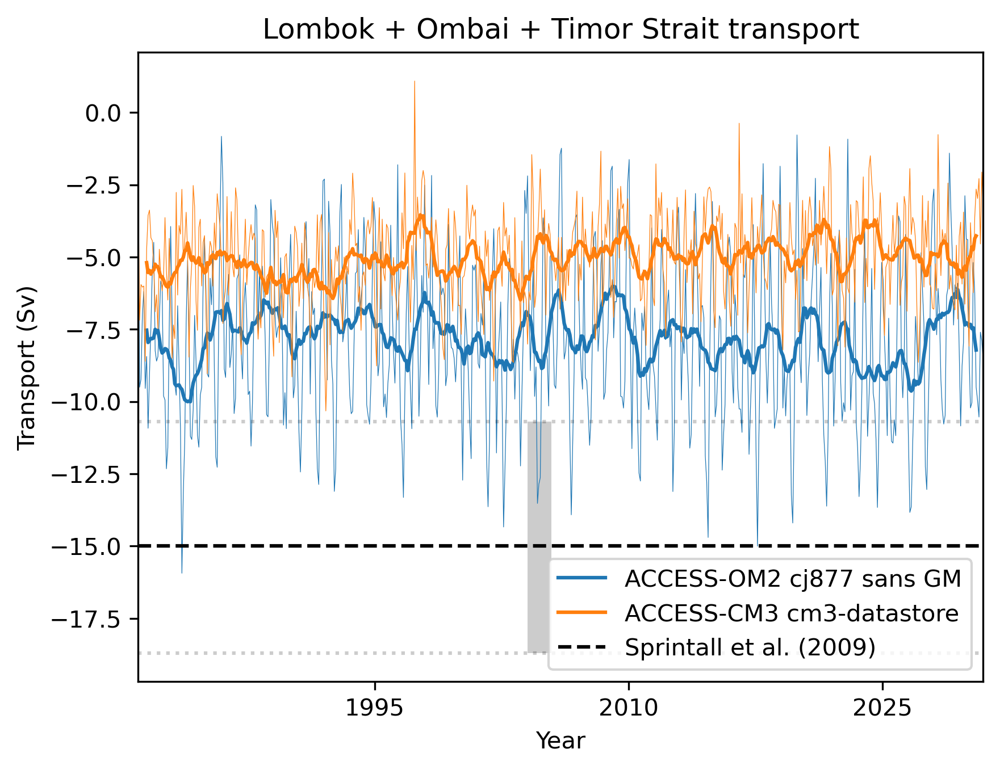

In [53]:
# plot Lombok + Ombai + Timor Strait mass transport timeseries (Sv)
# BUG: OM2 GM and submeso transport neglected!
OM2total = OM3total = 0
for strait, (xmin, xmax, ymin, ymax) in om3straits['25km'].items():
    if strait in [
        'Lombok Strait',
        'Ombai Strait',
        'Timor Strait'
    ]:
        print(strait)
        if strait not in om2straits['025deg']:
            raise KeyError(f"{strait} not in om2straits['025deg']")
        (xmin, xmax, ymin, ymax) = om2straits['025deg'][strait]
        if xmin == xmax:
            trans = tx_trans_int_z.sel(xu_ocean=xmin, method='nearest').sel(yt_ocean=slice(ymin, ymax)).sum('yt_ocean')
        elif ymin == ymax:
            trans = ty_trans_int_z.sel(xt_ocean=slice(xmin, xmax)).sel(yu_ocean=ymin, method='nearest').sum('xt_ocean')
        OM2total += trans/1e6/1035  # convert to Sv, rho0 = 1035.0
            
        if xmin == xmax:
            trans = umo_2d.sel(xq=xmin, method='nearest').sel(yh=slice(ymin, ymax)).sum('yh')
        elif ymin == ymax:
            trans = vmo_2d.sel(xh=slice(xmin, xmax)).sel(yq=ymin, method='nearest').sum('xh')
        OM3total += trans/1e6/1035  # convert to Sv, RHO_0 = 1035.0



plt.figure()

OM2total.plot(linewidth=0.3)
OM2total = OM2total.chunk({"time": -1})
OM2total.rolling(time=12, center=True).mean().plot(label=f"ACCESS-OM2 {om2exptname} sans GM", linewidth=1.5, color=plt.gca().lines[-1].get_color())
om2transmean = OM2total.mean('time').values

OM3total.plot(linewidth=0.3)
OM3total = OM3total.chunk({"time": -1})
OM3total.rolling(time=12, center=True).mean().plot(label=f"{model_name} {exptname}", linewidth=1.5, color=plt.gca().lines[-1].get_color())
transmean = OM3total.mean('time').values

plt.autoscale(enable=True, axis='x', tight=True)

# Plot obs values (Sv) from Sprintall et al 2009 table 1
value = -15.0
hi = -10.7
lo = -18.7
plt.plot(plt.gca().get_xlim(), [value, value], 'k--', label=f"Sprintall et al. (2009)",)
plt.plot(plt.gca().get_xlim(), [hi, hi], 'k:', alpha=0.2)
plt.plot(plt.gca().get_xlim(), [lo, lo], 'k:', alpha=0.2)
plt.gca().fill_between([date(2004, 1, 10), date(2005, 6, 15)], # use Lombok dates (narrowest range)
                       [hi, hi],
                       [lo, lo],
                       color='black', edgecolor=None, alpha=0.2)

plt.title(f"Lombok + Ombai + Timor Strait transport")
plt.xlabel('Year')
plt.ylabel(f'Transport (Sv)')
plt.legend(fontsize=10)
if strait in om2straits['025deg']:
    print(f"Lombok + Ombai + Timor Strait {model_name} = {transmean} "f"{data_name} = {om2transmean} Sv {direction}")
else:
    print(f"Lombok + Ombai + Timor Strait {model_name} = {transmean} Sv {direction}")

Makassar Strait
Lifamatola Passage
Makassar Strait + Lifamatola Passage ACCESS-CM3 = -10.259298324584961 ACCESS-CM2 = -11.134934425354004 Sv Northward


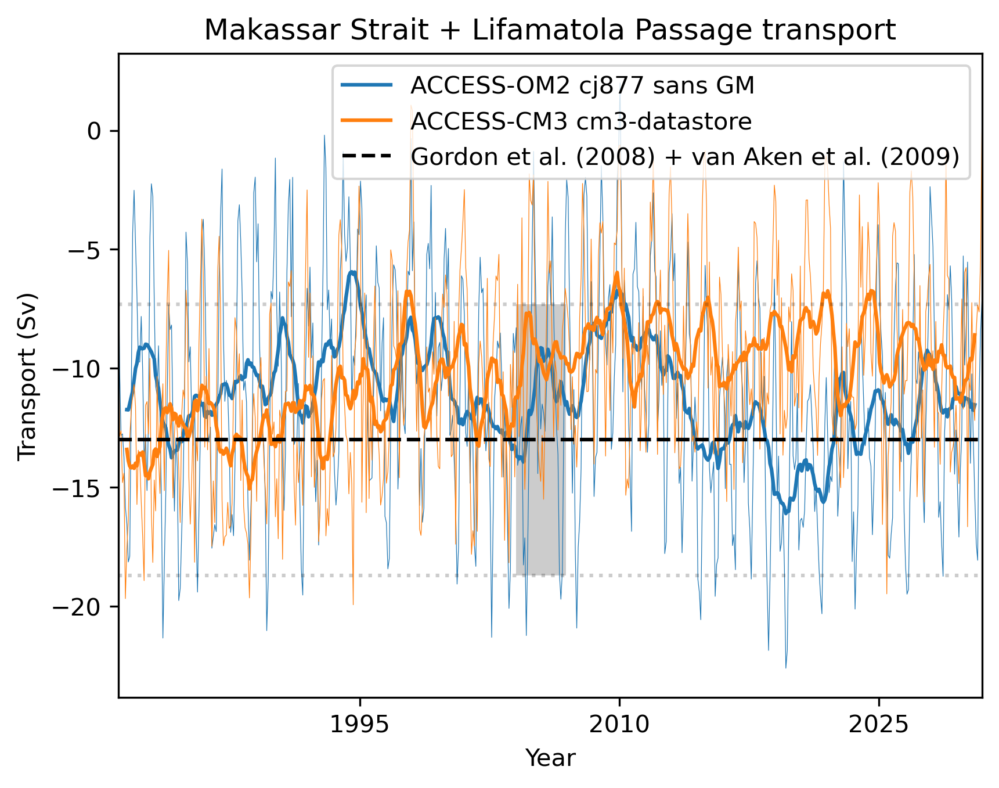

In [54]:
# plot Makassar Strait + Lifamatola Passage mass transport timeseries (Sv)
# BUG: OM2 GM and submeso transport neglected!
OM2total = OM3total = 0
for strait, (xmin, xmax, ymin, ymax) in om3straits['25km'].items():
    if strait in [
        'Makassar Strait',
        'Lifamatola Passage'
    ]:
        print(strait)
        if strait not in om2straits['025deg']:
            raise KeyError(f"{strait} not in om2straits['025deg']")
        (xmin, xmax, ymin, ymax) = om2straits['025deg'][strait]
        if xmin == xmax:
            trans = tx_trans_int_z.sel(xu_ocean=xmin, method='nearest').sel(yt_ocean=slice(ymin, ymax)).sum('yt_ocean')
        elif ymin == ymax:
            trans = ty_trans_int_z.sel(xt_ocean=slice(xmin, xmax)).sel(yu_ocean=ymin, method='nearest').sum('xt_ocean')
        OM2total += trans/1e6/1035  # convert to Sv, rho0 = 1035.0
            
        if xmin == xmax:
            trans = umo_2d.sel(xq=xmin, method='nearest').sel(yh=slice(ymin, ymax)).sum('yh')
        elif ymin == ymax:
            trans = vmo_2d.sel(xh=slice(xmin, xmax)).sel(yq=ymin, method='nearest').sum('xh')
        OM3total += trans/1e6/1035  # convert to Sv, RHO_0 = 1035.0



plt.figure()

OM2total.plot(linewidth=0.3)
OM2total = OM2total.chunk({"time": -1})
OM2total.rolling(time=12, center=True).mean().plot(label=f"ACCESS-OM2 {om2exptname} sans GM", linewidth=1.5, color=plt.gca().lines[-1].get_color())
om2transmean = OM2total.mean('time').values

OM3total.plot(linewidth=0.3)
OM3total = OM3total.chunk({"time": -1})
OM3total.rolling(time=12, center=True).mean().plot(label=f"{model_name} {exptname}", linewidth=1.5, color=plt.gca().lines[-1].get_color())
transmean = OM3total.mean('time').values

plt.autoscale(enable=True, axis='x', tight=True)

# Plot obs values (Sv) from Gordon et al. (2008) + van Aken et al. (2009)
value = obs['Makassar Strait']['Gordon et al. (2008)']['value'] + obs['Lifamatola Passage']['van Aken et al. (2009)']['value']
hi =    obs['Makassar Strait']['Gordon et al. (2008)']['hi']    + obs['Lifamatola Passage']['van Aken et al. (2009)']['hi']
lo =    obs['Makassar Strait']['Gordon et al. (2008)']['lo']    + obs['Lifamatola Passage']['van Aken et al. (2009)']['lo']
plt.plot(plt.gca().get_xlim(), [value, value], 'k--', label=f"Gordon et al. (2008) + van Aken et al. (2009)")
plt.plot(plt.gca().get_xlim(), [hi, hi], 'k:', alpha=0.2)
plt.plot(plt.gca().get_xlim(), [lo, lo], 'k:', alpha=0.2)
plt.gca().fill_between(obs['Makassar Strait']['Gordon et al. (2008)']['time'], # use Makassar dates (narrowest range)
                       [hi, hi],
                       [lo, lo],
                       color='black', edgecolor=None, alpha=0.2)

plt.title(f"Makassar Strait + Lifamatola Passage transport")
plt.xlabel('Year')
plt.ylabel(f'Transport (Sv)')
plt.legend(fontsize=10)
if strait in om2straits['025deg']:
    print(f"Makassar Strait + Lifamatola Passage "
          f"{model_name} = {transmean} "
          f"{data_name} = {om2transmean} Sv {direction}")
else:
    print(f"Makassar Strait + Lifamatola Passage "
          f"{model_name} = {transmean} Sv {direction}")

In [ ]:
client.close()